In [29]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils import data
import torchvision
from torchvision import transforms

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import os
import glob 
from PIL import Image

In [3]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim
from skimage.measure import shannon_entropy

In [4]:
torch.__version__

'1.13.1+cu117'

In [5]:
#获取测试数据路径
# train_irimgs_path = glob.glob('data/MSRS-main/train/ir/*.png')
# train_viimgs_path = glob.glob('data/MSRS-main/train/vi/*.png')
train_irimgs_path = glob.glob('data/TNO/ir/*.png')
train_viimgs_path = glob.glob('data/TNO/vi/*.png')

#获取测试数据路径
test_irimgs_path = glob.glob('data/MSRS-main/test/ir/*.png')
test_viimgs_path = glob.glob('data/MSRS-main/test/vi/*.png')

In [6]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((512,512)),
    transforms.Normalize(mean=0.5,std=0.5)
])

In [7]:
vi_img = Image.open(train_viimgs_path[1])
ir_img = Image.open(train_irimgs_path[1])
ir_img = ir_img.convert('RGB')

In [8]:
np.array(ir_img).shape,np.array(vi_img).shape

((576, 768, 3), (576, 768, 3))

In [9]:
class FusionDataset(data.Dataset):
    def __init__(self,ir_path,vi_path):
        self.ir_path = train_irimgs_path
        self.vi_path = train_viimgs_path
    def __getitem__(self,idx):
        # 得到路径
        vi_path = self.vi_path[idx]
        ir_path = self.ir_path[idx]
        # 根据路径得到图片
        vi_img = Image.open(vi_path)
        ir_img = Image.open(ir_path) #ir红外读取为灰度秃了
        # vi_img = vi_img.convert('RGB')
        vi_img = transform(vi_img)
        ir_img = ir_img.convert('RGB')# 将灰度图转换为三通道再变化
        ir_img = transform(ir_img)
        return vi_img,ir_img
    def __len__(self):
        return len(self.ir_path)
        

In [10]:
train_ds = FusionDataset(train_irimgs_path,train_viimgs_path)
test_ds = FusionDataset(test_irimgs_path,test_viimgs_path)

In [11]:
BATCHSIZE = 128
train_dl = data.DataLoader(dataset=train_ds,
                          batch_size=BATCHSIZE,
                          shuffle=True)

test_dl = data.DataLoader(dataset=test_ds,
                          batch_size=BATCHSIZE,
                          shuffle=False)

In [12]:
ir_batch,vi_batch = next(iter(train_dl))

In [13]:
ir_batch.shape,vi_batch.shape

(torch.Size([42, 3, 512, 512]), torch.Size([42, 3, 512, 512]))

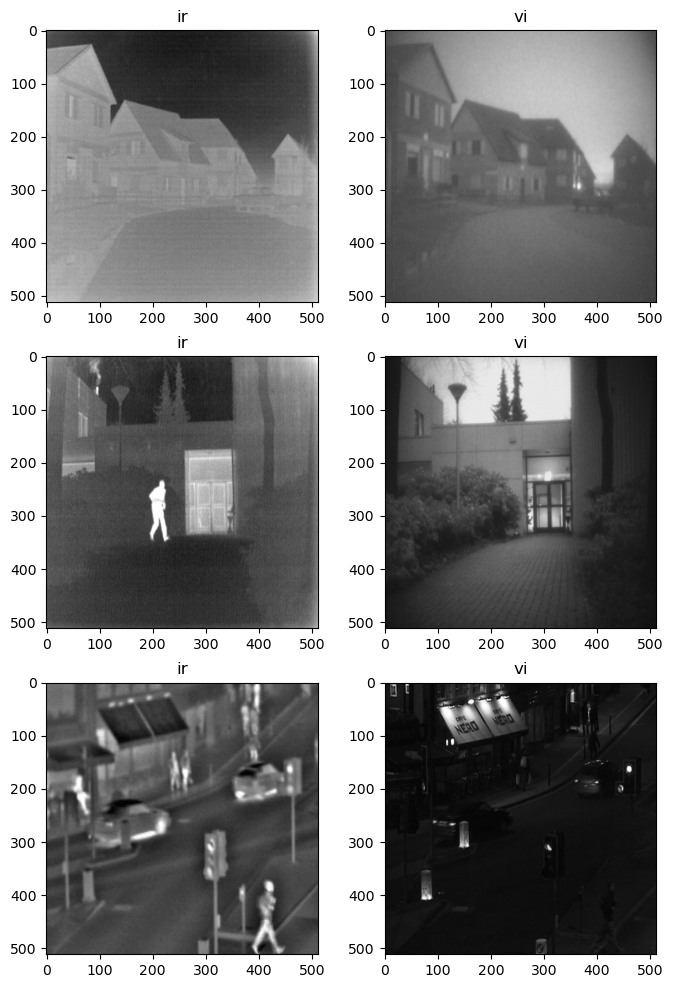

In [14]:
plt.figure(figsize = (8,12))
for i,(vi,ir) in enumerate(zip(ir_batch[:3],vi_batch[:3])):
    ir = (ir.permute(1,2,0).numpy()+1)/2
    vi = (vi.permute(1,2,0).numpy()+1)/2
    plt.subplot(3,2,2*i+1)
    plt.title('ir')
    plt.imshow(ir)
    plt.subplot(3,2,2*i+2)
    plt.title('vi')
    plt.imshow(vi)

In [15]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        # Define the encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(6, 64, 3, stride=2, padding=1),
            nn.ReLU(True),
            nn.Conv2d(64, 128, 3, stride=2, padding=1),
            nn.ReLU(True),
            nn.Conv2d(128, 256, 3, stride=2, padding=1),
            nn.ReLU(True),
            nn.Conv2d(256, 512, 3, stride=2, padding=1),
            nn.ReLU(True),
            nn.Conv2d(512, 1024, 3, stride=2, padding=1),
            nn.ReLU(True),
        )
        # Define the decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(1024, 512, 4, stride=2, padding=1),
            nn.ReLU(True),
            nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 3, 4, stride=2, padding=1),
            nn.Tanh(),
        )
    def forward(self, x):
        # print(f'初始图像：{x.shape}')
        x = self.encoder(x)
        # print(f'编码器图像：{x.shape}')
        x = self.decoder(x)
        # print(f'解码器图像：{x.shape}')
        return x

In [16]:
#定义下采样模块
class Downsample(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(Downsample,self).__init__()
        self.conv_relu = nn.Sequential(
            nn.Conv2d(in_channels,out_channels,
                     kernel_size=3,
                     stride = 2,
                     padding=1),
            nn.LeakyReLU(inplace=True)
        )
        self.bn = nn.BatchNorm2d(out_channels)
    def forward(self,x,is_bn=True):
    # 生成器的输出层和判别器的输入层不使用BN
        x = self.conv_relu(x)
        if is_bn:
            x = self.bn(x)
        return x

In [17]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator,self).__init__()
        self.main = Autoencoder()
    def forward(self,x1,x2):
        x = torch.cat([x1,x2],axis = 1)
        x = self.main(x)
        return x

In [18]:
# class Discriminator(nn.Module):
#     # ir + vi concat
#     def __init__(self):
#         super(Discriminator,self).__init__()
#         self.down1 = Downsample(3,64)
#         self.down2 = Downsample(64,128)

        
#         self.conv1 = nn.Conv2d(128,256,3)
#         self.bn1 = nn.InstanceNorm2d(256)
#         self.conv2 = nn.Conv2d(256,512,3)
#         self.bn2 = nn.InstanceNorm2d(512)
#         self.conv3 = nn.Conv2d(512,1024,3)
#         self.bn3 = nn.InstanceNorm2d(1024)
        
#         self.last = nn.Conv2d(1024,1,3)
        
#     def forward(self,ir,vi):
#         # x = torch.cat([ir,vi],axis = 1)
#         x = vi
#         x = self.down1(x,is_bn=False)
#         x = self.down2(x,is_bn=False)
        
#         x = self.conv1(x)
#         x = F.leaky_relu(x)
#         x = self.bn1(x)
#         x = F.dropout2d(x)

#         x = self.conv2(x)
#         x = F.leaky_relu(x)
#         x = self.bn2(x)
#         x = F.dropout2d(x)
        
#         x = self.conv3(x)
#         x = F.leaky_relu(x)
#         x = self.bn3(x)
#         x = F.dropout2d(x)

#         x = self.last(x)
#         x = torch.sigmoid(x)
#         return x
class Discriminator(nn.Module):
    # ir + vi concat
    def __init__(self):
        super(Discriminator,self).__init__()
        self.down1 = Downsample(3,64)
        self.down2 = Downsample(64,128)
        self.conv1 = nn.Conv2d(128,256,3)
        self.bn = nn.BatchNorm2d(256)
        self.last = nn.Conv2d(256,1,3)
    def forward(self,ir,vi):
        # x = torch.cat([ir,vi],axis = 1)
        # x = ir*0.5 + vi*0.5
        x = vi
        x = self.down1(x,is_bn=False)
        x = self.down2(x,is_bn=False)
        x = F.dropout2d(self.bn(F.leaky_relu(self.conv1(x))))
        x = torch .sigmoid(self.last(x))
        return x

In [19]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [20]:
gen = Generator().to(device)
dis = Discriminator().to(device)

gen = nn.DataParallel(gen)  # 就在这里wrap一下，模型就会使用所有的GPU
dis = nn.DataParallel(dis)  # 就在这里wrap一下，模型就会使用所有的GPU

In [21]:
d_optimizer = torch.optim.Adam(dis.parameters(),lr = 1e-4,betas=(0.5,0.999))
g_optimizer = torch.optim.Adam(gen.parameters(),lr = 1e-4,betas=(0.5,0.999))

In [22]:
# 定义损失函数
loss_fn = torch.nn.BCELoss()
# L1

In [23]:
LAMDA = 7

In [24]:
def calculate_metrics(vi, ir,fusion):
    # Information Entropy (EN)
    def calculate_entropy(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        entropy_value = shannon_entropy(img_gray)
        return entropy_value

    # Standard Deviation (SD)
    def calculate_sd(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        sd_value = np.std(img_gray)
        return sd_value

    # Structural Similarity Index (SSIM)
    def calculate_ssim(vi, ir ,fusion):
        img1_gray = cv2.cvtColor(vi, cv2.COLOR_BGR2GRAY)
        img2_gray = cv2.cvtColor(ir, cv2.COLOR_BGR2GRAY)
        fusion_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        ssim_index_A, _ = ssim(img1_gray, fusion_gray, full=True)
        ssim_index_B, _ = ssim(img2_gray, fusion_gray, full=True)
        return (ssim_index_A + ssim_index_B)/2 

    

    # Correlation Coefficient (CC)
    def calculate_cc(vi, ir ,fusion):
        img1_flat = vi.flatten()
        img2_flat = ir.flatten()
        fusion_flat = fusion.flatten()
        
        correlation_coefficient_A = np.corrcoef(img1_flat, fusion_flat)[0, 1]
        correlation_coefficient_B = np.corrcoef(img2_flat, fusion_flat)[0, 1]
        
        return (correlation_coefficient_A + correlation_coefficient_B)/2

    # Spatial Frequency (SF)
    def calculate_sf(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        f = np.fft.fft2(img_gray)
        fshift = np.fft.fftshift(f)
        magnitude_spectrum = 20 * np.log(np.abs(fshift))
        spatial_frequency = np.sum(magnitude_spectrum) / img_gray.size
        return spatial_frequency

    # Variable Luminance Fusion Index (VLF)
    def calculate_vlf(vi, ir ,fusion):
        img1_gray = cv2.cvtColor(vi, cv2.COLOR_BGR2GRAY)
        img2_gray = cv2.cvtColor(ir, cv2.COLOR_BGR2GRAY)
        fusion_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        
        vlf_value_A = np.sum(np.abs(img1_gray - fusion_gray)) / img1_gray.size
        vlf_value_B = np.sum(np.abs(img2_gray - fusion_gray)) / img2_gray.size
        
        return (vlf_value_A + vlf_value_B)/2

    # Calculate metrics
    entropy_value = calculate_entropy(fusion)
    sd_value = calculate_sd(fusion)
    ssim_value = calculate_ssim(vi, ir,fusion)
    cc_value = calculate_cc(vi, ir,fusion)
    sf_value = calculate_sf(fusion)
    vlf_value = calculate_vlf(vi, ir,fusion)
    return {
        'Entropy': entropy_value,
        'Standard Deviation': sd_value,
        'SSIM': ssim_value,
        'Correlation Coefficient': cc_value,
        'Spatial Frequency': sf_value,
        'Variable Luminance Fusion Index': vlf_value
    }

In [31]:
def genarate_images(model,ir,vi):
    prediction = model(vi,ir).permute(0,2,3,1).detach().cpu().numpy()
    ir = ir.permute(0,2,3,1).cpu().numpy()
    vi = vi.permute(0,2,3,1).cpu().numpy()
    plt.figure(figsize=(10,10))
    display_list = [ir[0],vi[0],prediction[0]]
    fusion_result = calculate_metrics(vi[0], ir[0],prediction[0])

    print(fusion_result)
    title = ['ir','vi','fusion']
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(title[i])
        plt.imshow(display_list[i]*0.5+0.5)
        plt.axis('off')
    plt.show()
    return fusion_result

In [32]:
# from utils.eval_multi_method

Epoch: 0 {'Entropy': 17.77953132842223, 'Standard Deviation': 0.012016551, 'SSIM': 0.05431290896198379, 'Correlation Coefficient': -0.0022327167846098346, 'Spatial Frequency': -84.35319811291491, 'Variable Luminance Fusion Index': 0.3987727463245392}


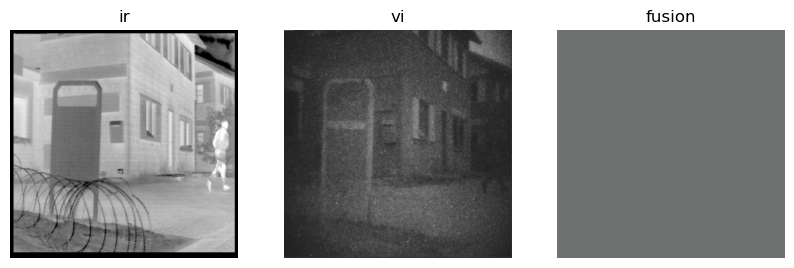

D_epoch_loss:1.4490647315979004,G_epoch_loss:2.286257266998291
Epoch: 1 D_epoch_loss:1.3835175037384033,G_epoch_loss:2.2883894443511963
Epoch: 2 D_epoch_loss:1.414520025253296,G_epoch_loss:2.2897329330444336
Epoch: 3 D_epoch_loss:1.4130604267120361,G_epoch_loss:2.289973020553589
Epoch: 4 D_epoch_loss:1.4321506023406982,G_epoch_loss:2.2872135639190674
Epoch: 5 D_epoch_loss:1.3780179023742676,G_epoch_loss:2.274019241333008
Epoch: 6 D_epoch_loss:1.4151467084884644,G_epoch_loss:2.233877420425415
Epoch: 7 D_epoch_loss:1.4336764812469482,G_epoch_loss:2.131309986114502
Epoch: 8 D_epoch_loss:1.4150680303573608,G_epoch_loss:2.000457763671875
Epoch: 9 D_epoch_loss:1.4327733516693115,G_epoch_loss:2.056075096130371
Epoch: 10 D_epoch_loss:1.4643739461898804,G_epoch_loss:1.920987606048584
Epoch: 11 D_epoch_loss:1.4262886047363281,G_epoch_loss:1.879469871520996
Epoch: 12 D_epoch_loss:1.4435863494873047,G_epoch_loss:1.857203483581543
Epoch: 13 D_epoch_loss:1.4382169246673584,G_epoch_loss:1.80563426017

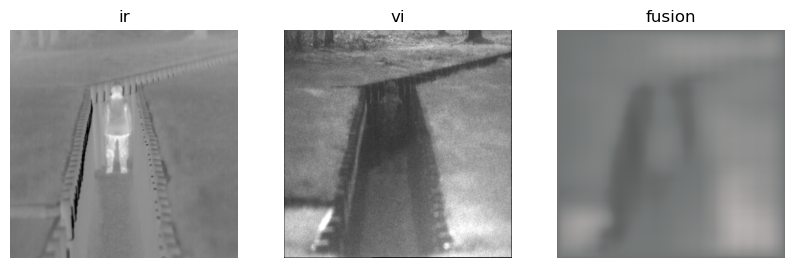

D_epoch_loss:1.4233884811401367,G_epoch_loss:1.2707264423370361
Epoch: 48 D_epoch_loss:1.4025784730911255,G_epoch_loss:1.2433443069458008
Epoch: 49 D_epoch_loss:1.4337618350982666,G_epoch_loss:1.2409260272979736
Epoch: 50 D_epoch_loss:1.3726269006729126,G_epoch_loss:1.3902544975280762
Epoch: 51 D_epoch_loss:1.373500108718872,G_epoch_loss:1.3457801342010498
Epoch: 52 D_epoch_loss:1.3892731666564941,G_epoch_loss:1.3059028387069702
Epoch: 53 D_epoch_loss:1.3518633842468262,G_epoch_loss:1.215182900428772
Epoch: 54 D_epoch_loss:1.3327877521514893,G_epoch_loss:1.2153651714324951
Epoch: 55 D_epoch_loss:1.3642876148223877,G_epoch_loss:1.2503488063812256
Epoch: 56 D_epoch_loss:1.349299430847168,G_epoch_loss:1.2435129880905151
Epoch: 57 D_epoch_loss:1.3919434547424316,G_epoch_loss:1.2303767204284668
Epoch: 58 D_epoch_loss:1.366929292678833,G_epoch_loss:1.2882773876190186
Epoch: 59 D_epoch_loss:1.3503090143203735,G_epoch_loss:1.2834205627441406
Epoch: 60 D_epoch_loss:1.4149644374847412,G_epoch_lo

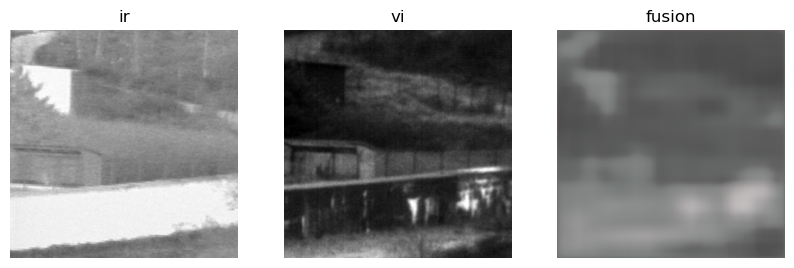

D_epoch_loss:1.342022180557251,G_epoch_loss:1.2228577136993408
Epoch: 95 D_epoch_loss:1.3544796705245972,G_epoch_loss:1.1758036613464355
Epoch: 96 D_epoch_loss:1.3347755670547485,G_epoch_loss:1.1876420974731445
Epoch: 97 D_epoch_loss:1.30946683883667,G_epoch_loss:1.177812099456787
Epoch: 98 D_epoch_loss:1.3458712100982666,G_epoch_loss:1.2596075534820557
Epoch: 99 D_epoch_loss:1.3228371143341064,G_epoch_loss:1.2364001274108887
Epoch: 100 D_epoch_loss:1.3474994897842407,G_epoch_loss:1.2337760925292969
Epoch: 101 D_epoch_loss:1.3278545141220093,G_epoch_loss:1.1482021808624268
Epoch: 102 D_epoch_loss:1.345139503479004,G_epoch_loss:1.1549789905548096
Epoch: 103 D_epoch_loss:1.3318148851394653,G_epoch_loss:1.1488077640533447
Epoch: 104 D_epoch_loss:1.3686034679412842,G_epoch_loss:1.1480833292007446
Epoch: 105 D_epoch_loss:1.345044493675232,G_epoch_loss:1.1919338703155518
Epoch: 106 D_epoch_loss:1.3258097171783447,G_epoch_loss:1.2052115201950073
Epoch: 107 D_epoch_loss:1.335988998413086,G_epo

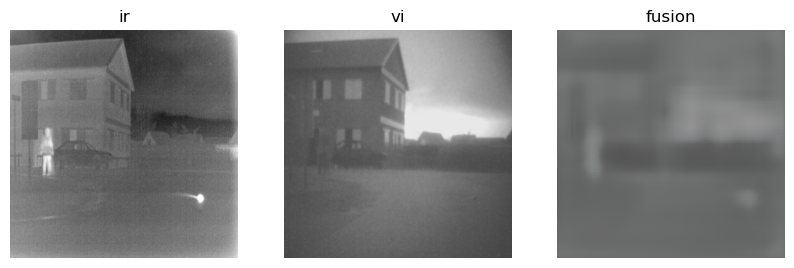

D_epoch_loss:1.3605200052261353,G_epoch_loss:1.1784038543701172
Epoch: 142 D_epoch_loss:1.336066484451294,G_epoch_loss:1.143288254737854
Epoch: 143 D_epoch_loss:1.3726685047149658,G_epoch_loss:1.1513795852661133
Epoch: 144 D_epoch_loss:1.360457181930542,G_epoch_loss:1.1723153591156006
Epoch: 145 D_epoch_loss:1.3567578792572021,G_epoch_loss:1.1535546779632568
Epoch: 146 D_epoch_loss:1.3697333335876465,G_epoch_loss:1.176294207572937
Epoch: 147 D_epoch_loss:1.3924598693847656,G_epoch_loss:1.131474494934082
Epoch: 148 D_epoch_loss:1.3872448205947876,G_epoch_loss:1.1521315574645996
Epoch: 149 D_epoch_loss:1.337047815322876,G_epoch_loss:1.1757993698120117
Epoch: 150 D_epoch_loss:1.3597147464752197,G_epoch_loss:1.1379598379135132
Epoch: 151 D_epoch_loss:1.382030725479126,G_epoch_loss:1.1458598375320435
Epoch: 152 D_epoch_loss:1.3907394409179688,G_epoch_loss:1.13853120803833
Epoch: 153 D_epoch_loss:1.3603529930114746,G_epoch_loss:1.1462064981460571
Epoch: 154 D_epoch_loss:1.3792797327041626,G_

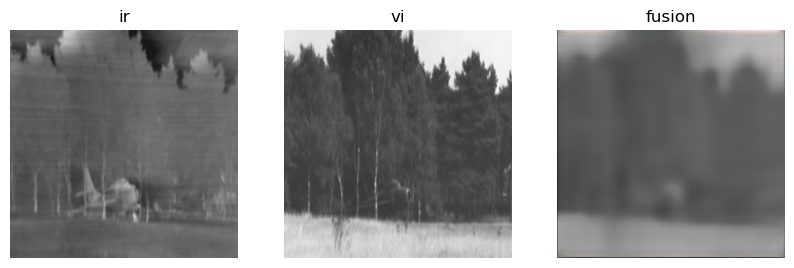

D_epoch_loss:1.3479647636413574,G_epoch_loss:1.1409592628479004
Epoch: 189 D_epoch_loss:1.3535395860671997,G_epoch_loss:1.142630934715271
Epoch: 190 D_epoch_loss:1.3523789644241333,G_epoch_loss:1.1459779739379883
Epoch: 191 D_epoch_loss:1.3552945852279663,G_epoch_loss:1.1446658372879028
Epoch: 192 D_epoch_loss:1.335214376449585,G_epoch_loss:1.1487207412719727
Epoch: 193 D_epoch_loss:1.3507885932922363,G_epoch_loss:1.1367143392562866
Epoch: 194 D_epoch_loss:1.3452726602554321,G_epoch_loss:1.148726463317871
Epoch: 195 D_epoch_loss:1.3538748025894165,G_epoch_loss:1.1517566442489624
Epoch: 196 D_epoch_loss:1.3568005561828613,G_epoch_loss:1.152356743812561
Epoch: 197 D_epoch_loss:1.3646305799484253,G_epoch_loss:1.1341869831085205
Epoch: 198 D_epoch_loss:1.3683383464813232,G_epoch_loss:1.1551235914230347
Epoch: 199 D_epoch_loss:1.3589897155761719,G_epoch_loss:1.156329870223999
Epoch: 200 D_epoch_loss:1.3393299579620361,G_epoch_loss:1.138393521308899
Epoch: 201 D_epoch_loss:1.3519070148468018

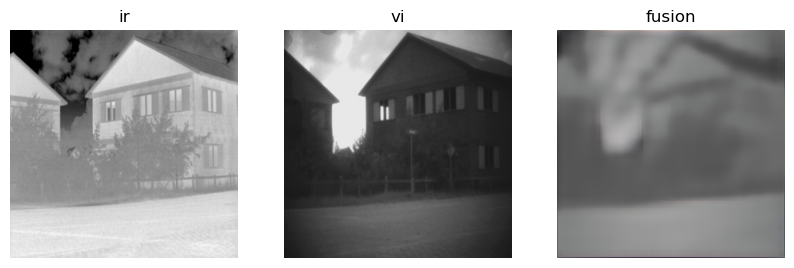

D_epoch_loss:1.3470053672790527,G_epoch_loss:1.1447129249572754
Epoch: 236 D_epoch_loss:1.339829921722412,G_epoch_loss:1.1254768371582031
Epoch: 237 D_epoch_loss:1.3652008771896362,G_epoch_loss:1.1547033786773682
Epoch: 238 D_epoch_loss:1.3496310710906982,G_epoch_loss:1.1398816108703613
Epoch: 239 D_epoch_loss:1.3535596132278442,G_epoch_loss:1.1434097290039062
Epoch: 240 D_epoch_loss:1.3744533061981201,G_epoch_loss:1.139121174812317
Epoch: 241 D_epoch_loss:1.3571796417236328,G_epoch_loss:1.141023874282837
Epoch: 242 D_epoch_loss:1.3436200618743896,G_epoch_loss:1.1384214162826538
Epoch: 243 D_epoch_loss:1.3401970863342285,G_epoch_loss:1.1338764429092407
Epoch: 244 D_epoch_loss:1.3633253574371338,G_epoch_loss:1.1273465156555176
Epoch: 245 D_epoch_loss:1.3619718551635742,G_epoch_loss:1.1317267417907715
Epoch: 246 D_epoch_loss:1.341557264328003,G_epoch_loss:1.1230285167694092
Epoch: 247 D_epoch_loss:1.345940351486206,G_epoch_loss:1.1312997341156006
Epoch: 248 D_epoch_loss:1.333848714828491

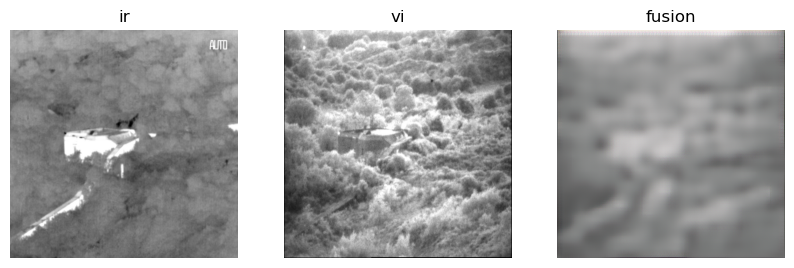

D_epoch_loss:1.3464808464050293,G_epoch_loss:1.132694125175476
Epoch: 283 D_epoch_loss:1.3424385786056519,G_epoch_loss:1.1317427158355713
Epoch: 284 D_epoch_loss:1.3451896905899048,G_epoch_loss:1.1284593343734741
Epoch: 285 D_epoch_loss:1.3277747631072998,G_epoch_loss:1.1186541318893433
Epoch: 286 D_epoch_loss:1.349872350692749,G_epoch_loss:1.1273162364959717
Epoch: 287 D_epoch_loss:1.3515539169311523,G_epoch_loss:1.136855959892273
Epoch: 288 D_epoch_loss:1.3574721813201904,G_epoch_loss:1.122363805770874
Epoch: 289 D_epoch_loss:1.329071044921875,G_epoch_loss:1.1283727884292603
Epoch: 290 D_epoch_loss:1.3342432975769043,G_epoch_loss:1.1362521648406982
Epoch: 291 D_epoch_loss:1.3237366676330566,G_epoch_loss:1.1431076526641846
Epoch: 292 D_epoch_loss:1.354689121246338,G_epoch_loss:1.151763916015625
Epoch: 293 D_epoch_loss:1.3363416194915771,G_epoch_loss:1.1598682403564453
Epoch: 294 D_epoch_loss:1.3346246480941772,G_epoch_loss:1.142014741897583
Epoch: 295 D_epoch_loss:1.3475136756896973,G

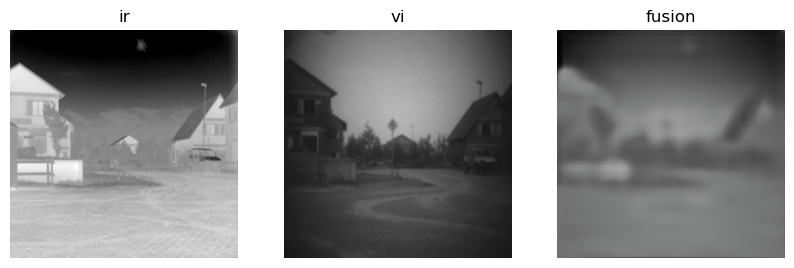

D_epoch_loss:1.3277727365493774,G_epoch_loss:1.1346065998077393
Epoch: 330 D_epoch_loss:1.3293046951293945,G_epoch_loss:1.1446985006332397
Epoch: 331 D_epoch_loss:1.3275359869003296,G_epoch_loss:1.139866590499878
Epoch: 332 D_epoch_loss:1.3300566673278809,G_epoch_loss:1.1493196487426758
Epoch: 333 D_epoch_loss:1.3154661655426025,G_epoch_loss:1.1552950143814087
Epoch: 334 D_epoch_loss:1.3316583633422852,G_epoch_loss:1.1596858501434326
Epoch: 335 D_epoch_loss:1.3333743810653687,G_epoch_loss:1.1559245586395264
Epoch: 336 D_epoch_loss:1.3051717281341553,G_epoch_loss:1.1347862482070923
Epoch: 337 D_epoch_loss:1.3247724771499634,G_epoch_loss:1.1608495712280273
Epoch: 338 D_epoch_loss:1.312185287475586,G_epoch_loss:1.1554036140441895
Epoch: 339 D_epoch_loss:1.3220038414001465,G_epoch_loss:1.1512112617492676
Epoch: 340 D_epoch_loss:1.3243485689163208,G_epoch_loss:1.1416237354278564
Epoch: 341 D_epoch_loss:1.3257124423980713,G_epoch_loss:1.1693744659423828
Epoch: 342 D_epoch_loss:1.315653324127

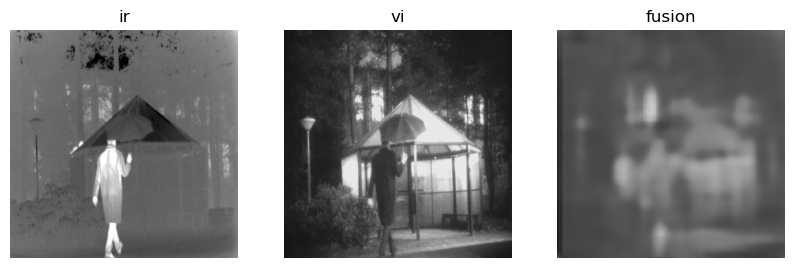

D_epoch_loss:1.3044160604476929,G_epoch_loss:1.1454455852508545
Epoch: 377 D_epoch_loss:1.292022466659546,G_epoch_loss:1.1569907665252686
Epoch: 378 D_epoch_loss:1.3091585636138916,G_epoch_loss:1.1625721454620361
Epoch: 379 D_epoch_loss:1.2850744724273682,G_epoch_loss:1.1354261636734009
Epoch: 380 D_epoch_loss:1.315659999847412,G_epoch_loss:1.1392951011657715
Epoch: 381 D_epoch_loss:1.3358887434005737,G_epoch_loss:1.145592212677002
Epoch: 382 D_epoch_loss:1.3006681203842163,G_epoch_loss:1.1448862552642822
Epoch: 383 D_epoch_loss:1.3196947574615479,G_epoch_loss:1.1519566774368286
Epoch: 384 D_epoch_loss:1.3359522819519043,G_epoch_loss:1.1416072845458984
Epoch: 385 D_epoch_loss:1.299829125404358,G_epoch_loss:1.1441774368286133
Epoch: 386 D_epoch_loss:1.2957651615142822,G_epoch_loss:1.1565186977386475
Epoch: 387 D_epoch_loss:1.3116755485534668,G_epoch_loss:1.1838622093200684
Epoch: 388 D_epoch_loss:1.2983157634735107,G_epoch_loss:1.1737639904022217
Epoch: 389 D_epoch_loss:1.31002235412597

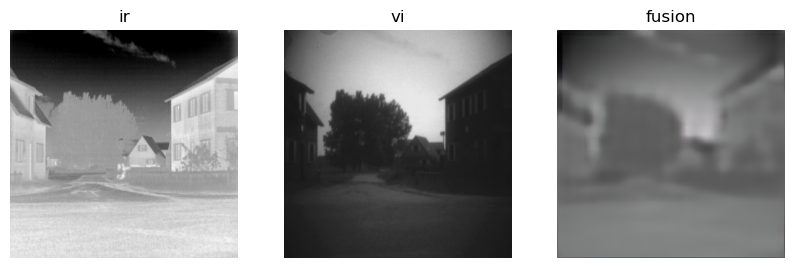

D_epoch_loss:1.2903623580932617,G_epoch_loss:1.1576974391937256
Epoch: 424 D_epoch_loss:1.3106684684753418,G_epoch_loss:1.142682671546936
Epoch: 425 D_epoch_loss:1.3152940273284912,G_epoch_loss:1.1473215818405151
Epoch: 426 D_epoch_loss:1.3105289936065674,G_epoch_loss:1.1608601808547974
Epoch: 427 D_epoch_loss:1.2901132106781006,G_epoch_loss:1.1565256118774414
Epoch: 428 D_epoch_loss:1.3072450160980225,G_epoch_loss:1.1240679025650024
Epoch: 429 D_epoch_loss:1.3371577262878418,G_epoch_loss:1.1324334144592285
Epoch: 430 D_epoch_loss:1.3278164863586426,G_epoch_loss:1.1446762084960938
Epoch: 431 D_epoch_loss:1.2765190601348877,G_epoch_loss:1.1763936281204224
Epoch: 432 D_epoch_loss:1.3007266521453857,G_epoch_loss:1.2023086547851562
Epoch: 433 D_epoch_loss:1.3158621788024902,G_epoch_loss:1.1521809101104736
Epoch: 434 D_epoch_loss:1.3222795724868774,G_epoch_loss:1.146759033203125
Epoch: 435 D_epoch_loss:1.3159220218658447,G_epoch_loss:1.149976134300232
Epoch: 436 D_epoch_loss:1.3395323753356

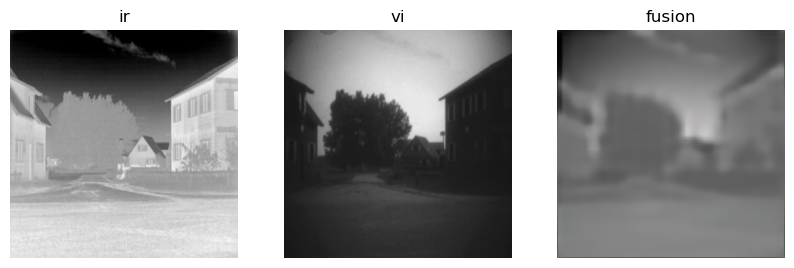

D_epoch_loss:1.3114269971847534,G_epoch_loss:1.1587185859680176
Epoch: 471 D_epoch_loss:1.312321662902832,G_epoch_loss:1.1841957569122314
Epoch: 472 D_epoch_loss:1.3017818927764893,G_epoch_loss:1.1755237579345703
Epoch: 473 D_epoch_loss:1.2915948629379272,G_epoch_loss:1.1468660831451416
Epoch: 474 D_epoch_loss:1.3105535507202148,G_epoch_loss:1.1880137920379639
Epoch: 475 D_epoch_loss:1.3186452388763428,G_epoch_loss:1.1846052408218384
Epoch: 476 D_epoch_loss:1.3127473592758179,G_epoch_loss:1.163299798965454
Epoch: 477 D_epoch_loss:1.2886176109313965,G_epoch_loss:1.18523371219635
Epoch: 478 D_epoch_loss:1.3171577453613281,G_epoch_loss:1.1570994853973389
Epoch: 479 D_epoch_loss:1.2908552885055542,G_epoch_loss:1.1647953987121582
Epoch: 480 D_epoch_loss:1.2704944610595703,G_epoch_loss:1.1370720863342285
Epoch: 481 D_epoch_loss:1.2984282970428467,G_epoch_loss:1.1472562551498413
Epoch: 482 D_epoch_loss:1.3070261478424072,G_epoch_loss:1.157691240310669
Epoch: 483 D_epoch_loss:1.285673618316650

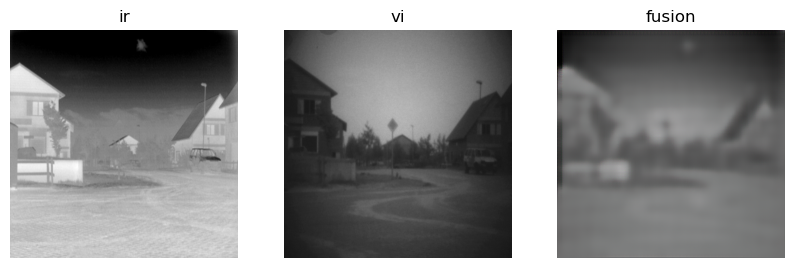

D_epoch_loss:1.3045156002044678,G_epoch_loss:1.173649549484253
Epoch: 518 D_epoch_loss:1.3096356391906738,G_epoch_loss:1.1603705883026123
Epoch: 519 D_epoch_loss:1.3008646965026855,G_epoch_loss:1.1764616966247559
Epoch: 520 D_epoch_loss:1.287757158279419,G_epoch_loss:1.1877171993255615
Epoch: 521 D_epoch_loss:1.3009238243103027,G_epoch_loss:1.20911705493927
Epoch: 522 D_epoch_loss:1.2891108989715576,G_epoch_loss:1.1927831172943115
Epoch: 523 D_epoch_loss:1.3084111213684082,G_epoch_loss:1.211069941520691
Epoch: 524 D_epoch_loss:1.2873259782791138,G_epoch_loss:1.2117230892181396
Epoch: 525 D_epoch_loss:1.2968339920043945,G_epoch_loss:1.1779351234436035
Epoch: 526 D_epoch_loss:1.2974095344543457,G_epoch_loss:1.1654415130615234
Epoch: 527 D_epoch_loss:1.300403356552124,G_epoch_loss:1.1795108318328857
Epoch: 528 D_epoch_loss:1.2832458019256592,G_epoch_loss:1.1802719831466675
Epoch: 529 D_epoch_loss:1.2834012508392334,G_epoch_loss:1.1984719038009644
Epoch: 530 D_epoch_loss:1.2943611145019531

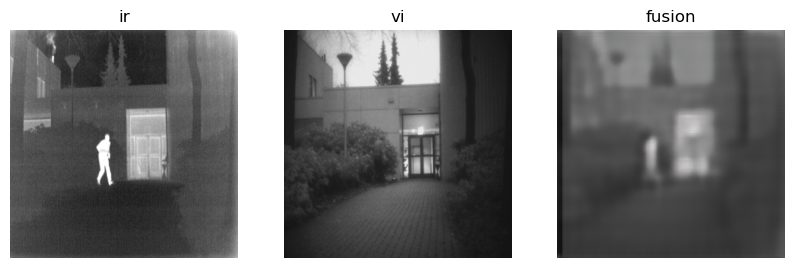

D_epoch_loss:1.3049665689468384,G_epoch_loss:1.2151931524276733
Epoch: 565 D_epoch_loss:1.2878369092941284,G_epoch_loss:1.1733828783035278
Epoch: 566 D_epoch_loss:1.300570011138916,G_epoch_loss:1.1665661334991455
Epoch: 567 D_epoch_loss:1.322879433631897,G_epoch_loss:1.2056715488433838
Epoch: 568 D_epoch_loss:1.3020681142807007,G_epoch_loss:1.1894211769104004
Epoch: 569 D_epoch_loss:1.3249679803848267,G_epoch_loss:1.1893723011016846
Epoch: 570 D_epoch_loss:1.3185334205627441,G_epoch_loss:1.1647772789001465
Epoch: 571 D_epoch_loss:1.312848448753357,G_epoch_loss:1.1790591478347778
Epoch: 572 D_epoch_loss:1.3138309717178345,G_epoch_loss:1.1587110757827759
Epoch: 573 D_epoch_loss:1.3016514778137207,G_epoch_loss:1.1793142557144165
Epoch: 574 D_epoch_loss:1.334958791732788,G_epoch_loss:1.1725564002990723
Epoch: 575 D_epoch_loss:1.3292784690856934,G_epoch_loss:1.220930576324463
Epoch: 576 D_epoch_loss:1.2876486778259277,G_epoch_loss:1.2497788667678833
Epoch: 577 D_epoch_loss:1.275873780250549

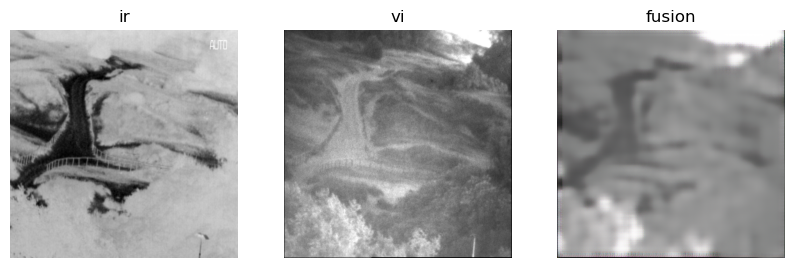

D_epoch_loss:1.336688756942749,G_epoch_loss:1.1581312417984009
Epoch: 612 D_epoch_loss:1.3262066841125488,G_epoch_loss:1.1662046909332275
Epoch: 613 D_epoch_loss:1.2895095348358154,G_epoch_loss:1.1561706066131592
Epoch: 614 D_epoch_loss:1.349790096282959,G_epoch_loss:1.1870293617248535
Epoch: 615 D_epoch_loss:1.2762212753295898,G_epoch_loss:1.1567962169647217
Epoch: 616 D_epoch_loss:1.3156898021697998,G_epoch_loss:1.1659729480743408
Epoch: 617 D_epoch_loss:1.3255069255828857,G_epoch_loss:1.173832893371582
Epoch: 618 D_epoch_loss:1.271188497543335,G_epoch_loss:1.1722204685211182
Epoch: 619 D_epoch_loss:1.2862944602966309,G_epoch_loss:1.1760066747665405
Epoch: 620 D_epoch_loss:1.2792301177978516,G_epoch_loss:1.173476219177246
Epoch: 621 D_epoch_loss:1.3257057666778564,G_epoch_loss:1.1770002841949463
Epoch: 622 D_epoch_loss:1.3368570804595947,G_epoch_loss:1.1736748218536377
Epoch: 623 D_epoch_loss:1.2952989339828491,G_epoch_loss:1.1615931987762451
Epoch: 624 D_epoch_loss:1.270847320556640

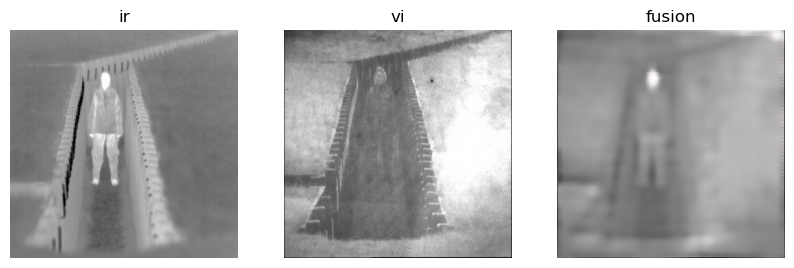

D_epoch_loss:1.3220124244689941,G_epoch_loss:1.200364589691162
Epoch: 659 D_epoch_loss:1.3131699562072754,G_epoch_loss:1.1461405754089355
Epoch: 660 D_epoch_loss:1.2940843105316162,G_epoch_loss:1.1555726528167725
Epoch: 661 D_epoch_loss:1.3156213760375977,G_epoch_loss:1.1547162532806396
Epoch: 662 D_epoch_loss:1.304001808166504,G_epoch_loss:1.1717532873153687
Epoch: 663 D_epoch_loss:1.3008325099945068,G_epoch_loss:1.1746940612792969
Epoch: 664 D_epoch_loss:1.2978949546813965,G_epoch_loss:1.1775856018066406
Epoch: 665 D_epoch_loss:1.2844855785369873,G_epoch_loss:1.1897032260894775
Epoch: 666 D_epoch_loss:1.3240982294082642,G_epoch_loss:1.1665961742401123
Epoch: 667 D_epoch_loss:1.3227611780166626,G_epoch_loss:1.149187684059143
Epoch: 668 D_epoch_loss:1.320428490638733,G_epoch_loss:1.1499505043029785
Epoch: 669 D_epoch_loss:1.3218841552734375,G_epoch_loss:1.1713979244232178
Epoch: 670 D_epoch_loss:1.3152313232421875,G_epoch_loss:1.154515027999878
Epoch: 671 D_epoch_loss:1.326278209686279

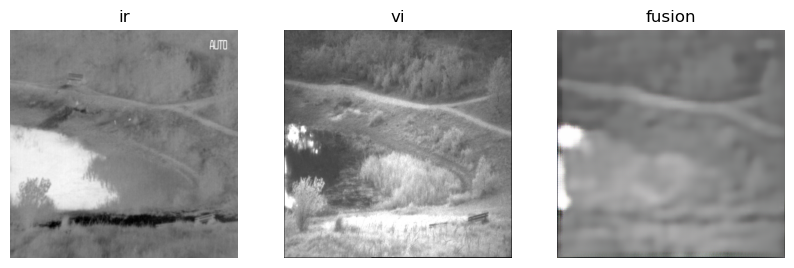

D_epoch_loss:1.331820011138916,G_epoch_loss:1.1889238357543945
Epoch: 706 D_epoch_loss:1.3286722898483276,G_epoch_loss:1.1925418376922607
Epoch: 707 D_epoch_loss:1.3240466117858887,G_epoch_loss:1.1848337650299072
Epoch: 708 D_epoch_loss:1.3097491264343262,G_epoch_loss:1.1649069786071777
Epoch: 709 D_epoch_loss:1.3021492958068848,G_epoch_loss:1.1789811849594116
Epoch: 710 D_epoch_loss:1.3222171068191528,G_epoch_loss:1.1606483459472656
Epoch: 711 D_epoch_loss:1.3011902570724487,G_epoch_loss:1.1512396335601807
Epoch: 712 D_epoch_loss:1.288967251777649,G_epoch_loss:1.190622329711914
Epoch: 713 D_epoch_loss:1.3057435750961304,G_epoch_loss:1.1540839672088623
Epoch: 714 D_epoch_loss:1.3230841159820557,G_epoch_loss:1.1833243370056152
Epoch: 715 D_epoch_loss:1.2878236770629883,G_epoch_loss:1.149526834487915
Epoch: 716 D_epoch_loss:1.3314865827560425,G_epoch_loss:1.1278992891311646
Epoch: 717 D_epoch_loss:1.3224155902862549,G_epoch_loss:1.1718579530715942
Epoch: 718 D_epoch_loss:1.30834758281707

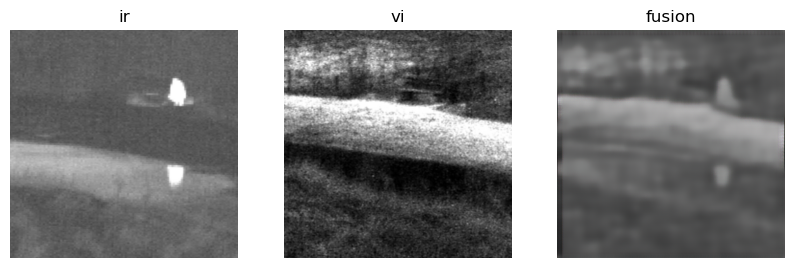

D_epoch_loss:1.283998727798462,G_epoch_loss:1.1798791885375977
Epoch: 753 D_epoch_loss:1.297156572341919,G_epoch_loss:1.146708607673645
Epoch: 754 D_epoch_loss:1.2972066402435303,G_epoch_loss:1.163825511932373
Epoch: 755 D_epoch_loss:1.3126907348632812,G_epoch_loss:1.140148639678955
Epoch: 756 D_epoch_loss:1.355379343032837,G_epoch_loss:1.196746826171875
Epoch: 757 D_epoch_loss:1.2632571458816528,G_epoch_loss:1.1678869724273682
Epoch: 758 D_epoch_loss:1.2984375953674316,G_epoch_loss:1.157719612121582
Epoch: 759 D_epoch_loss:1.2830455303192139,G_epoch_loss:1.1536741256713867
Epoch: 760 D_epoch_loss:1.3711107969284058,G_epoch_loss:1.1847145557403564
Epoch: 761 D_epoch_loss:1.2856082916259766,G_epoch_loss:1.1667354106903076
Epoch: 762 D_epoch_loss:1.2890491485595703,G_epoch_loss:1.1586658954620361
Epoch: 763 D_epoch_loss:1.315950632095337,G_epoch_loss:1.13834810256958
Epoch: 764 D_epoch_loss:1.3047852516174316,G_epoch_loss:1.163025140762329
Epoch: 765 D_epoch_loss:1.3102891445159912,G_epo

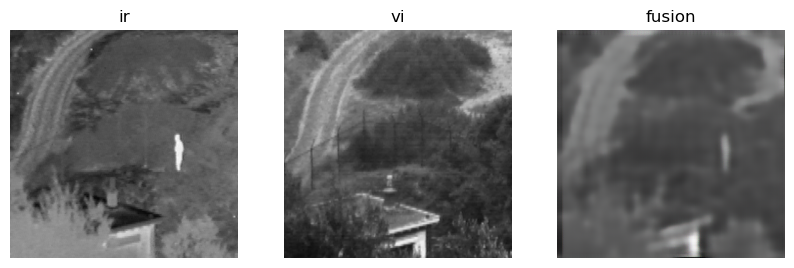

D_epoch_loss:1.2884832620620728,G_epoch_loss:1.1643681526184082
Epoch: 800 D_epoch_loss:1.2799224853515625,G_epoch_loss:1.1705522537231445
Epoch: 801 D_epoch_loss:1.2944642305374146,G_epoch_loss:1.1767762899398804
Epoch: 802 D_epoch_loss:1.277588129043579,G_epoch_loss:1.2065670490264893
Epoch: 803 D_epoch_loss:1.2824684381484985,G_epoch_loss:1.164771556854248
Epoch: 804 D_epoch_loss:1.3269240856170654,G_epoch_loss:1.1487228870391846
Epoch: 805 D_epoch_loss:1.3053268194198608,G_epoch_loss:1.1264548301696777
Epoch: 806 D_epoch_loss:1.2965667247772217,G_epoch_loss:1.1483192443847656
Epoch: 807 D_epoch_loss:1.3044383525848389,G_epoch_loss:1.1665091514587402
Epoch: 808 D_epoch_loss:1.2923431396484375,G_epoch_loss:1.1736069917678833
Epoch: 809 D_epoch_loss:1.3141627311706543,G_epoch_loss:1.1666580438613892
Epoch: 810 D_epoch_loss:1.3321865797042847,G_epoch_loss:1.1991230249404907
Epoch: 811 D_epoch_loss:1.3092693090438843,G_epoch_loss:1.1777019500732422
Epoch: 812 D_epoch_loss:1.308081984519

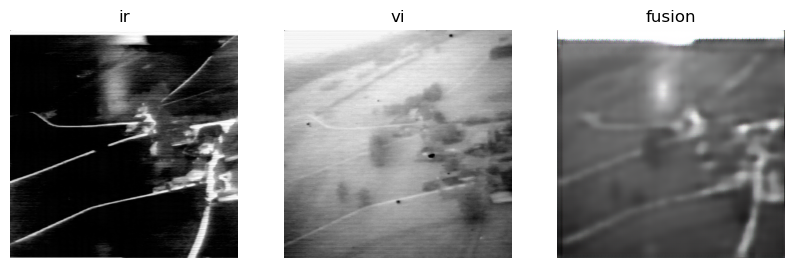

D_epoch_loss:1.339666724205017,G_epoch_loss:1.1480932235717773
Epoch: 847 D_epoch_loss:1.3218226432800293,G_epoch_loss:1.1156309843063354
Epoch: 848 D_epoch_loss:1.2915053367614746,G_epoch_loss:1.1706688404083252
Epoch: 849 D_epoch_loss:1.3247337341308594,G_epoch_loss:1.1710572242736816
Epoch: 850 D_epoch_loss:1.2890806198120117,G_epoch_loss:1.139191746711731
Epoch: 851 D_epoch_loss:1.2834630012512207,G_epoch_loss:1.1771090030670166
Epoch: 852 D_epoch_loss:1.3442869186401367,G_epoch_loss:1.1738594770431519
Epoch: 853 D_epoch_loss:1.317743182182312,G_epoch_loss:1.1827847957611084
Epoch: 854 D_epoch_loss:1.265468716621399,G_epoch_loss:1.1332875490188599
Epoch: 855 D_epoch_loss:1.2527351379394531,G_epoch_loss:1.1597460508346558
Epoch: 856 D_epoch_loss:1.3151408433914185,G_epoch_loss:1.154026746749878
Epoch: 857 D_epoch_loss:1.2827715873718262,G_epoch_loss:1.127575397491455
Epoch: 858 D_epoch_loss:1.2704050540924072,G_epoch_loss:1.1694380044937134
Epoch: 859 D_epoch_loss:1.2895491123199463

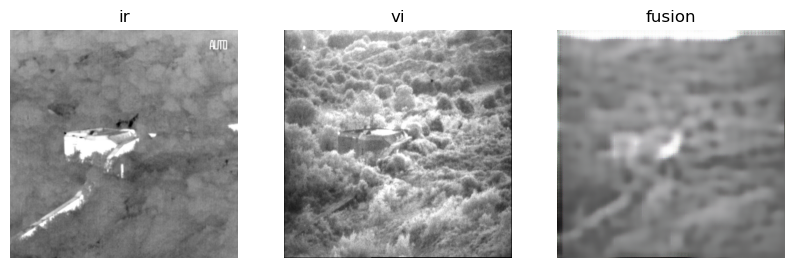

D_epoch_loss:1.3105504512786865,G_epoch_loss:1.1274418830871582
Epoch: 894 D_epoch_loss:1.3526955842971802,G_epoch_loss:1.1219229698181152
Epoch: 895 D_epoch_loss:1.3086252212524414,G_epoch_loss:1.0897598266601562
Epoch: 896 D_epoch_loss:1.3198704719543457,G_epoch_loss:1.1174354553222656
Epoch: 897 D_epoch_loss:1.3282933235168457,G_epoch_loss:1.115618109703064
Epoch: 898 D_epoch_loss:1.3256661891937256,G_epoch_loss:1.1029597520828247
Epoch: 899 D_epoch_loss:1.3105065822601318,G_epoch_loss:1.1188836097717285
Epoch: 900 D_epoch_loss:1.3228445053100586,G_epoch_loss:1.125882863998413
Epoch: 901 D_epoch_loss:1.30916428565979,G_epoch_loss:1.113389492034912
Epoch: 902 D_epoch_loss:1.3553776741027832,G_epoch_loss:1.1034972667694092
Epoch: 903 D_epoch_loss:1.3203125,G_epoch_loss:1.1223278045654297
Epoch: 904 D_epoch_loss:1.3429101705551147,G_epoch_loss:1.1031664609909058
Epoch: 905 D_epoch_loss:1.352251410484314,G_epoch_loss:1.1353185176849365
Epoch: 906 D_epoch_loss:1.3005092144012451,G_epoch_

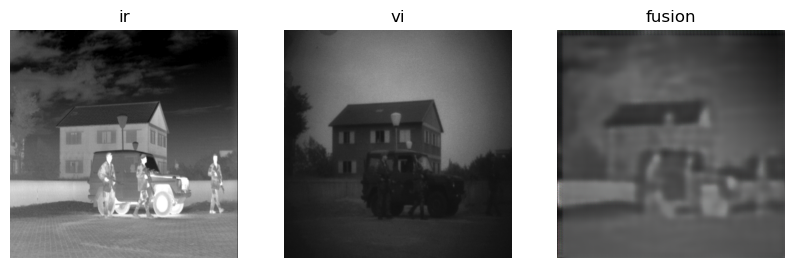

D_epoch_loss:1.3149490356445312,G_epoch_loss:1.130289077758789
Epoch: 941 D_epoch_loss:1.318310022354126,G_epoch_loss:1.137627363204956
Epoch: 942 D_epoch_loss:1.3166074752807617,G_epoch_loss:1.1121068000793457
Epoch: 943 D_epoch_loss:1.2876837253570557,G_epoch_loss:1.1302618980407715
Epoch: 944 D_epoch_loss:1.324568271636963,G_epoch_loss:1.102623462677002
Epoch: 945 D_epoch_loss:1.3280198574066162,G_epoch_loss:1.1160378456115723
Epoch: 946 D_epoch_loss:1.3250552415847778,G_epoch_loss:1.123490810394287
Epoch: 947 D_epoch_loss:1.3543903827667236,G_epoch_loss:1.1184974908828735
Epoch: 948 D_epoch_loss:1.309131383895874,G_epoch_loss:1.0937180519104004
Epoch: 949 D_epoch_loss:1.321679711341858,G_epoch_loss:1.1033234596252441
Epoch: 950 D_epoch_loss:1.2881877422332764,G_epoch_loss:1.1241397857666016
Epoch: 951 D_epoch_loss:1.3044085502624512,G_epoch_loss:1.1131269931793213
Epoch: 952 D_epoch_loss:1.329075574874878,G_epoch_loss:1.1438877582550049
Epoch: 953 D_epoch_loss:1.3277251720428467,G_

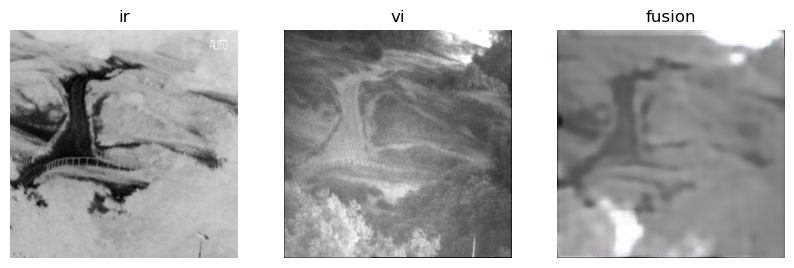

D_epoch_loss:1.3639776706695557,G_epoch_loss:1.1509099006652832
Epoch: 988 D_epoch_loss:1.323408603668213,G_epoch_loss:1.12875497341156
Epoch: 989 D_epoch_loss:1.3138232231140137,G_epoch_loss:1.1414949893951416
Epoch: 990 D_epoch_loss:1.298290491104126,G_epoch_loss:1.1280423402786255
Epoch: 991 D_epoch_loss:1.2961453199386597,G_epoch_loss:1.1419250965118408
Epoch: 992 D_epoch_loss:1.3254097700119019,G_epoch_loss:1.1359736919403076
Epoch: 993 D_epoch_loss:1.294579029083252,G_epoch_loss:1.105093002319336
Epoch: 994 D_epoch_loss:1.334411382675171,G_epoch_loss:1.126941204071045
Epoch: 995 D_epoch_loss:1.32505202293396,G_epoch_loss:1.1205081939697266
Epoch: 996 D_epoch_loss:1.3142781257629395,G_epoch_loss:1.1333681344985962
Epoch: 997 D_epoch_loss:1.2837351560592651,G_epoch_loss:1.1399080753326416
Epoch: 998 D_epoch_loss:1.3714622259140015,G_epoch_loss:1.1192569732666016
Epoch: 999 D_epoch_loss:1.3703625202178955,G_epoch_loss:1.1579463481903076
Epoch: 1000 D_epoch_loss:1.3381383419036865,G_

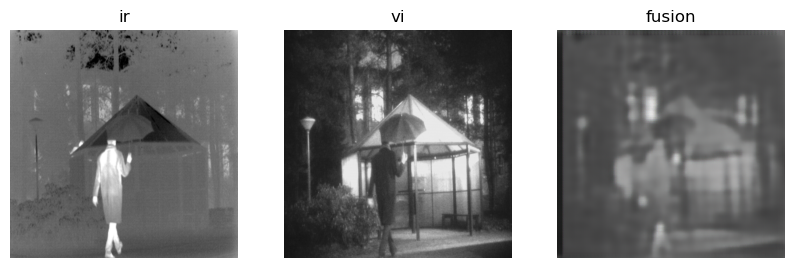

D_epoch_loss:1.3226344585418701,G_epoch_loss:1.1254931688308716
Epoch: 1035 D_epoch_loss:1.3206803798675537,G_epoch_loss:1.1638069152832031
Epoch: 1036 D_epoch_loss:1.305818796157837,G_epoch_loss:1.1380306482315063
Epoch: 1037 D_epoch_loss:1.321230411529541,G_epoch_loss:1.1424425840377808
Epoch: 1038 D_epoch_loss:1.3270328044891357,G_epoch_loss:1.131834864616394
Epoch: 1039 D_epoch_loss:1.3681172132492065,G_epoch_loss:1.1614840030670166
Epoch: 1040 D_epoch_loss:1.3425564765930176,G_epoch_loss:1.115372896194458
Epoch: 1041 D_epoch_loss:1.3124148845672607,G_epoch_loss:1.1341352462768555
Epoch: 1042 D_epoch_loss:1.3343336582183838,G_epoch_loss:1.136699914932251
Epoch: 1043 D_epoch_loss:1.3054635524749756,G_epoch_loss:1.1333953142166138
Epoch: 1044 D_epoch_loss:1.2898783683776855,G_epoch_loss:1.1230480670928955
Epoch: 1045 D_epoch_loss:1.3443779945373535,G_epoch_loss:1.180870771408081
Epoch: 1046 D_epoch_loss:1.2875711917877197,G_epoch_loss:1.1348313093185425
Epoch: 1047 D_epoch_loss:1.327

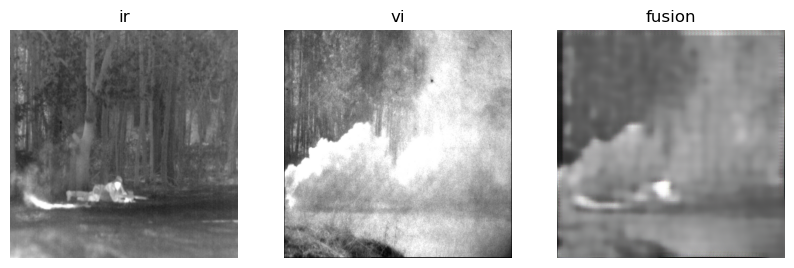

D_epoch_loss:1.3375475406646729,G_epoch_loss:1.1797189712524414
Epoch: 1082 D_epoch_loss:1.2901592254638672,G_epoch_loss:1.132126808166504
Epoch: 1083 D_epoch_loss:1.3116915225982666,G_epoch_loss:1.1064603328704834
Epoch: 1084 D_epoch_loss:1.3617862462997437,G_epoch_loss:1.1330616474151611
Epoch: 1085 D_epoch_loss:1.3337934017181396,G_epoch_loss:1.1459102630615234
Epoch: 1086 D_epoch_loss:1.3630900382995605,G_epoch_loss:1.1419191360473633
Epoch: 1087 D_epoch_loss:1.3515468835830688,G_epoch_loss:1.1329610347747803
Epoch: 1088 D_epoch_loss:1.3388309478759766,G_epoch_loss:1.14213228225708
Epoch: 1089 D_epoch_loss:1.3115310668945312,G_epoch_loss:1.132101058959961
Epoch: 1090 D_epoch_loss:1.3295015096664429,G_epoch_loss:1.1298229694366455
Epoch: 1091 D_epoch_loss:1.3955235481262207,G_epoch_loss:1.1223371028900146
Epoch: 1092 D_epoch_loss:1.3386096954345703,G_epoch_loss:1.1305783987045288
Epoch: 1093 D_epoch_loss:1.323578119277954,G_epoch_loss:1.1444075107574463
Epoch: 1094 D_epoch_loss:1.30

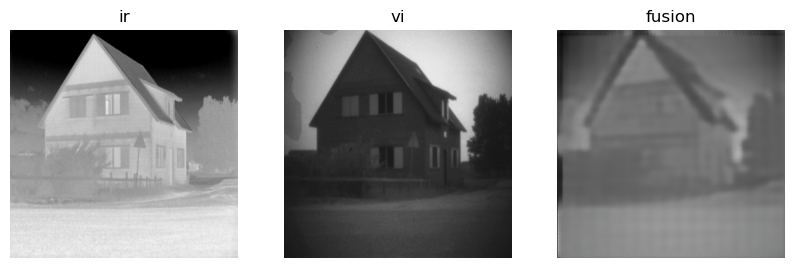

D_epoch_loss:1.339733362197876,G_epoch_loss:1.1210227012634277
Epoch: 1129 D_epoch_loss:1.344719648361206,G_epoch_loss:1.1308019161224365
Epoch: 1130 D_epoch_loss:1.2958811521530151,G_epoch_loss:1.1354992389678955
Epoch: 1131 D_epoch_loss:1.28944993019104,G_epoch_loss:1.1223280429840088
Epoch: 1132 D_epoch_loss:1.3615922927856445,G_epoch_loss:1.1313798427581787
Epoch: 1133 D_epoch_loss:1.3440834283828735,G_epoch_loss:1.1165385246276855
Epoch: 1134 D_epoch_loss:1.3010693788528442,G_epoch_loss:1.1093380451202393
Epoch: 1135 D_epoch_loss:1.3154337406158447,G_epoch_loss:1.1124489307403564
Epoch: 1136 D_epoch_loss:1.30918550491333,G_epoch_loss:1.134408712387085
Epoch: 1137 D_epoch_loss:1.3173227310180664,G_epoch_loss:1.1315014362335205
Epoch: 1138 D_epoch_loss:1.2997193336486816,G_epoch_loss:1.107667326927185
Epoch: 1139 D_epoch_loss:1.3227795362472534,G_epoch_loss:1.09825599193573
Epoch: 1140 D_epoch_loss:1.3547263145446777,G_epoch_loss:1.1315639019012451
Epoch: 1141 D_epoch_loss:1.3144276

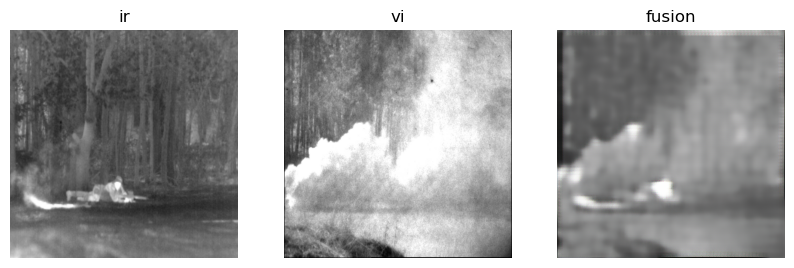

D_epoch_loss:1.3476369380950928,G_epoch_loss:1.138944149017334
Epoch: 1176 D_epoch_loss:1.3352830410003662,G_epoch_loss:1.1288350820541382
Epoch: 1177 D_epoch_loss:1.3446342945098877,G_epoch_loss:1.1504260301589966
Epoch: 1178 D_epoch_loss:1.3305379152297974,G_epoch_loss:1.1280090808868408
Epoch: 1179 D_epoch_loss:1.3182268142700195,G_epoch_loss:1.1391475200653076
Epoch: 1180 D_epoch_loss:1.348926067352295,G_epoch_loss:1.133322834968567
Epoch: 1181 D_epoch_loss:1.329395055770874,G_epoch_loss:1.121138572692871
Epoch: 1182 D_epoch_loss:1.2984189987182617,G_epoch_loss:1.1201460361480713
Epoch: 1183 D_epoch_loss:1.314885139465332,G_epoch_loss:1.1293760538101196
Epoch: 1184 D_epoch_loss:1.3450406789779663,G_epoch_loss:1.108351230621338
Epoch: 1185 D_epoch_loss:1.2845420837402344,G_epoch_loss:1.1256775856018066
Epoch: 1186 D_epoch_loss:1.3142330646514893,G_epoch_loss:1.1034365892410278
Epoch: 1187 D_epoch_loss:1.3455328941345215,G_epoch_loss:1.1370024681091309
Epoch: 1188 D_epoch_loss:1.3265

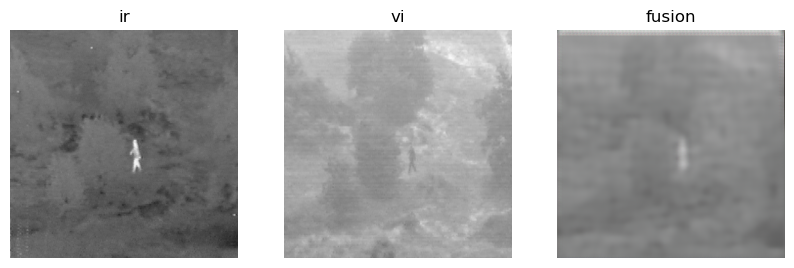

D_epoch_loss:1.3604904413223267,G_epoch_loss:1.1538488864898682
Epoch: 1223 D_epoch_loss:1.284364104270935,G_epoch_loss:1.1510109901428223
Epoch: 1224 D_epoch_loss:1.2936058044433594,G_epoch_loss:1.1336733102798462
Epoch: 1225 D_epoch_loss:1.304694652557373,G_epoch_loss:1.122638463973999
Epoch: 1226 D_epoch_loss:1.313779354095459,G_epoch_loss:1.1363381147384644
Epoch: 1227 D_epoch_loss:1.273684024810791,G_epoch_loss:1.108522653579712
Epoch: 1228 D_epoch_loss:1.3500244617462158,G_epoch_loss:1.1198203563690186
Epoch: 1229 D_epoch_loss:1.365121841430664,G_epoch_loss:1.1449270248413086
Epoch: 1230 D_epoch_loss:1.3295207023620605,G_epoch_loss:1.1401808261871338
Epoch: 1231 D_epoch_loss:1.3491305112838745,G_epoch_loss:1.150134801864624
Epoch: 1232 D_epoch_loss:1.3113865852355957,G_epoch_loss:1.1453887224197388
Epoch: 1233 D_epoch_loss:1.3611558675765991,G_epoch_loss:1.1356548070907593
Epoch: 1234 D_epoch_loss:1.301086187362671,G_epoch_loss:1.136062502861023
Epoch: 1235 D_epoch_loss:1.3291407

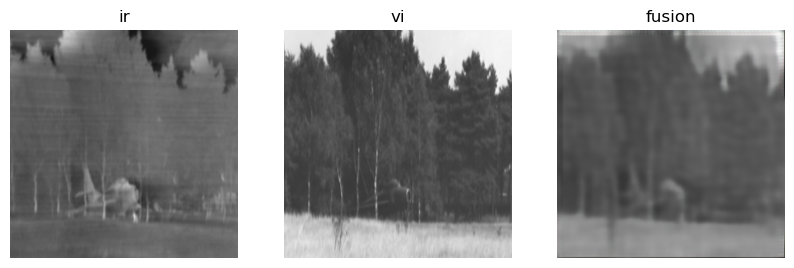

D_epoch_loss:1.3244892358779907,G_epoch_loss:1.162477731704712
Epoch: 1270 D_epoch_loss:1.315493106842041,G_epoch_loss:1.1267023086547852
Epoch: 1271 D_epoch_loss:1.309345006942749,G_epoch_loss:1.168058156967163
Epoch: 1272 D_epoch_loss:1.3236114978790283,G_epoch_loss:1.0947585105895996
Epoch: 1273 D_epoch_loss:1.3526641130447388,G_epoch_loss:1.1289960145950317
Epoch: 1274 D_epoch_loss:1.3395522832870483,G_epoch_loss:1.1439231634140015
Epoch: 1275 D_epoch_loss:1.3279566764831543,G_epoch_loss:1.1820917129516602
Epoch: 1276 D_epoch_loss:1.2749807834625244,G_epoch_loss:1.145776391029358
Epoch: 1277 D_epoch_loss:1.3166409730911255,G_epoch_loss:1.1409341096878052
Epoch: 1278 D_epoch_loss:1.346311092376709,G_epoch_loss:1.1059285402297974
Epoch: 1279 D_epoch_loss:1.3295066356658936,G_epoch_loss:1.1100232601165771
Epoch: 1280 D_epoch_loss:1.3409907817840576,G_epoch_loss:1.1223589181900024
Epoch: 1281 D_epoch_loss:1.3208388090133667,G_epoch_loss:1.1119848489761353
Epoch: 1282 D_epoch_loss:1.318

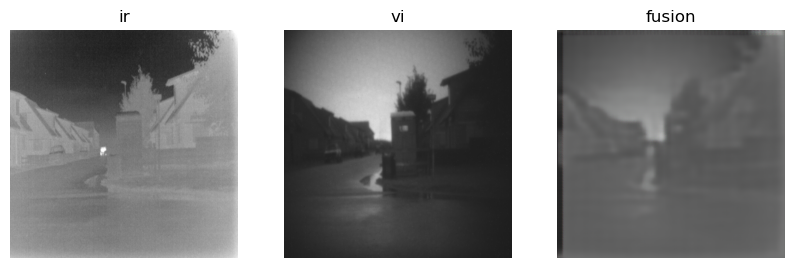

D_epoch_loss:1.3055331707000732,G_epoch_loss:1.1757171154022217
Epoch: 1317 D_epoch_loss:1.3279533386230469,G_epoch_loss:1.1435415744781494
Epoch: 1318 D_epoch_loss:1.322645902633667,G_epoch_loss:1.1328356266021729
Epoch: 1319 D_epoch_loss:1.309964895248413,G_epoch_loss:1.1125112771987915
Epoch: 1320 D_epoch_loss:1.3319423198699951,G_epoch_loss:1.1428325176239014
Epoch: 1321 D_epoch_loss:1.2780048847198486,G_epoch_loss:1.1223052740097046
Epoch: 1322 D_epoch_loss:1.3109925985336304,G_epoch_loss:1.1316955089569092
Epoch: 1323 D_epoch_loss:1.3275177478790283,G_epoch_loss:1.1072485446929932
Epoch: 1324 D_epoch_loss:1.3453238010406494,G_epoch_loss:1.1406364440917969
Epoch: 1325 D_epoch_loss:1.29512619972229,G_epoch_loss:1.1347930431365967
Epoch: 1326 D_epoch_loss:1.320073127746582,G_epoch_loss:1.1180897951126099
Epoch: 1327 D_epoch_loss:1.3424090147018433,G_epoch_loss:1.1056283712387085
Epoch: 1328 D_epoch_loss:1.2998310327529907,G_epoch_loss:1.110412359237671
Epoch: 1329 D_epoch_loss:1.264

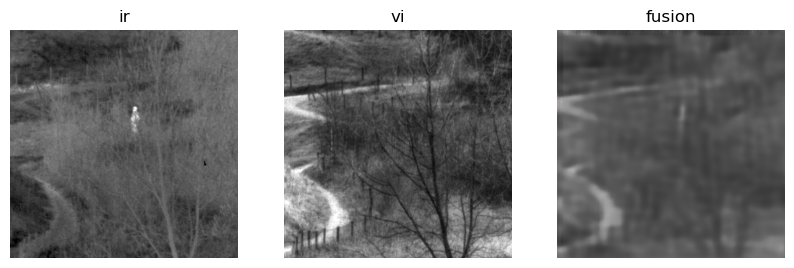

D_epoch_loss:1.3076106309890747,G_epoch_loss:1.148578405380249
Epoch: 1364 D_epoch_loss:1.284529447555542,G_epoch_loss:1.1496816873550415
Epoch: 1365 D_epoch_loss:1.3084397315979004,G_epoch_loss:1.1736321449279785
Epoch: 1366 D_epoch_loss:1.352280855178833,G_epoch_loss:1.1442426443099976
Epoch: 1367 D_epoch_loss:1.35801100730896,G_epoch_loss:1.143892765045166
Epoch: 1368 D_epoch_loss:1.2822442054748535,G_epoch_loss:1.15179443359375
Epoch: 1369 D_epoch_loss:1.3220279216766357,G_epoch_loss:1.1338176727294922
Epoch: 1370 D_epoch_loss:1.3655779361724854,G_epoch_loss:1.1607108116149902
Epoch: 1371 D_epoch_loss:1.2984884977340698,G_epoch_loss:1.1365208625793457
Epoch: 1372 D_epoch_loss:1.278993844985962,G_epoch_loss:1.1157106161117554
Epoch: 1373 D_epoch_loss:1.3491120338439941,G_epoch_loss:1.1490954160690308
Epoch: 1374 D_epoch_loss:1.381730318069458,G_epoch_loss:1.136766791343689
Epoch: 1375 D_epoch_loss:1.3143880367279053,G_epoch_loss:1.132296085357666
Epoch: 1376 D_epoch_loss:1.317773461

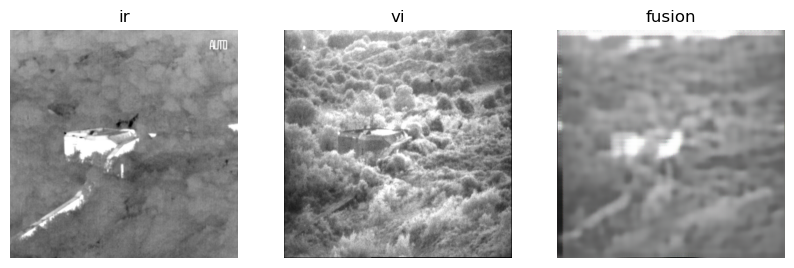

D_epoch_loss:1.2892084121704102,G_epoch_loss:1.1271588802337646
Epoch: 1411 D_epoch_loss:1.3196614980697632,G_epoch_loss:1.1248044967651367
Epoch: 1412 D_epoch_loss:1.3024373054504395,G_epoch_loss:1.1252771615982056
Epoch: 1413 D_epoch_loss:1.3419581651687622,G_epoch_loss:1.1306238174438477
Epoch: 1414 D_epoch_loss:1.3205783367156982,G_epoch_loss:1.1285862922668457
Epoch: 1415 D_epoch_loss:1.3199663162231445,G_epoch_loss:1.1312576532363892
Epoch: 1416 D_epoch_loss:1.3027911186218262,G_epoch_loss:1.1638785600662231
Epoch: 1417 D_epoch_loss:1.2989566326141357,G_epoch_loss:1.1288200616836548
Epoch: 1418 D_epoch_loss:1.3228840827941895,G_epoch_loss:1.1089874505996704
Epoch: 1419 D_epoch_loss:1.292952299118042,G_epoch_loss:1.1232271194458008
Epoch: 1420 D_epoch_loss:1.3150264024734497,G_epoch_loss:1.1371829509735107
Epoch: 1421 D_epoch_loss:1.2948956489562988,G_epoch_loss:1.1286964416503906
Epoch: 1422 D_epoch_loss:1.3166797161102295,G_epoch_loss:1.124821662902832
Epoch: 1423 D_epoch_loss:1

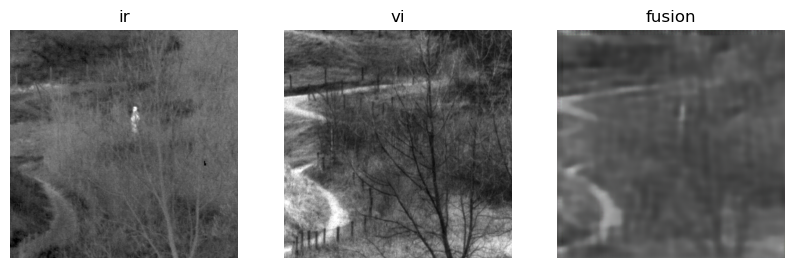

D_epoch_loss:1.3101933002471924,G_epoch_loss:1.11130690574646
Epoch: 1458 D_epoch_loss:1.2948009967803955,G_epoch_loss:1.1710340976715088
Epoch: 1459 D_epoch_loss:1.3147244453430176,G_epoch_loss:1.142061471939087
Epoch: 1460 D_epoch_loss:1.3447489738464355,G_epoch_loss:1.136749029159546
Epoch: 1461 D_epoch_loss:1.305201768875122,G_epoch_loss:1.1061618328094482
Epoch: 1462 D_epoch_loss:1.3461413383483887,G_epoch_loss:1.1125507354736328
Epoch: 1463 D_epoch_loss:1.3122758865356445,G_epoch_loss:1.0986075401306152
Epoch: 1464 D_epoch_loss:1.3239109516143799,G_epoch_loss:1.1217257976531982
Epoch: 1465 D_epoch_loss:1.3692703247070312,G_epoch_loss:1.1549242734909058
Epoch: 1466 D_epoch_loss:1.273643970489502,G_epoch_loss:1.1552860736846924
Epoch: 1467 D_epoch_loss:1.315281629562378,G_epoch_loss:1.171888828277588
Epoch: 1468 D_epoch_loss:1.3261048793792725,G_epoch_loss:1.1421353816986084
Epoch: 1469 D_epoch_loss:1.360971450805664,G_epoch_loss:1.1556037664413452
Epoch: 1470 D_epoch_loss:1.274602

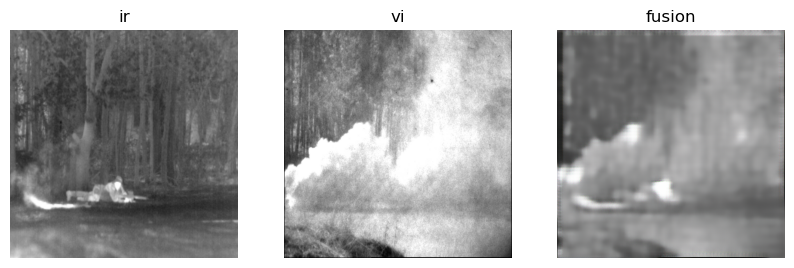

D_epoch_loss:1.3051025867462158,G_epoch_loss:1.131929874420166
Epoch: 1505 D_epoch_loss:1.3108246326446533,G_epoch_loss:1.0822579860687256
Epoch: 1506 D_epoch_loss:1.3159430027008057,G_epoch_loss:1.1020464897155762
Epoch: 1507 D_epoch_loss:1.293868064880371,G_epoch_loss:1.0881567001342773
Epoch: 1508 D_epoch_loss:1.3601469993591309,G_epoch_loss:1.1370068788528442
Epoch: 1509 D_epoch_loss:1.3057013750076294,G_epoch_loss:1.1124833822250366
Epoch: 1510 D_epoch_loss:1.3411338329315186,G_epoch_loss:1.0908173322677612
Epoch: 1511 D_epoch_loss:1.355605125427246,G_epoch_loss:1.1139131784439087
Epoch: 1512 D_epoch_loss:1.3375073671340942,G_epoch_loss:1.137869954109192
Epoch: 1513 D_epoch_loss:1.3024652004241943,G_epoch_loss:1.130218744277954
Epoch: 1514 D_epoch_loss:1.3055565357208252,G_epoch_loss:1.1383535861968994
Epoch: 1515 D_epoch_loss:1.3599963188171387,G_epoch_loss:1.161755084991455
Epoch: 1516 D_epoch_loss:1.2778656482696533,G_epoch_loss:1.1482734680175781
Epoch: 1517 D_epoch_loss:1.318

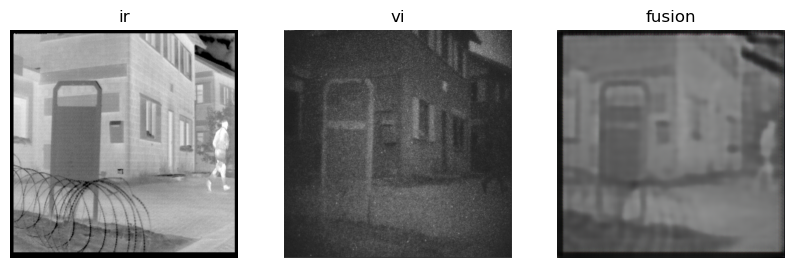

D_epoch_loss:1.2922110557556152,G_epoch_loss:1.12752103805542
Epoch: 1552 D_epoch_loss:1.3174809217453003,G_epoch_loss:1.112027883529663
Epoch: 1553 D_epoch_loss:1.32643461227417,G_epoch_loss:1.1446844339370728
Epoch: 1554 D_epoch_loss:1.3054981231689453,G_epoch_loss:1.1232264041900635
Epoch: 1555 D_epoch_loss:1.3702826499938965,G_epoch_loss:1.1279994249343872
Epoch: 1556 D_epoch_loss:1.3168426752090454,G_epoch_loss:1.112428069114685
Epoch: 1557 D_epoch_loss:1.3211877346038818,G_epoch_loss:1.1513237953186035
Epoch: 1558 D_epoch_loss:1.3474655151367188,G_epoch_loss:1.1099051237106323
Epoch: 1559 D_epoch_loss:1.2832775115966797,G_epoch_loss:1.1289855241775513
Epoch: 1560 D_epoch_loss:1.3147997856140137,G_epoch_loss:1.11629319190979
Epoch: 1561 D_epoch_loss:1.3400394916534424,G_epoch_loss:1.1046991348266602
Epoch: 1562 D_epoch_loss:1.3611459732055664,G_epoch_loss:1.1309672594070435
Epoch: 1563 D_epoch_loss:1.2939603328704834,G_epoch_loss:1.1316280364990234
Epoch: 1564 D_epoch_loss:1.35076

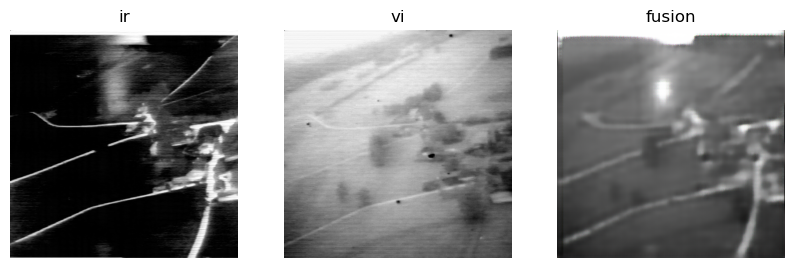

D_epoch_loss:1.2989766597747803,G_epoch_loss:1.147432565689087
Epoch: 1599 D_epoch_loss:1.3260185718536377,G_epoch_loss:1.1722739934921265
Epoch: 1600 D_epoch_loss:1.3317134380340576,G_epoch_loss:1.1711552143096924
Epoch: 1601 D_epoch_loss:1.2715375423431396,G_epoch_loss:1.140586495399475
Epoch: 1602 D_epoch_loss:1.3531620502471924,G_epoch_loss:1.1245461702346802
Epoch: 1603 D_epoch_loss:1.3080036640167236,G_epoch_loss:1.116855502128601
Epoch: 1604 D_epoch_loss:1.2916057109832764,G_epoch_loss:1.1452829837799072
Epoch: 1605 D_epoch_loss:1.330780029296875,G_epoch_loss:1.1508305072784424
Epoch: 1606 D_epoch_loss:1.3170969486236572,G_epoch_loss:1.1349990367889404
Epoch: 1607 D_epoch_loss:1.315812349319458,G_epoch_loss:1.099993109703064
Epoch: 1608 D_epoch_loss:1.34542977809906,G_epoch_loss:1.124672770500183
Epoch: 1609 D_epoch_loss:1.2947218418121338,G_epoch_loss:1.1348683834075928
Epoch: 1610 D_epoch_loss:1.3200072050094604,G_epoch_loss:1.1572437286376953
Epoch: 1611 D_epoch_loss:1.282627

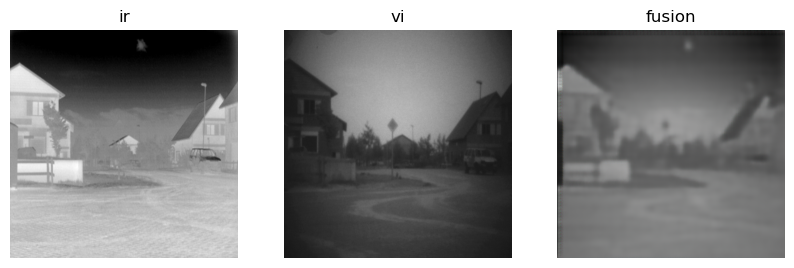

D_epoch_loss:1.3303847312927246,G_epoch_loss:1.1416113376617432
Epoch: 1646 D_epoch_loss:1.3301527500152588,G_epoch_loss:1.1259394884109497
Epoch: 1647 D_epoch_loss:1.3087577819824219,G_epoch_loss:1.104134202003479
Epoch: 1648 D_epoch_loss:1.3219289779663086,G_epoch_loss:1.1469404697418213
Epoch: 1649 D_epoch_loss:1.3667933940887451,G_epoch_loss:1.1151553392410278
Epoch: 1650 D_epoch_loss:1.339599847793579,G_epoch_loss:1.1306700706481934
Epoch: 1651 D_epoch_loss:1.3263330459594727,G_epoch_loss:1.1452504396438599
Epoch: 1652 D_epoch_loss:1.2889330387115479,G_epoch_loss:1.1398407220840454
Epoch: 1653 D_epoch_loss:1.3437941074371338,G_epoch_loss:1.1460951566696167
Epoch: 1654 D_epoch_loss:1.3286666870117188,G_epoch_loss:1.1222169399261475
Epoch: 1655 D_epoch_loss:1.363521695137024,G_epoch_loss:1.1588279008865356
Epoch: 1656 D_epoch_loss:1.37691068649292,G_epoch_loss:1.1466442346572876
Epoch: 1657 D_epoch_loss:1.3342950344085693,G_epoch_loss:1.1934293508529663
Epoch: 1658 D_epoch_loss:1.33

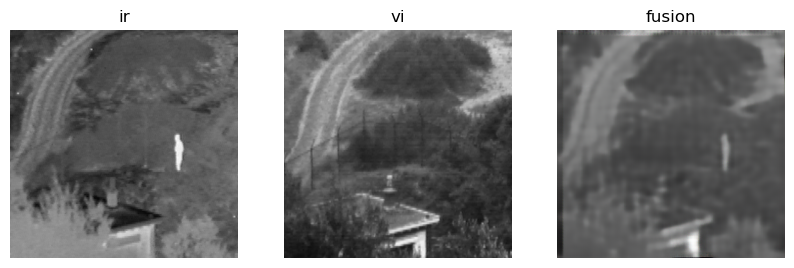

D_epoch_loss:1.2847399711608887,G_epoch_loss:1.1182494163513184
Epoch: 1693 D_epoch_loss:1.2999773025512695,G_epoch_loss:1.1278547048568726
Epoch: 1694 D_epoch_loss:1.3220939636230469,G_epoch_loss:1.121901512145996
Epoch: 1695 D_epoch_loss:1.3331403732299805,G_epoch_loss:1.1130235195159912
Epoch: 1696 D_epoch_loss:1.3053183555603027,G_epoch_loss:1.1355191469192505
Epoch: 1697 D_epoch_loss:1.3371856212615967,G_epoch_loss:1.15873384475708
Epoch: 1698 D_epoch_loss:1.3094887733459473,G_epoch_loss:1.1014214754104614
Epoch: 1699 D_epoch_loss:1.2682753801345825,G_epoch_loss:1.1006823778152466
Epoch: 1700 D_epoch_loss:1.3366405963897705,G_epoch_loss:1.1222145557403564
Epoch: 1701 D_epoch_loss:1.3093934059143066,G_epoch_loss:1.1421618461608887
Epoch: 1702 D_epoch_loss:1.330859661102295,G_epoch_loss:1.1543694734573364
Epoch: 1703 D_epoch_loss:1.3034064769744873,G_epoch_loss:1.1230316162109375
Epoch: 1704 D_epoch_loss:1.3007032871246338,G_epoch_loss:1.1503766775131226
Epoch: 1705 D_epoch_loss:1.3

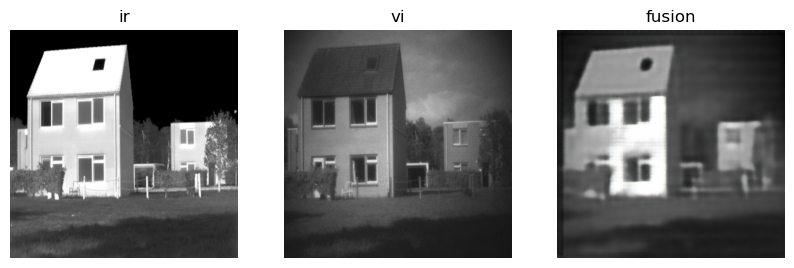

D_epoch_loss:1.324547529220581,G_epoch_loss:1.11328125
Epoch: 1740 D_epoch_loss:1.3260291814804077,G_epoch_loss:1.0990078449249268
Epoch: 1741 D_epoch_loss:1.3229622840881348,G_epoch_loss:1.1305574178695679
Epoch: 1742 D_epoch_loss:1.2938604354858398,G_epoch_loss:1.114292860031128
Epoch: 1743 D_epoch_loss:1.3180458545684814,G_epoch_loss:1.1120493412017822
Epoch: 1744 D_epoch_loss:1.3179349899291992,G_epoch_loss:1.1669275760650635
Epoch: 1745 D_epoch_loss:1.2416672706604004,G_epoch_loss:1.1286951303482056
Epoch: 1746 D_epoch_loss:1.335585117340088,G_epoch_loss:1.1647915840148926
Epoch: 1747 D_epoch_loss:1.2569059133529663,G_epoch_loss:1.1402000188827515
Epoch: 1748 D_epoch_loss:1.3139013051986694,G_epoch_loss:1.1284093856811523
Epoch: 1749 D_epoch_loss:1.3522729873657227,G_epoch_loss:1.1591213941574097
Epoch: 1750 D_epoch_loss:1.2802149057388306,G_epoch_loss:1.136869192123413
Epoch: 1751 D_epoch_loss:1.3023509979248047,G_epoch_loss:1.1663239002227783
Epoch: 1752 D_epoch_loss:1.336302280

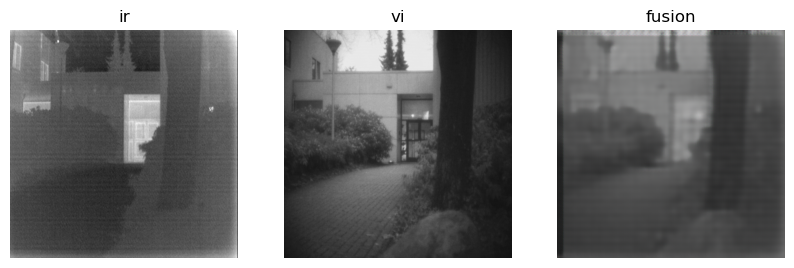

D_epoch_loss:1.3179807662963867,G_epoch_loss:1.128658652305603
Epoch: 1787 D_epoch_loss:1.3054256439208984,G_epoch_loss:1.1359753608703613
Epoch: 1788 D_epoch_loss:1.2992238998413086,G_epoch_loss:1.132463812828064
Epoch: 1789 D_epoch_loss:1.2951111793518066,G_epoch_loss:1.1163491010665894
Epoch: 1790 D_epoch_loss:1.3377140760421753,G_epoch_loss:1.1227989196777344
Epoch: 1791 D_epoch_loss:1.305579662322998,G_epoch_loss:1.1273066997528076
Epoch: 1792 D_epoch_loss:1.2872169017791748,G_epoch_loss:1.1348403692245483
Epoch: 1793 D_epoch_loss:1.3123009204864502,G_epoch_loss:1.1371541023254395
Epoch: 1794 D_epoch_loss:1.3152570724487305,G_epoch_loss:1.1312166452407837
Epoch: 1795 D_epoch_loss:1.3128712177276611,G_epoch_loss:1.1326112747192383
Epoch: 1796 D_epoch_loss:1.3105008602142334,G_epoch_loss:1.1361186504364014
Epoch: 1797 D_epoch_loss:1.3029680252075195,G_epoch_loss:1.1358978748321533
Epoch: 1798 D_epoch_loss:1.2900416851043701,G_epoch_loss:1.1690740585327148
Epoch: 1799 D_epoch_loss:1.

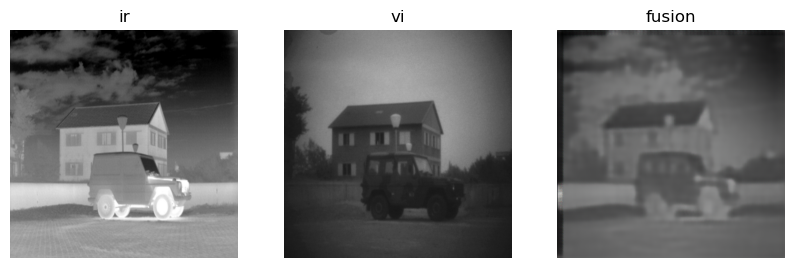

D_epoch_loss:1.312091588973999,G_epoch_loss:1.1208553314208984
Epoch: 1834 D_epoch_loss:1.3200963735580444,G_epoch_loss:1.14009690284729
Epoch: 1835 D_epoch_loss:1.2977910041809082,G_epoch_loss:1.1429601907730103
Epoch: 1836 D_epoch_loss:1.2760963439941406,G_epoch_loss:1.1388499736785889
Epoch: 1837 D_epoch_loss:1.3362400531768799,G_epoch_loss:1.1557469367980957
Epoch: 1838 D_epoch_loss:1.292959213256836,G_epoch_loss:1.0945746898651123
Epoch: 1839 D_epoch_loss:1.3055481910705566,G_epoch_loss:1.1301978826522827
Epoch: 1840 D_epoch_loss:1.3478405475616455,G_epoch_loss:1.1370337009429932
Epoch: 1841 D_epoch_loss:1.2808167934417725,G_epoch_loss:1.1142468452453613
Epoch: 1842 D_epoch_loss:1.3382072448730469,G_epoch_loss:1.1192631721496582
Epoch: 1843 D_epoch_loss:1.3116445541381836,G_epoch_loss:1.1267421245574951
Epoch: 1844 D_epoch_loss:1.2788410186767578,G_epoch_loss:1.15595543384552
Epoch: 1845 D_epoch_loss:1.3285095691680908,G_epoch_loss:1.094018816947937
Epoch: 1846 D_epoch_loss:1.3166

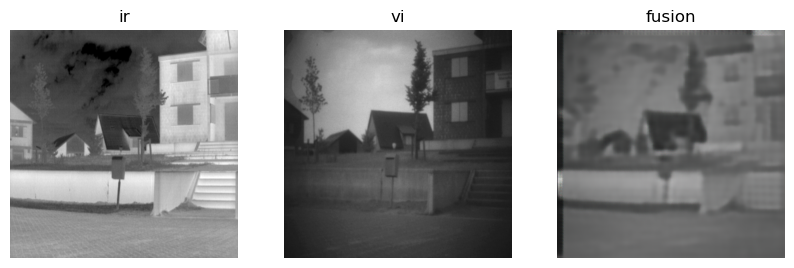

D_epoch_loss:1.3210835456848145,G_epoch_loss:1.1195534467697144
Epoch: 1881 D_epoch_loss:1.2708733081817627,G_epoch_loss:1.122190237045288
Epoch: 1882 D_epoch_loss:1.326328992843628,G_epoch_loss:1.127187967300415
Epoch: 1883 D_epoch_loss:1.2878081798553467,G_epoch_loss:1.106771469116211
Epoch: 1884 D_epoch_loss:1.3702480792999268,G_epoch_loss:1.0991144180297852
Epoch: 1885 D_epoch_loss:1.2942914962768555,G_epoch_loss:1.1220844984054565
Epoch: 1886 D_epoch_loss:1.2804584503173828,G_epoch_loss:1.1542344093322754
Epoch: 1887 D_epoch_loss:1.2673839330673218,G_epoch_loss:1.1206469535827637
Epoch: 1888 D_epoch_loss:1.3432573080062866,G_epoch_loss:1.1603902578353882
Epoch: 1889 D_epoch_loss:1.281880259513855,G_epoch_loss:1.1075140237808228
Epoch: 1890 D_epoch_loss:1.348451852798462,G_epoch_loss:1.1283596754074097
Epoch: 1891 D_epoch_loss:1.3259680271148682,G_epoch_loss:1.129390001296997
Epoch: 1892 D_epoch_loss:1.3206086158752441,G_epoch_loss:1.1692664623260498
Epoch: 1893 D_epoch_loss:1.2711

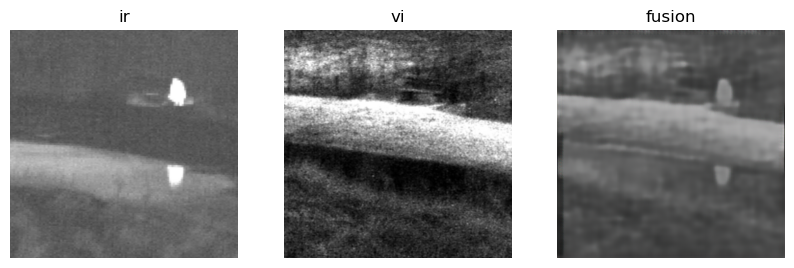

D_epoch_loss:1.338756799697876,G_epoch_loss:1.1236908435821533
Epoch: 1928 D_epoch_loss:1.2911102771759033,G_epoch_loss:1.1258388757705688
Epoch: 1929 D_epoch_loss:1.3050384521484375,G_epoch_loss:1.096337914466858
Epoch: 1930 D_epoch_loss:1.296077013015747,G_epoch_loss:1.1336753368377686
Epoch: 1931 D_epoch_loss:1.2367274761199951,G_epoch_loss:1.1107189655303955
Epoch: 1932 D_epoch_loss:1.3664076328277588,G_epoch_loss:1.1246585845947266
Epoch: 1933 D_epoch_loss:1.307561993598938,G_epoch_loss:1.1172466278076172
Epoch: 1934 D_epoch_loss:1.2540287971496582,G_epoch_loss:1.123417615890503
Epoch: 1935 D_epoch_loss:1.3020391464233398,G_epoch_loss:1.1098029613494873
Epoch: 1936 D_epoch_loss:1.362208366394043,G_epoch_loss:1.12090003490448
Epoch: 1937 D_epoch_loss:1.264967441558838,G_epoch_loss:1.1268430948257446
Epoch: 1938 D_epoch_loss:1.2868270874023438,G_epoch_loss:1.148431420326233
Epoch: 1939 D_epoch_loss:1.3250266313552856,G_epoch_loss:1.1465108394622803
Epoch: 1940 D_epoch_loss:1.2933828

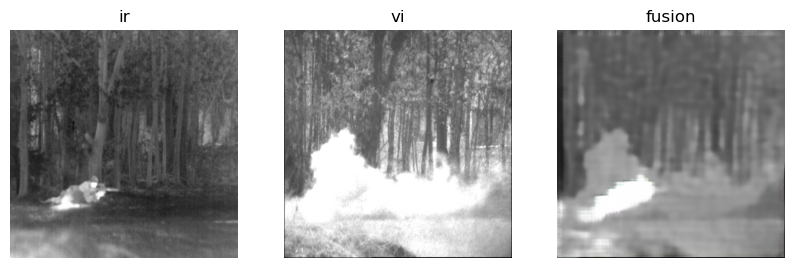

D_epoch_loss:1.3524986505508423,G_epoch_loss:1.1163201332092285
Epoch: 1975 D_epoch_loss:1.3187625408172607,G_epoch_loss:1.0896732807159424
Epoch: 1976 D_epoch_loss:1.361100196838379,G_epoch_loss:1.1154555082321167
Epoch: 1977 D_epoch_loss:1.2760471105575562,G_epoch_loss:1.1136239767074585
Epoch: 1978 D_epoch_loss:1.3416279554367065,G_epoch_loss:1.1266440153121948
Epoch: 1979 D_epoch_loss:1.308555245399475,G_epoch_loss:1.1642118692398071
Epoch: 1980 D_epoch_loss:1.2501190900802612,G_epoch_loss:1.126782774925232
Epoch: 1981 D_epoch_loss:1.3600363731384277,G_epoch_loss:1.1535357236862183
Epoch: 1982 D_epoch_loss:1.3048017024993896,G_epoch_loss:1.1663615703582764
Epoch: 1983 D_epoch_loss:1.3596230745315552,G_epoch_loss:1.153963327407837
Epoch: 1984 D_epoch_loss:1.3176071643829346,G_epoch_loss:1.1393588781356812
Epoch: 1985 D_epoch_loss:1.3091495037078857,G_epoch_loss:1.147702693939209
Epoch: 1986 D_epoch_loss:1.3154678344726562,G_epoch_loss:1.2065637111663818
Epoch: 1987 D_epoch_loss:1.33

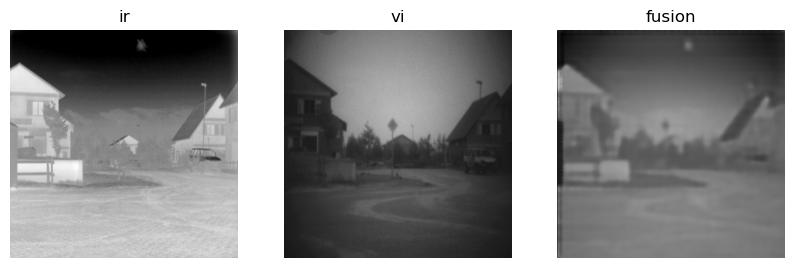

D_epoch_loss:1.293758749961853,G_epoch_loss:1.1136881113052368
Epoch: 2022 D_epoch_loss:1.3472604751586914,G_epoch_loss:1.1185612678527832
Epoch: 2023 D_epoch_loss:1.335741400718689,G_epoch_loss:1.1017670631408691
Epoch: 2024 D_epoch_loss:1.342621088027954,G_epoch_loss:1.103050708770752
Epoch: 2025 D_epoch_loss:1.3353735208511353,G_epoch_loss:1.158537745475769
Epoch: 2026 D_epoch_loss:1.340322732925415,G_epoch_loss:1.1732871532440186
Epoch: 2027 D_epoch_loss:1.399118185043335,G_epoch_loss:1.1656728982925415
Epoch: 2028 D_epoch_loss:1.2905129194259644,G_epoch_loss:1.166922926902771
Epoch: 2029 D_epoch_loss:1.3129048347473145,G_epoch_loss:1.1588352918624878
Epoch: 2030 D_epoch_loss:1.3348665237426758,G_epoch_loss:1.1533386707305908
Epoch: 2031 D_epoch_loss:1.3062211275100708,G_epoch_loss:1.1627117395401
Epoch: 2032 D_epoch_loss:1.2980868816375732,G_epoch_loss:1.1365976333618164
Epoch: 2033 D_epoch_loss:1.3226053714752197,G_epoch_loss:1.1518115997314453
Epoch: 2034 D_epoch_loss:1.33946156

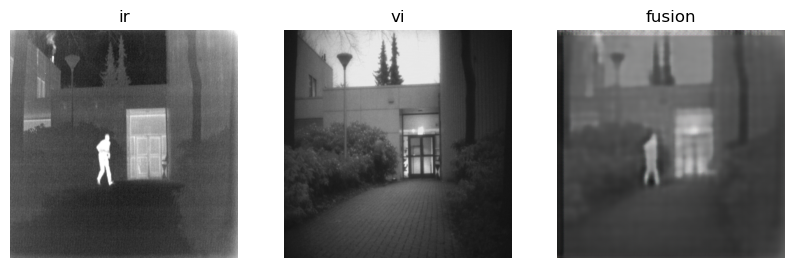

D_epoch_loss:1.3088533878326416,G_epoch_loss:1.1414117813110352
Epoch: 2069 D_epoch_loss:1.3251426219940186,G_epoch_loss:1.1387919187545776
Epoch: 2070 D_epoch_loss:1.3121695518493652,G_epoch_loss:1.128617525100708
Epoch: 2071 D_epoch_loss:1.2886378765106201,G_epoch_loss:1.0953388214111328
Epoch: 2072 D_epoch_loss:1.307417869567871,G_epoch_loss:1.1327247619628906
Epoch: 2073 D_epoch_loss:1.3111233711242676,G_epoch_loss:1.1211175918579102
Epoch: 2074 D_epoch_loss:1.3779213428497314,G_epoch_loss:1.118019938468933
Epoch: 2075 D_epoch_loss:1.3299304246902466,G_epoch_loss:1.167513132095337
Epoch: 2076 D_epoch_loss:1.3408540487289429,G_epoch_loss:1.1435225009918213
Epoch: 2077 D_epoch_loss:1.306358814239502,G_epoch_loss:1.1583151817321777
Epoch: 2078 D_epoch_loss:1.317387580871582,G_epoch_loss:1.142160415649414
Epoch: 2079 D_epoch_loss:1.346645712852478,G_epoch_loss:1.1260820627212524
Epoch: 2080 D_epoch_loss:1.3145194053649902,G_epoch_loss:1.1472257375717163
Epoch: 2081 D_epoch_loss:1.30192

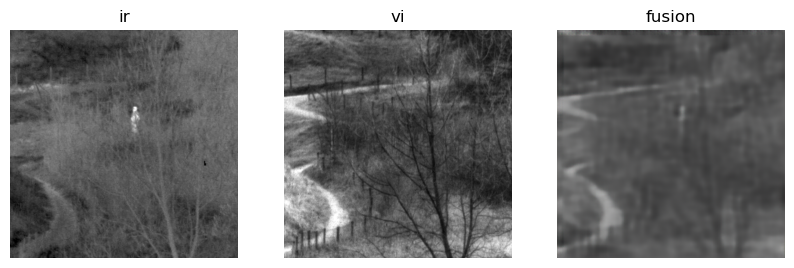

D_epoch_loss:1.3340455293655396,G_epoch_loss:1.1950932741165161
Epoch: 2116 D_epoch_loss:1.2649872303009033,G_epoch_loss:1.1161973476409912
Epoch: 2117 D_epoch_loss:1.3084487915039062,G_epoch_loss:1.1080230474472046
Epoch: 2118 D_epoch_loss:1.2980722188949585,G_epoch_loss:1.1306768655776978
Epoch: 2119 D_epoch_loss:1.3094902038574219,G_epoch_loss:1.1074239015579224
Epoch: 2120 D_epoch_loss:1.339339017868042,G_epoch_loss:1.1181073188781738
Epoch: 2121 D_epoch_loss:1.3200438022613525,G_epoch_loss:1.1659977436065674
Epoch: 2122 D_epoch_loss:1.3068363666534424,G_epoch_loss:1.117669939994812
Epoch: 2123 D_epoch_loss:1.3834807872772217,G_epoch_loss:1.1108771562576294
Epoch: 2124 D_epoch_loss:1.3087717294692993,G_epoch_loss:1.1667324304580688
Epoch: 2125 D_epoch_loss:1.2279973030090332,G_epoch_loss:1.1500710248947144
Epoch: 2126 D_epoch_loss:1.3641091585159302,G_epoch_loss:1.1740195751190186
Epoch: 2127 D_epoch_loss:1.292715072631836,G_epoch_loss:1.1224461793899536
Epoch: 2128 D_epoch_loss:1.

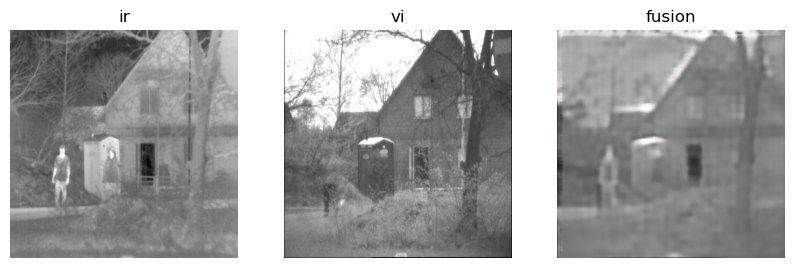

D_epoch_loss:1.335560917854309,G_epoch_loss:1.1240061521530151
Epoch: 2163 D_epoch_loss:1.3350473642349243,G_epoch_loss:1.1789382696151733
Epoch: 2164 D_epoch_loss:1.2617771625518799,G_epoch_loss:1.1715672016143799
Epoch: 2165 D_epoch_loss:1.2932711839675903,G_epoch_loss:1.1577765941619873
Epoch: 2166 D_epoch_loss:1.306999683380127,G_epoch_loss:1.1288955211639404
Epoch: 2167 D_epoch_loss:1.2887529134750366,G_epoch_loss:1.117018222808838
Epoch: 2168 D_epoch_loss:1.326765775680542,G_epoch_loss:1.1331331729888916
Epoch: 2169 D_epoch_loss:1.3090739250183105,G_epoch_loss:1.1164222955703735
Epoch: 2170 D_epoch_loss:1.338458776473999,G_epoch_loss:1.1746480464935303
Epoch: 2171 D_epoch_loss:1.2861230373382568,G_epoch_loss:1.170199990272522
Epoch: 2172 D_epoch_loss:1.3575539588928223,G_epoch_loss:1.137654423713684
Epoch: 2173 D_epoch_loss:1.2940235137939453,G_epoch_loss:1.1818245649337769
Epoch: 2174 D_epoch_loss:1.3095781803131104,G_epoch_loss:1.1658668518066406
Epoch: 2175 D_epoch_loss:1.2849

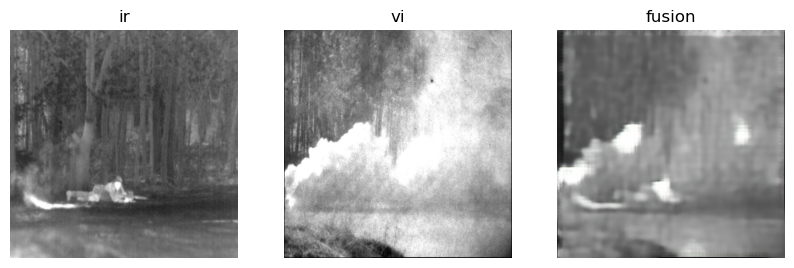

D_epoch_loss:1.3543435335159302,G_epoch_loss:1.1007333993911743
Epoch: 2210 D_epoch_loss:1.3040525913238525,G_epoch_loss:1.1868103742599487
Epoch: 2211 D_epoch_loss:1.309920310974121,G_epoch_loss:1.147312879562378
Epoch: 2212 D_epoch_loss:1.3378093242645264,G_epoch_loss:1.1647496223449707
Epoch: 2213 D_epoch_loss:1.3198070526123047,G_epoch_loss:1.1472773551940918
Epoch: 2214 D_epoch_loss:1.270648717880249,G_epoch_loss:1.1131831407546997
Epoch: 2215 D_epoch_loss:1.3060674667358398,G_epoch_loss:1.1239173412322998
Epoch: 2216 D_epoch_loss:1.303581953048706,G_epoch_loss:1.1572765111923218
Epoch: 2217 D_epoch_loss:1.295690894126892,G_epoch_loss:1.1487793922424316
Epoch: 2218 D_epoch_loss:1.3571088314056396,G_epoch_loss:1.1658097505569458
Epoch: 2219 D_epoch_loss:1.3443350791931152,G_epoch_loss:1.1740500926971436
Epoch: 2220 D_epoch_loss:1.3156824111938477,G_epoch_loss:1.1614227294921875
Epoch: 2221 D_epoch_loss:1.3304190635681152,G_epoch_loss:1.1446785926818848
Epoch: 2222 D_epoch_loss:1.32

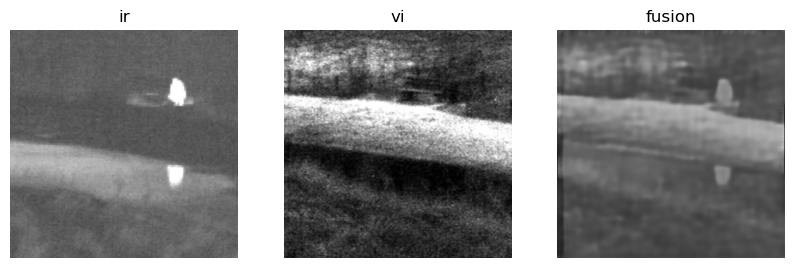

D_epoch_loss:1.2810642719268799,G_epoch_loss:1.1235531568527222
Epoch: 2257 D_epoch_loss:1.3463373184204102,G_epoch_loss:1.158443570137024
Epoch: 2258 D_epoch_loss:1.3111546039581299,G_epoch_loss:1.1248992681503296
Epoch: 2259 D_epoch_loss:1.3081727027893066,G_epoch_loss:1.1689541339874268
Epoch: 2260 D_epoch_loss:1.2644994258880615,G_epoch_loss:1.1231725215911865
Epoch: 2261 D_epoch_loss:1.302370548248291,G_epoch_loss:1.1564725637435913
Epoch: 2262 D_epoch_loss:1.3122563362121582,G_epoch_loss:1.1389484405517578
Epoch: 2263 D_epoch_loss:1.2711127996444702,G_epoch_loss:1.131861925125122
Epoch: 2264 D_epoch_loss:1.2761011123657227,G_epoch_loss:1.1447031497955322
Epoch: 2265 D_epoch_loss:1.283506155014038,G_epoch_loss:1.1144015789031982
Epoch: 2266 D_epoch_loss:1.2561222314834595,G_epoch_loss:1.154049038887024
Epoch: 2267 D_epoch_loss:1.372965693473816,G_epoch_loss:1.1279767751693726
Epoch: 2268 D_epoch_loss:1.3667349815368652,G_epoch_loss:1.1514167785644531
Epoch: 2269 D_epoch_loss:1.332

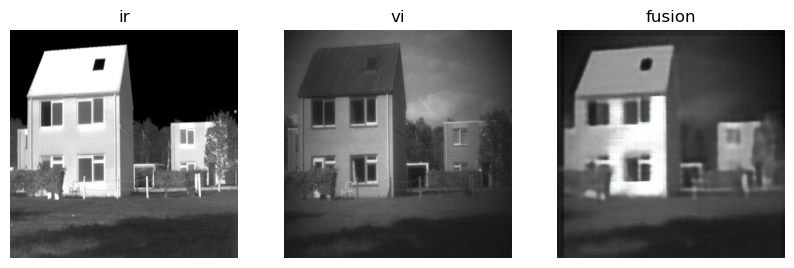

D_epoch_loss:1.3794175386428833,G_epoch_loss:1.182851791381836
Epoch: 2304 D_epoch_loss:1.298452615737915,G_epoch_loss:1.1611343622207642
Epoch: 2305 D_epoch_loss:1.2560770511627197,G_epoch_loss:1.11149001121521
Epoch: 2306 D_epoch_loss:1.3260116577148438,G_epoch_loss:1.145232081413269
Epoch: 2307 D_epoch_loss:1.3370251655578613,G_epoch_loss:1.1574969291687012
Epoch: 2308 D_epoch_loss:1.3056912422180176,G_epoch_loss:1.125441312789917
Epoch: 2309 D_epoch_loss:1.2936387062072754,G_epoch_loss:1.1401646137237549
Epoch: 2310 D_epoch_loss:1.2924580574035645,G_epoch_loss:1.1219978332519531
Epoch: 2311 D_epoch_loss:1.289785385131836,G_epoch_loss:1.124202013015747
Epoch: 2312 D_epoch_loss:1.325886607170105,G_epoch_loss:1.1479823589324951
Epoch: 2313 D_epoch_loss:1.3149888515472412,G_epoch_loss:1.1484472751617432
Epoch: 2314 D_epoch_loss:1.2948729991912842,G_epoch_loss:1.1469647884368896
Epoch: 2315 D_epoch_loss:1.2865455150604248,G_epoch_loss:1.11335289478302
Epoch: 2316 D_epoch_loss:1.30189275

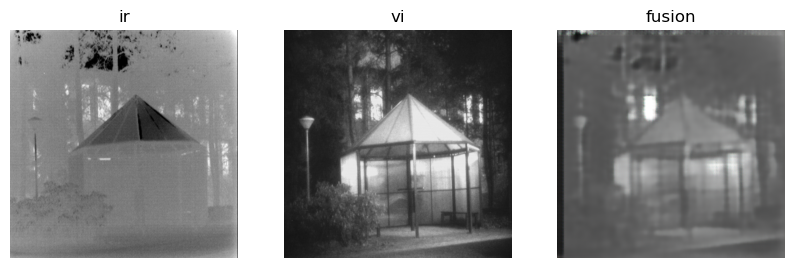

D_epoch_loss:1.3309879302978516,G_epoch_loss:1.180433750152588
Epoch: 2351 D_epoch_loss:1.2971470355987549,G_epoch_loss:1.1666454076766968
Epoch: 2352 D_epoch_loss:1.3391631841659546,G_epoch_loss:1.1290690898895264
Epoch: 2353 D_epoch_loss:1.289773941040039,G_epoch_loss:1.1417120695114136
Epoch: 2354 D_epoch_loss:1.3217155933380127,G_epoch_loss:1.157942533493042
Epoch: 2355 D_epoch_loss:1.2827105522155762,G_epoch_loss:1.1175181865692139
Epoch: 2356 D_epoch_loss:1.3499956130981445,G_epoch_loss:1.1385549306869507
Epoch: 2357 D_epoch_loss:1.315475344657898,G_epoch_loss:1.1795347929000854
Epoch: 2358 D_epoch_loss:1.3506736755371094,G_epoch_loss:1.1707348823547363
Epoch: 2359 D_epoch_loss:1.2725064754486084,G_epoch_loss:1.1838295459747314
Epoch: 2360 D_epoch_loss:1.3009271621704102,G_epoch_loss:1.1635938882827759
Epoch: 2361 D_epoch_loss:1.328415870666504,G_epoch_loss:1.161019206047058
Epoch: 2362 D_epoch_loss:1.3241628408432007,G_epoch_loss:1.1225645542144775
Epoch: 2363 D_epoch_loss:1.292

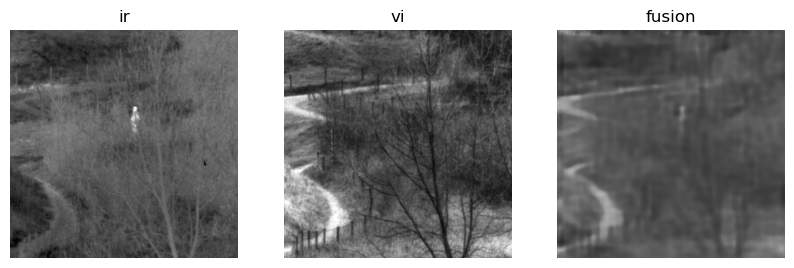

D_epoch_loss:1.273003101348877,G_epoch_loss:1.0854436159133911
Epoch: 2398 D_epoch_loss:1.3033932447433472,G_epoch_loss:1.1512959003448486
Epoch: 2399 D_epoch_loss:1.3150428533554077,G_epoch_loss:1.1389861106872559
Epoch: 2400 D_epoch_loss:1.3383407592773438,G_epoch_loss:1.1320680379867554
Epoch: 2401 D_epoch_loss:1.3290445804595947,G_epoch_loss:1.1860076189041138
Epoch: 2402 D_epoch_loss:1.365145206451416,G_epoch_loss:1.1592929363250732
Epoch: 2403 D_epoch_loss:1.264481782913208,G_epoch_loss:1.1287540197372437
Epoch: 2404 D_epoch_loss:1.3590741157531738,G_epoch_loss:1.090209722518921
Epoch: 2405 D_epoch_loss:1.2810555696487427,G_epoch_loss:1.0719339847564697
Epoch: 2406 D_epoch_loss:1.2986319065093994,G_epoch_loss:1.1369805335998535
Epoch: 2407 D_epoch_loss:1.278257966041565,G_epoch_loss:1.1300835609436035
Epoch: 2408 D_epoch_loss:1.2702844142913818,G_epoch_loss:1.136729121208191
Epoch: 2409 D_epoch_loss:1.289137840270996,G_epoch_loss:1.1536622047424316
Epoch: 2410 D_epoch_loss:1.3035

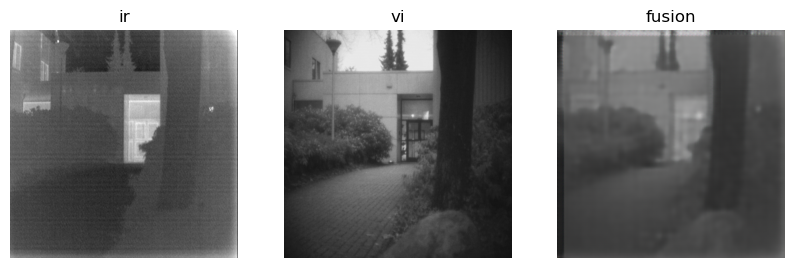

D_epoch_loss:1.2875956296920776,G_epoch_loss:1.1255377531051636
Epoch: 2445 D_epoch_loss:1.2309296131134033,G_epoch_loss:1.1258398294448853
Epoch: 2446 D_epoch_loss:1.273679256439209,G_epoch_loss:1.1232693195343018
Epoch: 2447 D_epoch_loss:1.4043571949005127,G_epoch_loss:1.132673740386963
Epoch: 2448 D_epoch_loss:1.3794660568237305,G_epoch_loss:1.22212553024292
Epoch: 2449 D_epoch_loss:1.264620065689087,G_epoch_loss:1.1676533222198486
Epoch: 2450 D_epoch_loss:1.309974193572998,G_epoch_loss:1.1412147283554077
Epoch: 2451 D_epoch_loss:1.3262031078338623,G_epoch_loss:1.1293420791625977
Epoch: 2452 D_epoch_loss:1.3515074253082275,G_epoch_loss:1.1509888172149658
Epoch: 2453 D_epoch_loss:1.288689136505127,G_epoch_loss:1.1784528493881226
Epoch: 2454 D_epoch_loss:1.2940127849578857,G_epoch_loss:1.119882345199585
Epoch: 2455 D_epoch_loss:1.3581531047821045,G_epoch_loss:1.1181930303573608
Epoch: 2456 D_epoch_loss:1.3839848041534424,G_epoch_loss:1.158022165298462
Epoch: 2457 D_epoch_loss:1.337783

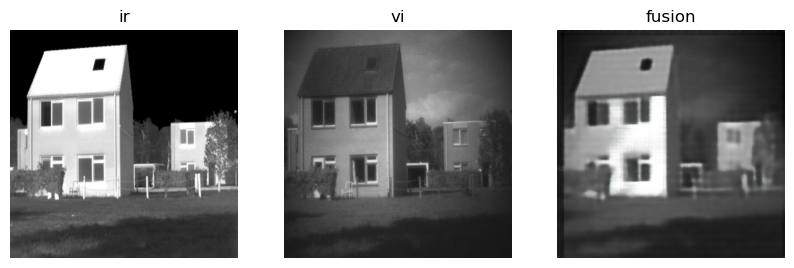

D_epoch_loss:1.3413609266281128,G_epoch_loss:1.1019132137298584
Epoch: 2492 D_epoch_loss:1.2784197330474854,G_epoch_loss:1.1520110368728638
Epoch: 2493 D_epoch_loss:1.2960541248321533,G_epoch_loss:1.1112034320831299
Epoch: 2494 D_epoch_loss:1.3224222660064697,G_epoch_loss:1.1594414710998535
Epoch: 2495 D_epoch_loss:1.291727900505066,G_epoch_loss:1.1471434831619263
Epoch: 2496 D_epoch_loss:1.2777841091156006,G_epoch_loss:1.1077301502227783
Epoch: 2497 D_epoch_loss:1.371385097503662,G_epoch_loss:1.1493662595748901
Epoch: 2498 D_epoch_loss:1.3095152378082275,G_epoch_loss:1.1385619640350342
Epoch: 2499 D_epoch_loss:1.3745512962341309,G_epoch_loss:1.144816517829895
Epoch: 2500 D_epoch_loss:1.32161545753479,G_epoch_loss:1.1467007398605347
Epoch: 2501 D_epoch_loss:1.291356086730957,G_epoch_loss:1.1358743906021118
Epoch: 2502 D_epoch_loss:1.2708284854888916,G_epoch_loss:1.1128673553466797
Epoch: 2503 D_epoch_loss:1.308590292930603,G_epoch_loss:1.1550744771957397
Epoch: 2504 D_epoch_loss:1.3225

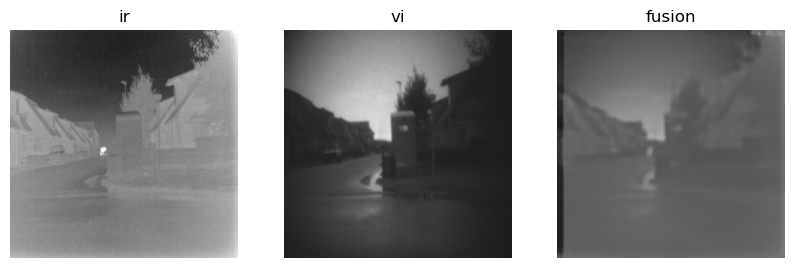

D_epoch_loss:1.2899539470672607,G_epoch_loss:1.1316325664520264
Epoch: 2539 D_epoch_loss:1.3311431407928467,G_epoch_loss:1.1596388816833496
Epoch: 2540 D_epoch_loss:1.2879290580749512,G_epoch_loss:1.1337988376617432
Epoch: 2541 D_epoch_loss:1.2737936973571777,G_epoch_loss:1.10862398147583
Epoch: 2542 D_epoch_loss:1.29275643825531,G_epoch_loss:1.1500563621520996
Epoch: 2543 D_epoch_loss:1.2705954313278198,G_epoch_loss:1.100075602531433
Epoch: 2544 D_epoch_loss:1.3188998699188232,G_epoch_loss:1.1180413961410522
Epoch: 2545 D_epoch_loss:1.3250608444213867,G_epoch_loss:1.1231584548950195
Epoch: 2546 D_epoch_loss:1.3137575387954712,G_epoch_loss:1.1681017875671387
Epoch: 2547 D_epoch_loss:1.2807682752609253,G_epoch_loss:1.1395448446273804
Epoch: 2548 D_epoch_loss:1.3139760494232178,G_epoch_loss:1.1307059526443481
Epoch: 2549 D_epoch_loss:1.3085275888442993,G_epoch_loss:1.1497000455856323
Epoch: 2550 D_epoch_loss:1.2913872003555298,G_epoch_loss:1.122670292854309
Epoch: 2551 D_epoch_loss:1.340

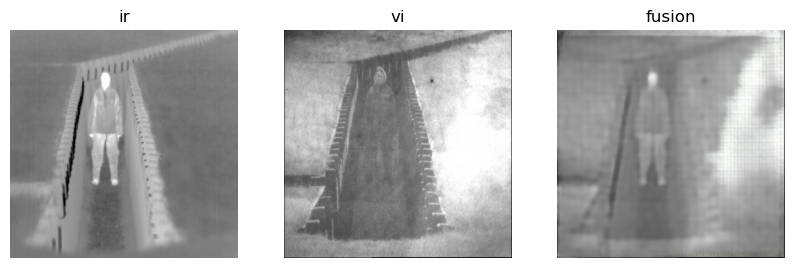

D_epoch_loss:1.2978785037994385,G_epoch_loss:1.138890266418457
Epoch: 2586 D_epoch_loss:1.3384102582931519,G_epoch_loss:1.115206003189087
Epoch: 2587 D_epoch_loss:1.279433012008667,G_epoch_loss:1.1244720220565796
Epoch: 2588 D_epoch_loss:1.3220165967941284,G_epoch_loss:1.1360371112823486
Epoch: 2589 D_epoch_loss:1.328207015991211,G_epoch_loss:1.1184171438217163
Epoch: 2590 D_epoch_loss:1.2922031879425049,G_epoch_loss:1.136581540107727
Epoch: 2591 D_epoch_loss:1.2875170707702637,G_epoch_loss:1.1495709419250488
Epoch: 2592 D_epoch_loss:1.3032569885253906,G_epoch_loss:1.1509969234466553
Epoch: 2593 D_epoch_loss:1.2955578565597534,G_epoch_loss:1.1205180883407593
Epoch: 2594 D_epoch_loss:1.259014368057251,G_epoch_loss:1.1149009466171265
Epoch: 2595 D_epoch_loss:1.2302932739257812,G_epoch_loss:1.1101793050765991
Epoch: 2596 D_epoch_loss:1.339688777923584,G_epoch_loss:1.0879794359207153
Epoch: 2597 D_epoch_loss:1.2049250602722168,G_epoch_loss:1.1061993837356567
Epoch: 2598 D_epoch_loss:1.3303

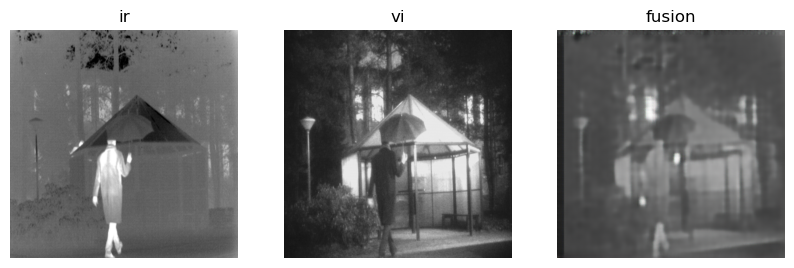

D_epoch_loss:1.3350396156311035,G_epoch_loss:1.1152342557907104
Epoch: 2633 D_epoch_loss:1.3191288709640503,G_epoch_loss:1.15062415599823
Epoch: 2634 D_epoch_loss:1.2955999374389648,G_epoch_loss:1.1034996509552002
Epoch: 2635 D_epoch_loss:1.3878962993621826,G_epoch_loss:1.1434547901153564
Epoch: 2636 D_epoch_loss:1.31136155128479,G_epoch_loss:1.1767845153808594
Epoch: 2637 D_epoch_loss:1.3010450601577759,G_epoch_loss:1.105377435684204
Epoch: 2638 D_epoch_loss:1.3245325088500977,G_epoch_loss:1.1190906763076782
Epoch: 2639 D_epoch_loss:1.2997158765792847,G_epoch_loss:1.0997850894927979
Epoch: 2640 D_epoch_loss:1.300926685333252,G_epoch_loss:1.1592432260513306
Epoch: 2641 D_epoch_loss:1.2396509647369385,G_epoch_loss:1.131999135017395
Epoch: 2642 D_epoch_loss:1.3213459253311157,G_epoch_loss:1.1534473896026611
Epoch: 2643 D_epoch_loss:1.3797986507415771,G_epoch_loss:1.1323896646499634
Epoch: 2644 D_epoch_loss:1.3005640506744385,G_epoch_loss:1.1451537609100342
Epoch: 2645 D_epoch_loss:1.2790

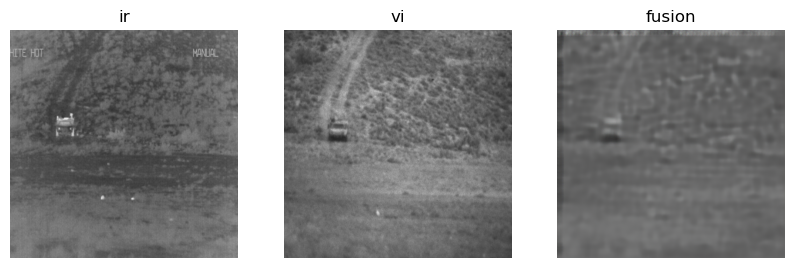

D_epoch_loss:1.3258224725723267,G_epoch_loss:1.1448533535003662
Epoch: 2680 D_epoch_loss:1.2941272258758545,G_epoch_loss:1.1253750324249268
Epoch: 2681 D_epoch_loss:1.3105182647705078,G_epoch_loss:1.1088690757751465
Epoch: 2682 D_epoch_loss:1.3525688648223877,G_epoch_loss:1.1523327827453613
Epoch: 2683 D_epoch_loss:1.3519412279129028,G_epoch_loss:1.1541824340820312
Epoch: 2684 D_epoch_loss:1.2794215679168701,G_epoch_loss:1.1262238025665283
Epoch: 2685 D_epoch_loss:1.277635931968689,G_epoch_loss:1.145911455154419
Epoch: 2686 D_epoch_loss:1.2988941669464111,G_epoch_loss:1.1667449474334717
Epoch: 2687 D_epoch_loss:1.328118920326233,G_epoch_loss:1.1195544004440308
Epoch: 2688 D_epoch_loss:1.3675732612609863,G_epoch_loss:1.172119140625
Epoch: 2689 D_epoch_loss:1.290693759918213,G_epoch_loss:1.1293326616287231
Epoch: 2690 D_epoch_loss:1.3432769775390625,G_epoch_loss:1.13338041305542
Epoch: 2691 D_epoch_loss:1.2744317054748535,G_epoch_loss:1.1138131618499756
Epoch: 2692 D_epoch_loss:1.3047251

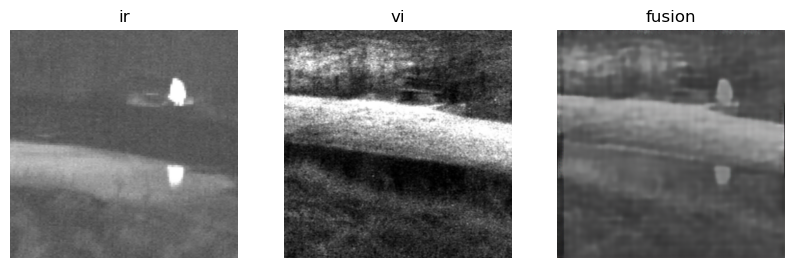

D_epoch_loss:1.3063433170318604,G_epoch_loss:1.1336227655410767
Epoch: 2727 D_epoch_loss:1.3242294788360596,G_epoch_loss:1.1864442825317383
Epoch: 2728 D_epoch_loss:1.3330249786376953,G_epoch_loss:1.1414318084716797
Epoch: 2729 D_epoch_loss:1.301802635192871,G_epoch_loss:1.1100726127624512
Epoch: 2730 D_epoch_loss:1.3048698902130127,G_epoch_loss:1.1189135313034058
Epoch: 2731 D_epoch_loss:1.311413288116455,G_epoch_loss:1.0972459316253662
Epoch: 2732 D_epoch_loss:1.2787584066390991,G_epoch_loss:1.1108040809631348
Epoch: 2733 D_epoch_loss:1.3152406215667725,G_epoch_loss:1.081349492073059
Epoch: 2734 D_epoch_loss:1.3268277645111084,G_epoch_loss:1.1127402782440186
Epoch: 2735 D_epoch_loss:1.3325855731964111,G_epoch_loss:1.0853852033615112
Epoch: 2736 D_epoch_loss:1.3396821022033691,G_epoch_loss:1.0830856561660767
Epoch: 2737 D_epoch_loss:1.3379075527191162,G_epoch_loss:1.1227104663848877
Epoch: 2738 D_epoch_loss:1.3200041055679321,G_epoch_loss:1.1863315105438232
Epoch: 2739 D_epoch_loss:1.

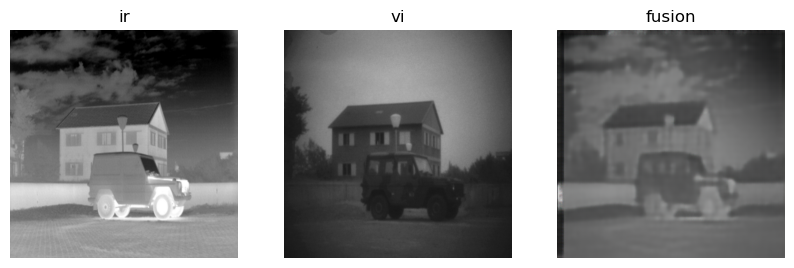

D_epoch_loss:1.2667372226715088,G_epoch_loss:1.1291838884353638
Epoch: 2774 D_epoch_loss:1.3236761093139648,G_epoch_loss:1.1179593801498413
Epoch: 2775 D_epoch_loss:1.3034403324127197,G_epoch_loss:1.1034820079803467
Epoch: 2776 D_epoch_loss:1.3386633396148682,G_epoch_loss:1.1600139141082764
Epoch: 2777 D_epoch_loss:1.2787322998046875,G_epoch_loss:1.1423006057739258
Epoch: 2778 D_epoch_loss:1.3265893459320068,G_epoch_loss:1.1194597482681274
Epoch: 2779 D_epoch_loss:1.2452938556671143,G_epoch_loss:1.1235803365707397
Epoch: 2780 D_epoch_loss:1.3206450939178467,G_epoch_loss:1.1483657360076904
Epoch: 2781 D_epoch_loss:1.3132351636886597,G_epoch_loss:1.145748496055603
Epoch: 2782 D_epoch_loss:1.2977797985076904,G_epoch_loss:1.1485798358917236
Epoch: 2783 D_epoch_loss:1.2832002639770508,G_epoch_loss:1.154505729675293
Epoch: 2784 D_epoch_loss:1.3368041515350342,G_epoch_loss:1.2271370887756348
Epoch: 2785 D_epoch_loss:1.3000555038452148,G_epoch_loss:1.1778651475906372
Epoch: 2786 D_epoch_loss:1

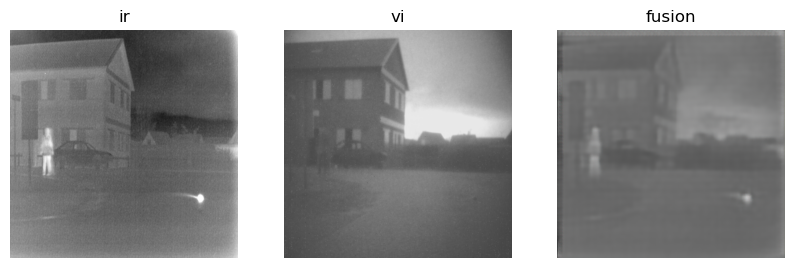

D_epoch_loss:1.3954272270202637,G_epoch_loss:1.1547197103500366
Epoch: 2821 D_epoch_loss:1.2603925466537476,G_epoch_loss:1.1058228015899658
Epoch: 2822 D_epoch_loss:1.3221187591552734,G_epoch_loss:1.1184673309326172
Epoch: 2823 D_epoch_loss:1.3178335428237915,G_epoch_loss:1.1258633136749268
Epoch: 2824 D_epoch_loss:1.3081049919128418,G_epoch_loss:1.1130845546722412
Epoch: 2825 D_epoch_loss:1.2899868488311768,G_epoch_loss:1.125209093093872
Epoch: 2826 D_epoch_loss:1.2903108596801758,G_epoch_loss:1.1399824619293213
Epoch: 2827 D_epoch_loss:1.284681797027588,G_epoch_loss:1.0889582633972168
Epoch: 2828 D_epoch_loss:1.2846941947937012,G_epoch_loss:1.1348475217819214
Epoch: 2829 D_epoch_loss:1.2860219478607178,G_epoch_loss:1.1529468297958374
Epoch: 2830 D_epoch_loss:1.3693984746932983,G_epoch_loss:1.138820767402649
Epoch: 2831 D_epoch_loss:1.2638771533966064,G_epoch_loss:1.1731927394866943
Epoch: 2832 D_epoch_loss:1.2675228118896484,G_epoch_loss:1.1974332332611084
Epoch: 2833 D_epoch_loss:1.

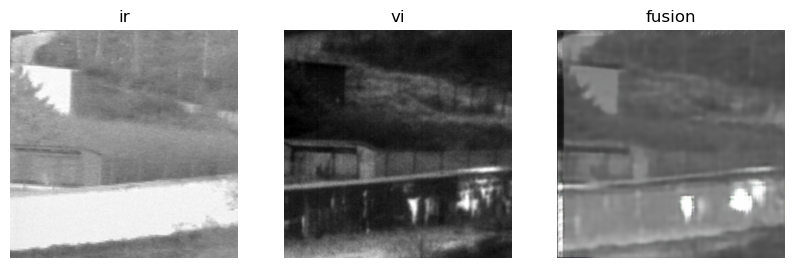

D_epoch_loss:1.2732336521148682,G_epoch_loss:1.1251323223114014
Epoch: 2868 D_epoch_loss:1.285834550857544,G_epoch_loss:1.1212859153747559
Epoch: 2869 D_epoch_loss:1.297048568725586,G_epoch_loss:1.1172821521759033
Epoch: 2870 D_epoch_loss:1.2597029209136963,G_epoch_loss:1.1639628410339355
Epoch: 2871 D_epoch_loss:1.3633794784545898,G_epoch_loss:1.1551101207733154
Epoch: 2872 D_epoch_loss:1.3531197309494019,G_epoch_loss:1.1968085765838623
Epoch: 2873 D_epoch_loss:1.314989686012268,G_epoch_loss:1.1758062839508057
Epoch: 2874 D_epoch_loss:1.3577768802642822,G_epoch_loss:1.1697896718978882
Epoch: 2875 D_epoch_loss:1.2684234380722046,G_epoch_loss:1.1487762928009033
Epoch: 2876 D_epoch_loss:1.2871158123016357,G_epoch_loss:1.1145042181015015
Epoch: 2877 D_epoch_loss:1.2954702377319336,G_epoch_loss:1.1491799354553223
Epoch: 2878 D_epoch_loss:1.324286699295044,G_epoch_loss:1.1185302734375
Epoch: 2879 D_epoch_loss:1.341489553451538,G_epoch_loss:1.1646833419799805
Epoch: 2880 D_epoch_loss:1.29385

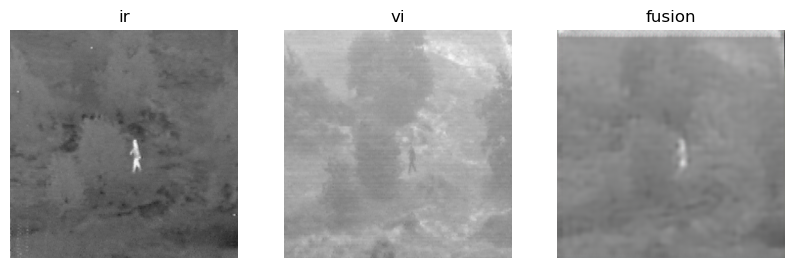

D_epoch_loss:1.3355810642242432,G_epoch_loss:1.1159616708755493
Epoch: 2915 D_epoch_loss:1.3065721988677979,G_epoch_loss:1.1252351999282837
Epoch: 2916 D_epoch_loss:1.2365059852600098,G_epoch_loss:1.09811532497406
Epoch: 2917 D_epoch_loss:1.273303508758545,G_epoch_loss:1.1193211078643799
Epoch: 2918 D_epoch_loss:1.3418381214141846,G_epoch_loss:1.1615618467330933
Epoch: 2919 D_epoch_loss:1.261248230934143,G_epoch_loss:1.1540509462356567
Epoch: 2920 D_epoch_loss:1.335564374923706,G_epoch_loss:1.133314847946167
Epoch: 2921 D_epoch_loss:1.2977346181869507,G_epoch_loss:1.1700953245162964
Epoch: 2922 D_epoch_loss:1.25863516330719,G_epoch_loss:1.1498692035675049
Epoch: 2923 D_epoch_loss:1.314392328262329,G_epoch_loss:1.178719401359558
Epoch: 2924 D_epoch_loss:1.3050956726074219,G_epoch_loss:1.1636143922805786
Epoch: 2925 D_epoch_loss:1.231436014175415,G_epoch_loss:1.1391515731811523
Epoch: 2926 D_epoch_loss:1.3011424541473389,G_epoch_loss:1.1542365550994873
Epoch: 2927 D_epoch_loss:1.26307392

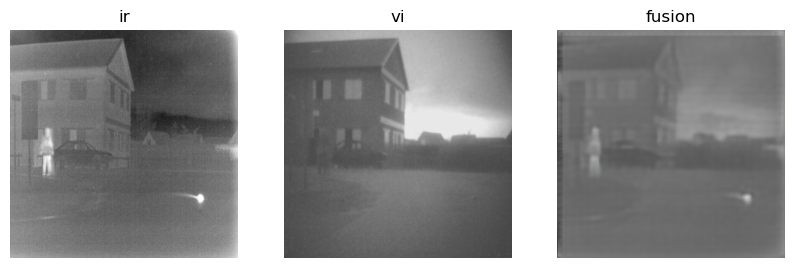

D_epoch_loss:1.303249478340149,G_epoch_loss:1.1192015409469604
Epoch: 2962 D_epoch_loss:1.331524133682251,G_epoch_loss:1.113021969795227
Epoch: 2963 D_epoch_loss:1.3351218700408936,G_epoch_loss:1.1735591888427734
Epoch: 2964 D_epoch_loss:1.3217227458953857,G_epoch_loss:1.1547096967697144
Epoch: 2965 D_epoch_loss:1.330402135848999,G_epoch_loss:1.1494510173797607
Epoch: 2966 D_epoch_loss:1.3392407894134521,G_epoch_loss:1.1594865322113037
Epoch: 2967 D_epoch_loss:1.320457935333252,G_epoch_loss:1.1328513622283936
Epoch: 2968 D_epoch_loss:1.3712108135223389,G_epoch_loss:1.1504939794540405
Epoch: 2969 D_epoch_loss:1.2829997539520264,G_epoch_loss:1.1387059688568115
Epoch: 2970 D_epoch_loss:1.339423418045044,G_epoch_loss:1.1455495357513428
Epoch: 2971 D_epoch_loss:1.3471922874450684,G_epoch_loss:1.1459463834762573
Epoch: 2972 D_epoch_loss:1.254693865776062,G_epoch_loss:1.0873966217041016
Epoch: 2973 D_epoch_loss:1.292907953262329,G_epoch_loss:1.10465407371521
Epoch: 2974 D_epoch_loss:1.3168481

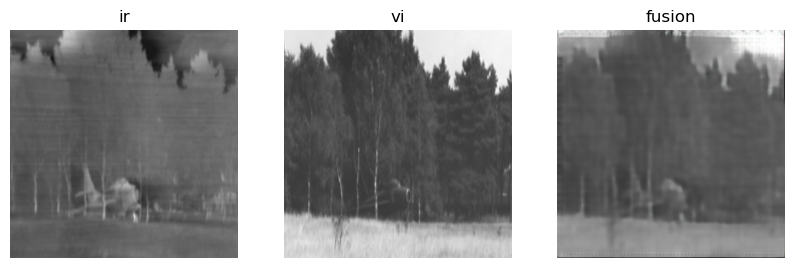

D_epoch_loss:1.2875844240188599,G_epoch_loss:1.1413007974624634
Epoch: 3009 D_epoch_loss:1.3142836093902588,G_epoch_loss:1.17226243019104
Epoch: 3010 D_epoch_loss:1.2889719009399414,G_epoch_loss:1.1161363124847412
Epoch: 3011 D_epoch_loss:1.354207992553711,G_epoch_loss:1.1298296451568604
Epoch: 3012 D_epoch_loss:1.323994517326355,G_epoch_loss:1.1709420680999756
Epoch: 3013 D_epoch_loss:1.284228801727295,G_epoch_loss:1.1044340133666992
Epoch: 3014 D_epoch_loss:1.3278193473815918,G_epoch_loss:1.1219382286071777
Epoch: 3015 D_epoch_loss:1.3340790271759033,G_epoch_loss:1.164440393447876
Epoch: 3016 D_epoch_loss:1.3006584644317627,G_epoch_loss:1.1625962257385254
Epoch: 3017 D_epoch_loss:1.3226382732391357,G_epoch_loss:1.1653430461883545
Epoch: 3018 D_epoch_loss:1.3331832885742188,G_epoch_loss:1.1459989547729492
Epoch: 3019 D_epoch_loss:1.2960041761398315,G_epoch_loss:1.1520600318908691
Epoch: 3020 D_epoch_loss:1.306996464729309,G_epoch_loss:1.1578526496887207
Epoch: 3021 D_epoch_loss:1.3307

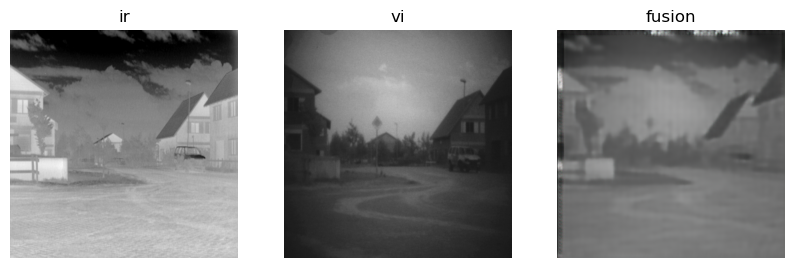

D_epoch_loss:1.2746567726135254,G_epoch_loss:1.1084407567977905
Epoch: 3056 D_epoch_loss:1.2804388999938965,G_epoch_loss:1.1043219566345215
Epoch: 3057 D_epoch_loss:1.2636048793792725,G_epoch_loss:1.1638922691345215
Epoch: 3058 D_epoch_loss:1.2599531412124634,G_epoch_loss:1.173844814300537
Epoch: 3059 D_epoch_loss:1.308349609375,G_epoch_loss:1.1417827606201172
Epoch: 3060 D_epoch_loss:1.3116674423217773,G_epoch_loss:1.1252554655075073
Epoch: 3061 D_epoch_loss:1.3141260147094727,G_epoch_loss:1.161674976348877
Epoch: 3062 D_epoch_loss:1.2632391452789307,G_epoch_loss:1.1154061555862427
Epoch: 3063 D_epoch_loss:1.325486183166504,G_epoch_loss:1.1074588298797607
Epoch: 3064 D_epoch_loss:1.2740659713745117,G_epoch_loss:1.143763542175293
Epoch: 3065 D_epoch_loss:1.2763264179229736,G_epoch_loss:1.153268814086914
Epoch: 3066 D_epoch_loss:1.277787446975708,G_epoch_loss:1.1641261577606201
Epoch: 3067 D_epoch_loss:1.309283971786499,G_epoch_loss:1.125096321105957
Epoch: 3068 D_epoch_loss:1.269662737

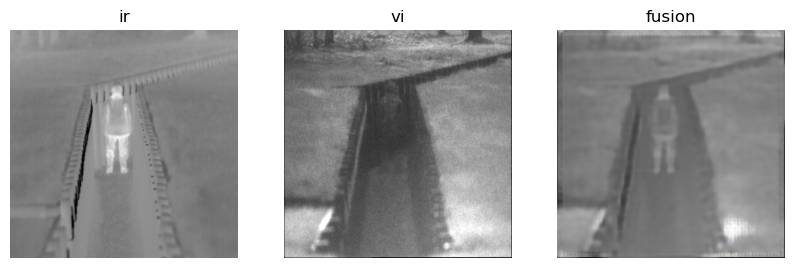

D_epoch_loss:1.3310046195983887,G_epoch_loss:1.133988857269287
Epoch: 3103 D_epoch_loss:1.2568786144256592,G_epoch_loss:1.161653995513916
Epoch: 3104 D_epoch_loss:1.2754464149475098,G_epoch_loss:1.1514313220977783
Epoch: 3105 D_epoch_loss:1.2915658950805664,G_epoch_loss:1.1051068305969238
Epoch: 3106 D_epoch_loss:1.2968637943267822,G_epoch_loss:1.1429228782653809
Epoch: 3107 D_epoch_loss:1.3519494533538818,G_epoch_loss:1.1455509662628174
Epoch: 3108 D_epoch_loss:1.270576000213623,G_epoch_loss:1.1250309944152832
Epoch: 3109 D_epoch_loss:1.2883901596069336,G_epoch_loss:1.135297179222107
Epoch: 3110 D_epoch_loss:1.3217315673828125,G_epoch_loss:1.1582151651382446
Epoch: 3111 D_epoch_loss:1.3564000129699707,G_epoch_loss:1.1438935995101929
Epoch: 3112 D_epoch_loss:1.3115370273590088,G_epoch_loss:1.1081699132919312
Epoch: 3113 D_epoch_loss:1.2925076484680176,G_epoch_loss:1.1456913948059082
Epoch: 3114 D_epoch_loss:1.2534682750701904,G_epoch_loss:1.130987286567688
Epoch: 3115 D_epoch_loss:1.35

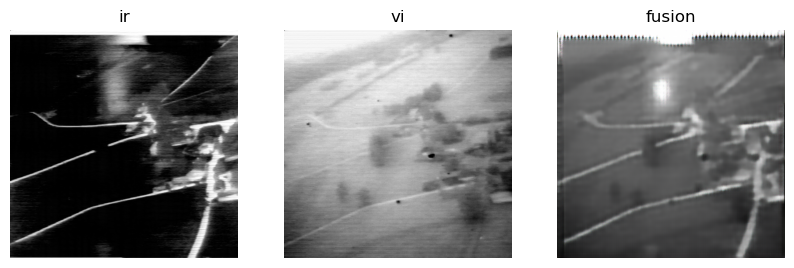

D_epoch_loss:1.2883272171020508,G_epoch_loss:1.1105848550796509
Epoch: 3150 D_epoch_loss:1.302354335784912,G_epoch_loss:1.112829327583313
Epoch: 3151 D_epoch_loss:1.3005118370056152,G_epoch_loss:1.1112028360366821
Epoch: 3152 D_epoch_loss:1.3613343238830566,G_epoch_loss:1.1337034702301025
Epoch: 3153 D_epoch_loss:1.313259243965149,G_epoch_loss:1.1113479137420654
Epoch: 3154 D_epoch_loss:1.3239110708236694,G_epoch_loss:1.16025972366333
Epoch: 3155 D_epoch_loss:1.3093609809875488,G_epoch_loss:1.1538656949996948
Epoch: 3156 D_epoch_loss:1.3245048522949219,G_epoch_loss:1.1300095319747925
Epoch: 3157 D_epoch_loss:1.3102099895477295,G_epoch_loss:1.1760733127593994
Epoch: 3158 D_epoch_loss:1.3500571250915527,G_epoch_loss:1.1403625011444092
Epoch: 3159 D_epoch_loss:1.2649363279342651,G_epoch_loss:1.1564385890960693
Epoch: 3160 D_epoch_loss:1.2883086204528809,G_epoch_loss:1.130739688873291
Epoch: 3161 D_epoch_loss:1.3221182823181152,G_epoch_loss:1.1181330680847168
Epoch: 3162 D_epoch_loss:1.331

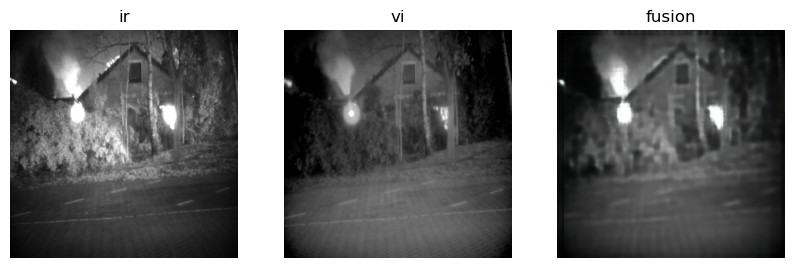

D_epoch_loss:1.2737019062042236,G_epoch_loss:1.1153771877288818
Epoch: 3197 D_epoch_loss:1.2468011379241943,G_epoch_loss:1.1182219982147217
Epoch: 3198 D_epoch_loss:1.2704118490219116,G_epoch_loss:1.1140072345733643
Epoch: 3199 D_epoch_loss:1.3088445663452148,G_epoch_loss:1.1360821723937988
Epoch: 3200 D_epoch_loss:1.2679768800735474,G_epoch_loss:1.110866904258728
Epoch: 3201 D_epoch_loss:1.2822597026824951,G_epoch_loss:1.1199063062667847
Epoch: 3202 D_epoch_loss:1.325608253479004,G_epoch_loss:1.1455559730529785
Epoch: 3203 D_epoch_loss:1.3689007759094238,G_epoch_loss:1.1412773132324219
Epoch: 3204 D_epoch_loss:1.3050336837768555,G_epoch_loss:1.1564306020736694
Epoch: 3205 D_epoch_loss:1.2981709241867065,G_epoch_loss:1.1284639835357666
Epoch: 3206 D_epoch_loss:1.3506872653961182,G_epoch_loss:1.131347894668579
Epoch: 3207 D_epoch_loss:1.2582663297653198,G_epoch_loss:1.169169306755066
Epoch: 3208 D_epoch_loss:1.321549415588379,G_epoch_loss:1.1632587909698486
Epoch: 3209 D_epoch_loss:1.30

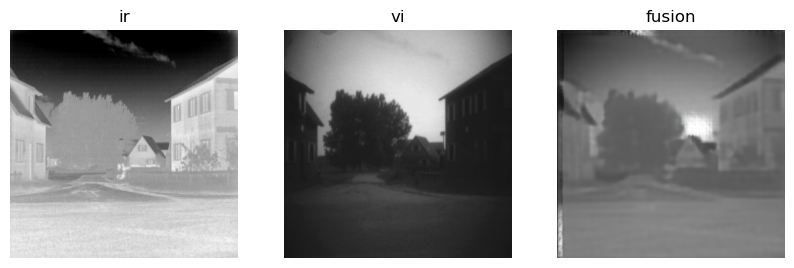

D_epoch_loss:1.3380415439605713,G_epoch_loss:1.1659092903137207
Epoch: 3244 D_epoch_loss:1.3229496479034424,G_epoch_loss:1.1356338262557983
Epoch: 3245 D_epoch_loss:1.2954156398773193,G_epoch_loss:1.1832818984985352
Epoch: 3246 D_epoch_loss:1.282717227935791,G_epoch_loss:1.1344387531280518
Epoch: 3247 D_epoch_loss:1.240934133529663,G_epoch_loss:1.1243412494659424
Epoch: 3248 D_epoch_loss:1.3087568283081055,G_epoch_loss:1.1532244682312012
Epoch: 3249 D_epoch_loss:1.311179280281067,G_epoch_loss:1.1177847385406494
Epoch: 3250 D_epoch_loss:1.2654495239257812,G_epoch_loss:1.1797574758529663
Epoch: 3251 D_epoch_loss:1.259351372718811,G_epoch_loss:1.1383373737335205
Epoch: 3252 D_epoch_loss:1.329521656036377,G_epoch_loss:1.127490758895874
Epoch: 3253 D_epoch_loss:1.334214448928833,G_epoch_loss:1.1247103214263916
Epoch: 3254 D_epoch_loss:1.2911102771759033,G_epoch_loss:1.1319962739944458
Epoch: 3255 D_epoch_loss:1.3330190181732178,G_epoch_loss:1.0974509716033936
Epoch: 3256 D_epoch_loss:1.2961

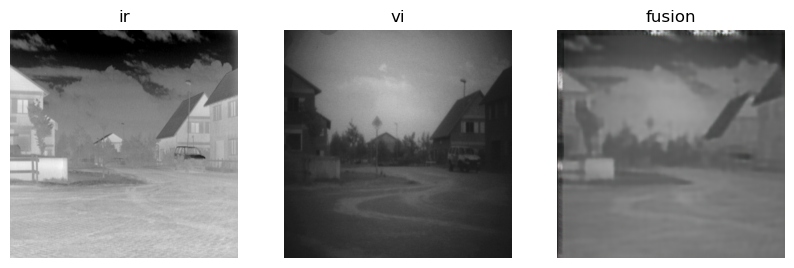

D_epoch_loss:1.3221832513809204,G_epoch_loss:1.1349248886108398
Epoch: 3291 D_epoch_loss:1.331510066986084,G_epoch_loss:1.1618330478668213
Epoch: 3292 D_epoch_loss:1.3142064809799194,G_epoch_loss:1.136633038520813
Epoch: 3293 D_epoch_loss:1.2919042110443115,G_epoch_loss:1.1603678464889526
Epoch: 3294 D_epoch_loss:1.2871661186218262,G_epoch_loss:1.1348117589950562
Epoch: 3295 D_epoch_loss:1.3411767482757568,G_epoch_loss:1.151716947555542
Epoch: 3296 D_epoch_loss:1.3514223098754883,G_epoch_loss:1.1673533916473389
Epoch: 3297 D_epoch_loss:1.3043417930603027,G_epoch_loss:1.1587989330291748
Epoch: 3298 D_epoch_loss:1.3146185874938965,G_epoch_loss:1.154174566268921
Epoch: 3299 D_epoch_loss:1.2357800006866455,G_epoch_loss:1.171562671661377
Epoch: 3300 D_epoch_loss:1.2762467861175537,G_epoch_loss:1.1688873767852783
Epoch: 3301 D_epoch_loss:1.341151237487793,G_epoch_loss:1.1555652618408203
Epoch: 3302 D_epoch_loss:1.3001881837844849,G_epoch_loss:1.1645591259002686
Epoch: 3303 D_epoch_loss:1.355

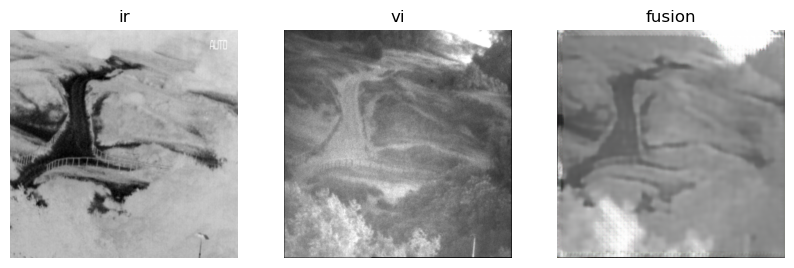

D_epoch_loss:1.3249001502990723,G_epoch_loss:1.1300981044769287
Epoch: 3338 D_epoch_loss:1.2627341747283936,G_epoch_loss:1.1258922815322876
Epoch: 3339 D_epoch_loss:1.3179333209991455,G_epoch_loss:1.1113698482513428
Epoch: 3340 D_epoch_loss:1.325825572013855,G_epoch_loss:1.1265376806259155
Epoch: 3341 D_epoch_loss:1.2982566356658936,G_epoch_loss:1.1625529527664185
Epoch: 3342 D_epoch_loss:1.288745403289795,G_epoch_loss:1.1560726165771484
Epoch: 3343 D_epoch_loss:1.3101294040679932,G_epoch_loss:1.1803865432739258
Epoch: 3344 D_epoch_loss:1.3102710247039795,G_epoch_loss:1.1530051231384277
Epoch: 3345 D_epoch_loss:1.347740888595581,G_epoch_loss:1.1667197942733765
Epoch: 3346 D_epoch_loss:1.2387959957122803,G_epoch_loss:1.123616099357605
Epoch: 3347 D_epoch_loss:1.3469538688659668,G_epoch_loss:1.0938907861709595
Epoch: 3348 D_epoch_loss:1.2751506567001343,G_epoch_loss:1.2011518478393555
Epoch: 3349 D_epoch_loss:1.2926143407821655,G_epoch_loss:1.1443567276000977
Epoch: 3350 D_epoch_loss:1.2

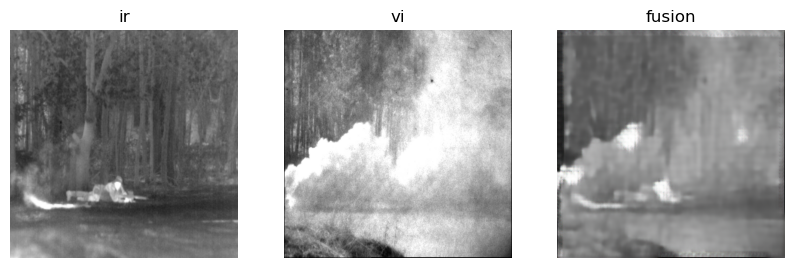

D_epoch_loss:1.3653768301010132,G_epoch_loss:1.1473219394683838
Epoch: 3385 D_epoch_loss:1.2807189226150513,G_epoch_loss:1.116640567779541
Epoch: 3386 D_epoch_loss:1.3073527812957764,G_epoch_loss:1.17889404296875
Epoch: 3387 D_epoch_loss:1.2709264755249023,G_epoch_loss:1.1528282165527344
Epoch: 3388 D_epoch_loss:1.25786292552948,G_epoch_loss:1.1510045528411865
Epoch: 3389 D_epoch_loss:1.3787095546722412,G_epoch_loss:1.139234185218811
Epoch: 3390 D_epoch_loss:1.348301649093628,G_epoch_loss:1.1264352798461914
Epoch: 3391 D_epoch_loss:1.3091446161270142,G_epoch_loss:1.1782498359680176
Epoch: 3392 D_epoch_loss:1.315143346786499,G_epoch_loss:1.1542590856552124
Epoch: 3393 D_epoch_loss:1.2762000560760498,G_epoch_loss:1.1386114358901978
Epoch: 3394 D_epoch_loss:1.3579554557800293,G_epoch_loss:1.1249403953552246
Epoch: 3395 D_epoch_loss:1.353574275970459,G_epoch_loss:1.1064608097076416
Epoch: 3396 D_epoch_loss:1.2750188112258911,G_epoch_loss:1.1283442974090576
Epoch: 3397 D_epoch_loss:1.269423

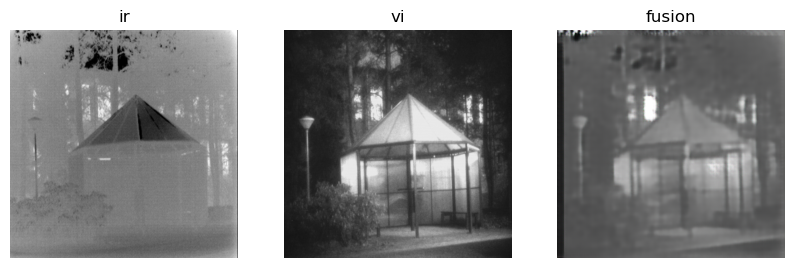

D_epoch_loss:1.311039924621582,G_epoch_loss:1.1008639335632324
Epoch: 3432 D_epoch_loss:1.3035459518432617,G_epoch_loss:1.108174443244934
Epoch: 3433 D_epoch_loss:1.3028053045272827,G_epoch_loss:1.1349074840545654
Epoch: 3434 D_epoch_loss:1.2726337909698486,G_epoch_loss:1.142730474472046
Epoch: 3435 D_epoch_loss:1.2782020568847656,G_epoch_loss:1.1489877700805664
Epoch: 3436 D_epoch_loss:1.2921826839447021,G_epoch_loss:1.1592168807983398
Epoch: 3437 D_epoch_loss:1.320836067199707,G_epoch_loss:1.0822879076004028
Epoch: 3438 D_epoch_loss:1.303598403930664,G_epoch_loss:1.1627366542816162
Epoch: 3439 D_epoch_loss:1.3476245403289795,G_epoch_loss:1.1530522108078003
Epoch: 3440 D_epoch_loss:1.3810803890228271,G_epoch_loss:1.1562137603759766
Epoch: 3441 D_epoch_loss:1.2934669256210327,G_epoch_loss:1.1485822200775146
Epoch: 3442 D_epoch_loss:1.296509027481079,G_epoch_loss:1.1413912773132324
Epoch: 3443 D_epoch_loss:1.3009607791900635,G_epoch_loss:1.1346832513809204
Epoch: 3444 D_epoch_loss:1.331

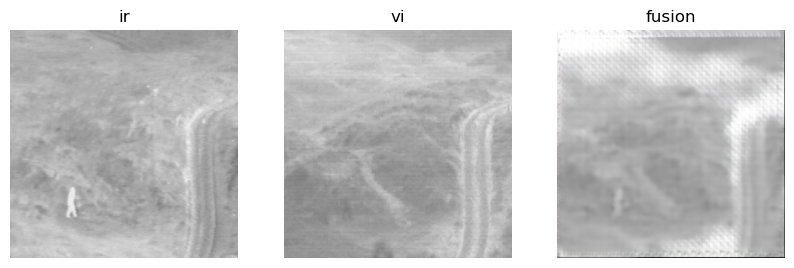

D_epoch_loss:1.3198647499084473,G_epoch_loss:1.1090214252471924
Epoch: 3479 D_epoch_loss:1.2980551719665527,G_epoch_loss:1.141270637512207
Epoch: 3480 D_epoch_loss:1.2370727062225342,G_epoch_loss:1.1210408210754395
Epoch: 3481 D_epoch_loss:1.3546133041381836,G_epoch_loss:1.1172518730163574
Epoch: 3482 D_epoch_loss:1.2748160362243652,G_epoch_loss:1.127899169921875
Epoch: 3483 D_epoch_loss:1.2862178087234497,G_epoch_loss:1.1354997158050537
Epoch: 3484 D_epoch_loss:1.2804372310638428,G_epoch_loss:1.116905689239502
Epoch: 3485 D_epoch_loss:1.2858874797821045,G_epoch_loss:1.1461001634597778
Epoch: 3486 D_epoch_loss:1.311009407043457,G_epoch_loss:1.1620113849639893
Epoch: 3487 D_epoch_loss:1.340008020401001,G_epoch_loss:1.1302032470703125
Epoch: 3488 D_epoch_loss:1.2853550910949707,G_epoch_loss:1.1184203624725342
Epoch: 3489 D_epoch_loss:1.2770651578903198,G_epoch_loss:1.140116810798645
Epoch: 3490 D_epoch_loss:1.332011342048645,G_epoch_loss:1.1211267709732056
Epoch: 3491 D_epoch_loss:1.3063

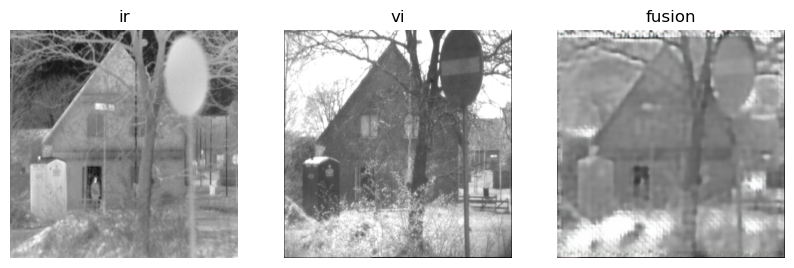

D_epoch_loss:1.3253962993621826,G_epoch_loss:1.164247751235962
Epoch: 3526 D_epoch_loss:1.2668204307556152,G_epoch_loss:1.1559404134750366
Epoch: 3527 D_epoch_loss:1.3083993196487427,G_epoch_loss:1.1335718631744385
Epoch: 3528 D_epoch_loss:1.2952853441238403,G_epoch_loss:1.111305832862854
Epoch: 3529 D_epoch_loss:1.3285880088806152,G_epoch_loss:1.1450073719024658
Epoch: 3530 D_epoch_loss:1.3099757432937622,G_epoch_loss:1.1162041425704956
Epoch: 3531 D_epoch_loss:1.2522351741790771,G_epoch_loss:1.1670246124267578
Epoch: 3532 D_epoch_loss:1.3607466220855713,G_epoch_loss:1.134277582168579
Epoch: 3533 D_epoch_loss:1.3521883487701416,G_epoch_loss:1.1161653995513916
Epoch: 3534 D_epoch_loss:1.2807717323303223,G_epoch_loss:1.1174343824386597
Epoch: 3535 D_epoch_loss:1.3451361656188965,G_epoch_loss:1.144588828086853
Epoch: 3536 D_epoch_loss:1.2963087558746338,G_epoch_loss:1.127743124961853
Epoch: 3537 D_epoch_loss:1.2787690162658691,G_epoch_loss:1.1779603958129883
Epoch: 3538 D_epoch_loss:1.31

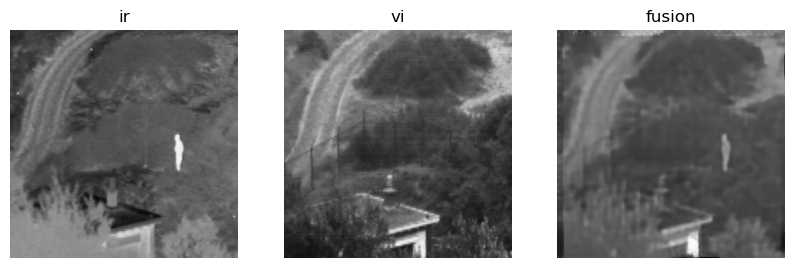

D_epoch_loss:1.3056612014770508,G_epoch_loss:1.1041193008422852
Epoch: 3573 D_epoch_loss:1.29604971408844,G_epoch_loss:1.1057946681976318
Epoch: 3574 D_epoch_loss:1.285240650177002,G_epoch_loss:1.140622854232788
Epoch: 3575 D_epoch_loss:1.2640725374221802,G_epoch_loss:1.1352769136428833
Epoch: 3576 D_epoch_loss:1.262155294418335,G_epoch_loss:1.134451150894165
Epoch: 3577 D_epoch_loss:1.310579538345337,G_epoch_loss:1.1414690017700195
Epoch: 3578 D_epoch_loss:1.2844771146774292,G_epoch_loss:1.162696123123169
Epoch: 3579 D_epoch_loss:1.3064699172973633,G_epoch_loss:1.1499418020248413
Epoch: 3580 D_epoch_loss:1.3228340148925781,G_epoch_loss:1.1579464673995972
Epoch: 3581 D_epoch_loss:1.3141155242919922,G_epoch_loss:1.1556658744812012
Epoch: 3582 D_epoch_loss:1.2687525749206543,G_epoch_loss:1.1718542575836182
Epoch: 3583 D_epoch_loss:1.2162716388702393,G_epoch_loss:1.133522868156433
Epoch: 3584 D_epoch_loss:1.3200284242630005,G_epoch_loss:1.1475856304168701
Epoch: 3585 D_epoch_loss:1.292853

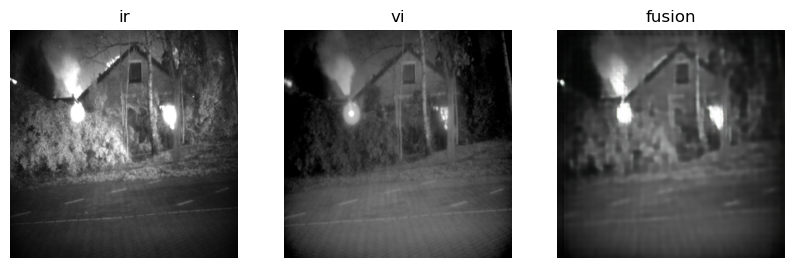

D_epoch_loss:1.2946932315826416,G_epoch_loss:1.1654731035232544
Epoch: 3620 D_epoch_loss:1.3048789501190186,G_epoch_loss:1.1042659282684326
Epoch: 3621 D_epoch_loss:1.2870187759399414,G_epoch_loss:1.138916254043579
Epoch: 3622 D_epoch_loss:1.2976313829421997,G_epoch_loss:1.1134288311004639
Epoch: 3623 D_epoch_loss:1.3227088451385498,G_epoch_loss:1.0853209495544434
Epoch: 3624 D_epoch_loss:1.3277838230133057,G_epoch_loss:1.1574757099151611
Epoch: 3625 D_epoch_loss:1.2777624130249023,G_epoch_loss:1.1278917789459229
Epoch: 3626 D_epoch_loss:1.3271307945251465,G_epoch_loss:1.1393582820892334
Epoch: 3627 D_epoch_loss:1.3382573127746582,G_epoch_loss:1.1561031341552734
Epoch: 3628 D_epoch_loss:1.29964280128479,G_epoch_loss:1.1373605728149414
Epoch: 3629 D_epoch_loss:1.2716052532196045,G_epoch_loss:1.122269630432129
Epoch: 3630 D_epoch_loss:1.3428995609283447,G_epoch_loss:1.1261955499649048
Epoch: 3631 D_epoch_loss:1.3140738010406494,G_epoch_loss:1.1167066097259521
Epoch: 3632 D_epoch_loss:1.3

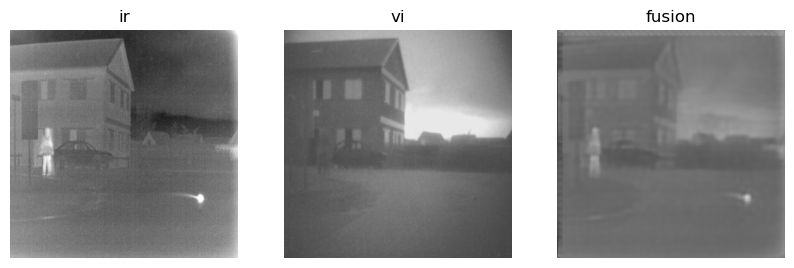

D_epoch_loss:1.304607629776001,G_epoch_loss:1.109384298324585
Epoch: 3667 D_epoch_loss:1.2776503562927246,G_epoch_loss:1.0964289903640747
Epoch: 3668 D_epoch_loss:1.3278274536132812,G_epoch_loss:1.1138966083526611
Epoch: 3669 D_epoch_loss:1.336780309677124,G_epoch_loss:1.1434862613677979
Epoch: 3670 D_epoch_loss:1.31592857837677,G_epoch_loss:1.1090490818023682
Epoch: 3671 D_epoch_loss:1.386319637298584,G_epoch_loss:1.1358104944229126
Epoch: 3672 D_epoch_loss:1.3505151271820068,G_epoch_loss:1.159677267074585
Epoch: 3673 D_epoch_loss:1.3230392932891846,G_epoch_loss:1.136635184288025
Epoch: 3674 D_epoch_loss:1.3324401378631592,G_epoch_loss:1.1637568473815918
Epoch: 3675 D_epoch_loss:1.3172225952148438,G_epoch_loss:1.1269454956054688
Epoch: 3676 D_epoch_loss:1.311827301979065,G_epoch_loss:1.1389086246490479
Epoch: 3677 D_epoch_loss:1.244358777999878,G_epoch_loss:1.1334505081176758
Epoch: 3678 D_epoch_loss:1.3122963905334473,G_epoch_loss:1.1082890033721924
Epoch: 3679 D_epoch_loss:1.3345708

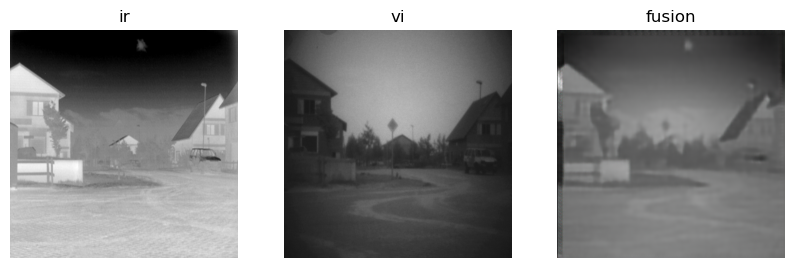

D_epoch_loss:1.364346981048584,G_epoch_loss:1.1470645666122437
Epoch: 3714 D_epoch_loss:1.248255968093872,G_epoch_loss:1.155897855758667
Epoch: 3715 D_epoch_loss:1.3061085939407349,G_epoch_loss:1.1270339488983154
Epoch: 3716 D_epoch_loss:1.3730626106262207,G_epoch_loss:1.1249234676361084
Epoch: 3717 D_epoch_loss:1.2938895225524902,G_epoch_loss:1.1760441064834595
Epoch: 3718 D_epoch_loss:1.3044829368591309,G_epoch_loss:1.1512197256088257
Epoch: 3719 D_epoch_loss:1.3483750820159912,G_epoch_loss:1.1526037454605103
Epoch: 3720 D_epoch_loss:1.276273250579834,G_epoch_loss:1.1452641487121582
Epoch: 3721 D_epoch_loss:1.3486047983169556,G_epoch_loss:1.085289478302002
Epoch: 3722 D_epoch_loss:1.2969512939453125,G_epoch_loss:1.1074845790863037
Epoch: 3723 D_epoch_loss:1.2807509899139404,G_epoch_loss:1.1801217794418335
Epoch: 3724 D_epoch_loss:1.298713207244873,G_epoch_loss:1.084132432937622
Epoch: 3725 D_epoch_loss:1.3176703453063965,G_epoch_loss:1.1402099132537842
Epoch: 3726 D_epoch_loss:1.2778

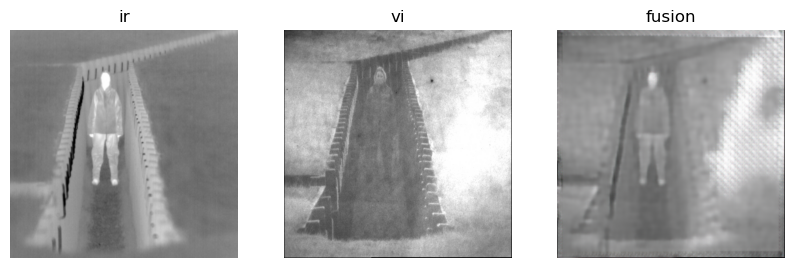

D_epoch_loss:1.313356876373291,G_epoch_loss:1.1480727195739746
Epoch: 3761 D_epoch_loss:1.3500444889068604,G_epoch_loss:1.1574448347091675
Epoch: 3762 D_epoch_loss:1.2640935182571411,G_epoch_loss:1.0994113683700562
Epoch: 3763 D_epoch_loss:1.3045127391815186,G_epoch_loss:1.130411148071289
Epoch: 3764 D_epoch_loss:1.2867369651794434,G_epoch_loss:1.1515978574752808
Epoch: 3765 D_epoch_loss:1.2845203876495361,G_epoch_loss:1.1480661630630493
Epoch: 3766 D_epoch_loss:1.2648602724075317,G_epoch_loss:1.1277166604995728
Epoch: 3767 D_epoch_loss:1.2937417030334473,G_epoch_loss:1.1398682594299316
Epoch: 3768 D_epoch_loss:1.363034725189209,G_epoch_loss:1.1287920475006104
Epoch: 3769 D_epoch_loss:1.3108426332473755,G_epoch_loss:1.1344704627990723
Epoch: 3770 D_epoch_loss:1.3000330924987793,G_epoch_loss:1.1277333498001099
Epoch: 3771 D_epoch_loss:1.3351573944091797,G_epoch_loss:1.1518110036849976
Epoch: 3772 D_epoch_loss:1.2733702659606934,G_epoch_loss:1.118301272392273
Epoch: 3773 D_epoch_loss:1.3

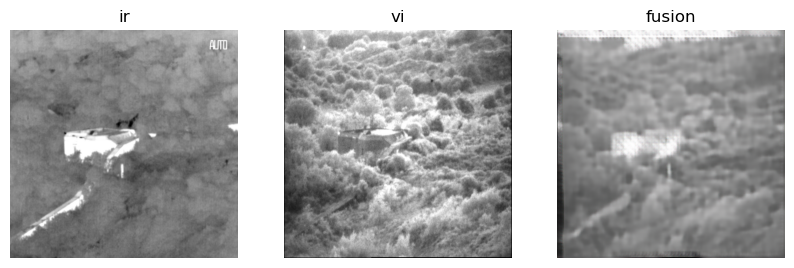

D_epoch_loss:1.3146041631698608,G_epoch_loss:1.1393086910247803
Epoch: 3808 D_epoch_loss:1.2822010517120361,G_epoch_loss:1.1324477195739746
Epoch: 3809 D_epoch_loss:1.2964394092559814,G_epoch_loss:1.1586618423461914
Epoch: 3810 D_epoch_loss:1.3224351406097412,G_epoch_loss:1.1502184867858887
Epoch: 3811 D_epoch_loss:1.2725756168365479,G_epoch_loss:1.1391184329986572
Epoch: 3812 D_epoch_loss:1.2966127395629883,G_epoch_loss:1.100569725036621
Epoch: 3813 D_epoch_loss:1.3236713409423828,G_epoch_loss:1.1552734375
Epoch: 3814 D_epoch_loss:1.283479928970337,G_epoch_loss:1.1283268928527832
Epoch: 3815 D_epoch_loss:1.2579841613769531,G_epoch_loss:1.1410049200057983
Epoch: 3816 D_epoch_loss:1.338008165359497,G_epoch_loss:1.0994889736175537
Epoch: 3817 D_epoch_loss:1.2953758239746094,G_epoch_loss:1.1268506050109863
Epoch: 3818 D_epoch_loss:1.3309916257858276,G_epoch_loss:1.141286849975586
Epoch: 3819 D_epoch_loss:1.299229383468628,G_epoch_loss:1.156059980392456
Epoch: 3820 D_epoch_loss:1.285201311

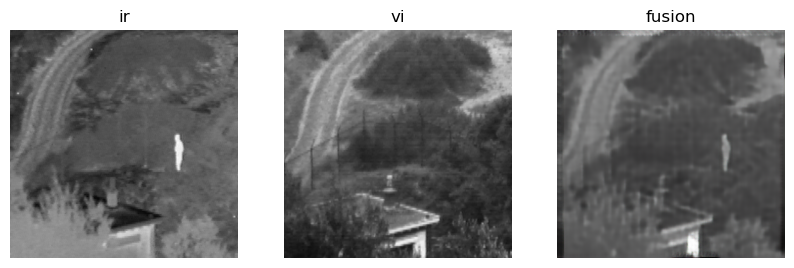

D_epoch_loss:1.3143128156661987,G_epoch_loss:1.1224558353424072
Epoch: 3855 D_epoch_loss:1.3147411346435547,G_epoch_loss:1.1111111640930176
Epoch: 3856 D_epoch_loss:1.305702805519104,G_epoch_loss:1.1483960151672363
Epoch: 3857 D_epoch_loss:1.3176560401916504,G_epoch_loss:1.165263056755066
Epoch: 3858 D_epoch_loss:1.285041332244873,G_epoch_loss:1.1490230560302734
Epoch: 3859 D_epoch_loss:1.3039448261260986,G_epoch_loss:1.137667179107666
Epoch: 3860 D_epoch_loss:1.2860814332962036,G_epoch_loss:1.2016117572784424
Epoch: 3861 D_epoch_loss:1.285426378250122,G_epoch_loss:1.1389250755310059
Epoch: 3862 D_epoch_loss:1.3166426420211792,G_epoch_loss:1.159900426864624
Epoch: 3863 D_epoch_loss:1.3514256477355957,G_epoch_loss:1.1460403203964233
Epoch: 3864 D_epoch_loss:1.299220323562622,G_epoch_loss:1.1047059297561646
Epoch: 3865 D_epoch_loss:1.281836748123169,G_epoch_loss:1.132192611694336
Epoch: 3866 D_epoch_loss:1.2573174238204956,G_epoch_loss:1.0874680280685425
Epoch: 3867 D_epoch_loss:1.300948

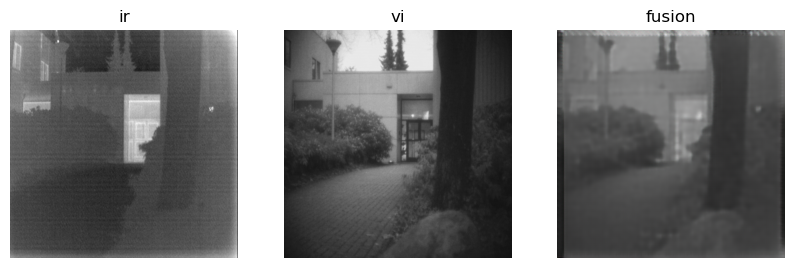

D_epoch_loss:1.3323523998260498,G_epoch_loss:1.184003233909607
Epoch: 3902 D_epoch_loss:1.265122652053833,G_epoch_loss:1.129831075668335
Epoch: 3903 D_epoch_loss:1.2974854707717896,G_epoch_loss:1.1010874509811401
Epoch: 3904 D_epoch_loss:1.3093273639678955,G_epoch_loss:1.1192916631698608
Epoch: 3905 D_epoch_loss:1.3056964874267578,G_epoch_loss:1.1759321689605713
Epoch: 3906 D_epoch_loss:1.3039450645446777,G_epoch_loss:1.1585652828216553
Epoch: 3907 D_epoch_loss:1.3172285556793213,G_epoch_loss:1.132051944732666
Epoch: 3908 D_epoch_loss:1.2971115112304688,G_epoch_loss:1.1325762271881104
Epoch: 3909 D_epoch_loss:1.2668776512145996,G_epoch_loss:1.0942763090133667
Epoch: 3910 D_epoch_loss:1.3299920558929443,G_epoch_loss:1.1026455163955688
Epoch: 3911 D_epoch_loss:1.3014702796936035,G_epoch_loss:1.142586350440979
Epoch: 3912 D_epoch_loss:1.3166441917419434,G_epoch_loss:1.176005482673645
Epoch: 3913 D_epoch_loss:1.3011322021484375,G_epoch_loss:1.153139591217041
Epoch: 3914 D_epoch_loss:1.3092

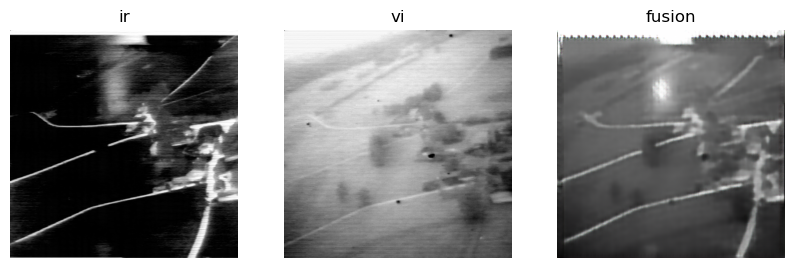

D_epoch_loss:1.3059666156768799,G_epoch_loss:1.1493583917617798
Epoch: 3949 D_epoch_loss:1.3056323528289795,G_epoch_loss:1.1089918613433838
Epoch: 3950 D_epoch_loss:1.3109159469604492,G_epoch_loss:1.1636842489242554
Epoch: 3951 D_epoch_loss:1.3655931949615479,G_epoch_loss:1.1402771472930908
Epoch: 3952 D_epoch_loss:1.2543946504592896,G_epoch_loss:1.1617791652679443
Epoch: 3953 D_epoch_loss:1.3764222860336304,G_epoch_loss:1.1327664852142334
Epoch: 3954 D_epoch_loss:1.320762276649475,G_epoch_loss:1.1193307638168335
Epoch: 3955 D_epoch_loss:1.3401966094970703,G_epoch_loss:1.14950430393219
Epoch: 3956 D_epoch_loss:1.2653887271881104,G_epoch_loss:1.182530403137207
Epoch: 3957 D_epoch_loss:1.295578956604004,G_epoch_loss:1.1640247106552124
Epoch: 3958 D_epoch_loss:1.2917429208755493,G_epoch_loss:1.113790512084961
Epoch: 3959 D_epoch_loss:1.3256809711456299,G_epoch_loss:1.1030666828155518
Epoch: 3960 D_epoch_loss:1.248750925064087,G_epoch_loss:1.1544389724731445
Epoch: 3961 D_epoch_loss:1.2895

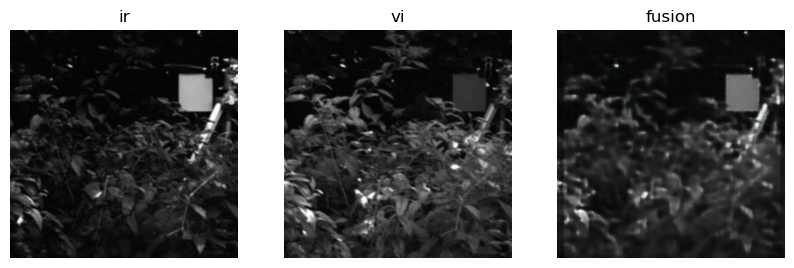

D_epoch_loss:1.324125051498413,G_epoch_loss:1.1311659812927246
Epoch: 3996 D_epoch_loss:1.2993836402893066,G_epoch_loss:1.1296989917755127
Epoch: 3997 D_epoch_loss:1.3378474712371826,G_epoch_loss:1.1607880592346191
Epoch: 3998 D_epoch_loss:1.3104866743087769,G_epoch_loss:1.1067627668380737
Epoch: 3999 D_epoch_loss:1.281015157699585,G_epoch_loss:1.1193463802337646
Epoch: 4000 D_epoch_loss:1.322782278060913,G_epoch_loss:1.1371055841445923
Epoch: 4001 D_epoch_loss:1.2970324754714966,G_epoch_loss:1.1371675729751587
Epoch: 4002 D_epoch_loss:1.3001694679260254,G_epoch_loss:1.1092932224273682
Epoch: 4003 D_epoch_loss:1.2602565288543701,G_epoch_loss:1.147454857826233
Epoch: 4004 D_epoch_loss:1.3310625553131104,G_epoch_loss:1.1345324516296387
Epoch: 4005 D_epoch_loss:1.3088515996932983,G_epoch_loss:1.1503043174743652
Epoch: 4006 D_epoch_loss:1.320768117904663,G_epoch_loss:1.1428207159042358
Epoch: 4007 D_epoch_loss:1.3123515844345093,G_epoch_loss:1.1287338733673096
Epoch: 4008 D_epoch_loss:1.31

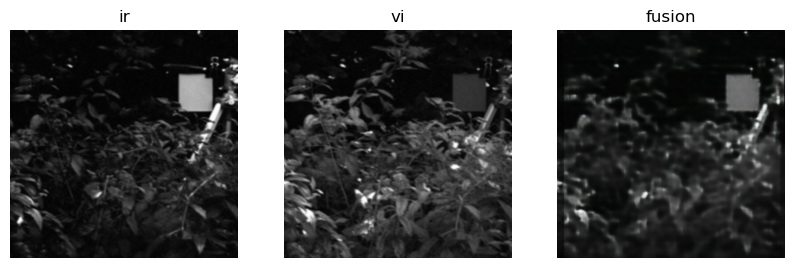

D_epoch_loss:1.3471448421478271,G_epoch_loss:1.1697914600372314
Epoch: 4043 D_epoch_loss:1.3573659658432007,G_epoch_loss:1.122457504272461
Epoch: 4044 D_epoch_loss:1.3019424676895142,G_epoch_loss:1.0955802202224731
Epoch: 4045 D_epoch_loss:1.3285895586013794,G_epoch_loss:1.136909008026123
Epoch: 4046 D_epoch_loss:1.338348627090454,G_epoch_loss:1.099531888961792
Epoch: 4047 D_epoch_loss:1.3533987998962402,G_epoch_loss:1.1525049209594727
Epoch: 4048 D_epoch_loss:1.3167246580123901,G_epoch_loss:1.1230340003967285
Epoch: 4049 D_epoch_loss:1.2840182781219482,G_epoch_loss:1.1285873651504517
Epoch: 4050 D_epoch_loss:1.3194388151168823,G_epoch_loss:1.1119951009750366
Epoch: 4051 D_epoch_loss:1.274437665939331,G_epoch_loss:1.1100842952728271
Epoch: 4052 D_epoch_loss:1.2578849792480469,G_epoch_loss:1.144568920135498
Epoch: 4053 D_epoch_loss:1.2792506217956543,G_epoch_loss:1.1561923027038574
Epoch: 4054 D_epoch_loss:1.315730094909668,G_epoch_loss:1.1002283096313477
Epoch: 4055 D_epoch_loss:1.3180

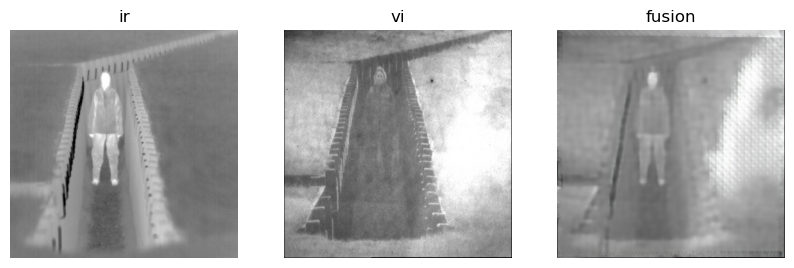

D_epoch_loss:1.3069052696228027,G_epoch_loss:1.1771678924560547
Epoch: 4090 D_epoch_loss:1.2997972965240479,G_epoch_loss:1.1293361186981201
Epoch: 4091 D_epoch_loss:1.2845968008041382,G_epoch_loss:1.1545239686965942
Epoch: 4092 D_epoch_loss:1.2291793823242188,G_epoch_loss:1.1330163478851318
Epoch: 4093 D_epoch_loss:1.261784553527832,G_epoch_loss:1.1408815383911133
Epoch: 4094 D_epoch_loss:1.276288390159607,G_epoch_loss:1.1691535711288452
Epoch: 4095 D_epoch_loss:1.2838680744171143,G_epoch_loss:1.1348280906677246
Epoch: 4096 D_epoch_loss:1.313441276550293,G_epoch_loss:1.1452851295471191
Epoch: 4097 D_epoch_loss:1.2778427600860596,G_epoch_loss:1.149588704109192
Epoch: 4098 D_epoch_loss:1.3122886419296265,G_epoch_loss:1.1288995742797852
Epoch: 4099 D_epoch_loss:1.3198561668395996,G_epoch_loss:1.1727195978164673
Epoch: 4100 D_epoch_loss:1.3263132572174072,G_epoch_loss:1.1612039804458618
Epoch: 4101 D_epoch_loss:1.345755934715271,G_epoch_loss:1.1780974864959717
Epoch: 4102 D_epoch_loss:1.25

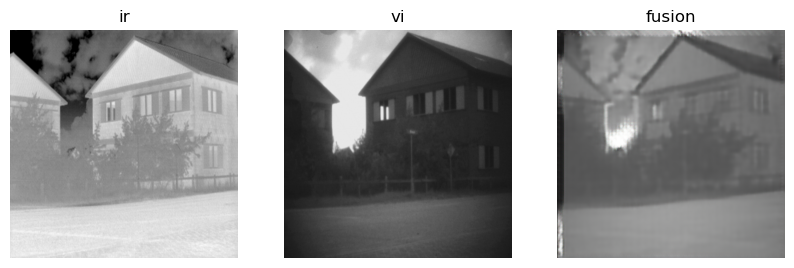

D_epoch_loss:1.3776944875717163,G_epoch_loss:1.1416096687316895
Epoch: 4137 D_epoch_loss:1.295323371887207,G_epoch_loss:1.1970698833465576
Epoch: 4138 D_epoch_loss:1.3245189189910889,G_epoch_loss:1.1141563653945923
Epoch: 4139 D_epoch_loss:1.3272931575775146,G_epoch_loss:1.16696035861969
Epoch: 4140 D_epoch_loss:1.3044195175170898,G_epoch_loss:1.1342185735702515
Epoch: 4141 D_epoch_loss:1.3057395219802856,G_epoch_loss:1.1270966529846191
Epoch: 4142 D_epoch_loss:1.3461201190948486,G_epoch_loss:1.128553032875061
Epoch: 4143 D_epoch_loss:1.3817453384399414,G_epoch_loss:1.1332826614379883
Epoch: 4144 D_epoch_loss:1.312669038772583,G_epoch_loss:1.156166672706604
Epoch: 4145 D_epoch_loss:1.3196110725402832,G_epoch_loss:1.17933988571167
Epoch: 4146 D_epoch_loss:1.3032166957855225,G_epoch_loss:1.148546814918518
Epoch: 4147 D_epoch_loss:1.2850158214569092,G_epoch_loss:1.1147828102111816
Epoch: 4148 D_epoch_loss:1.3362900018692017,G_epoch_loss:1.1801872253417969
Epoch: 4149 D_epoch_loss:1.272491

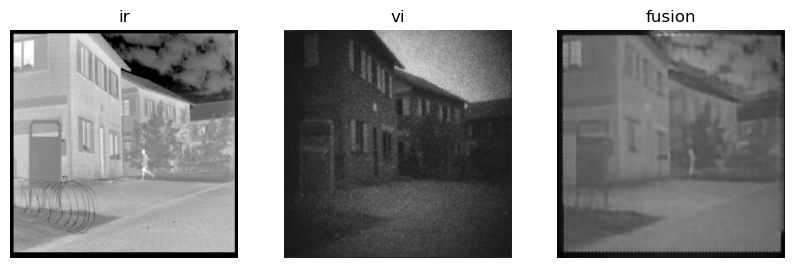

D_epoch_loss:1.248265027999878,G_epoch_loss:1.1005322933197021
Epoch: 4184 D_epoch_loss:1.3249207735061646,G_epoch_loss:1.1197280883789062
Epoch: 4185 D_epoch_loss:1.2893264293670654,G_epoch_loss:1.1239196062088013
Epoch: 4186 D_epoch_loss:1.2688770294189453,G_epoch_loss:1.140261173248291
Epoch: 4187 D_epoch_loss:1.3296877145767212,G_epoch_loss:1.1392300128936768
Epoch: 4188 D_epoch_loss:1.343733310699463,G_epoch_loss:1.1617176532745361
Epoch: 4189 D_epoch_loss:1.3489625453948975,G_epoch_loss:1.1543470621109009
Epoch: 4190 D_epoch_loss:1.2856762409210205,G_epoch_loss:1.1527390480041504
Epoch: 4191 D_epoch_loss:1.3130042552947998,G_epoch_loss:1.1295613050460815
Epoch: 4192 D_epoch_loss:1.3495728969573975,G_epoch_loss:1.1450135707855225
Epoch: 4193 D_epoch_loss:1.2980067729949951,G_epoch_loss:1.1268936395645142
Epoch: 4194 D_epoch_loss:1.3373029232025146,G_epoch_loss:1.1278694868087769
Epoch: 4195 D_epoch_loss:1.2801790237426758,G_epoch_loss:1.1237338781356812
Epoch: 4196 D_epoch_loss:1.

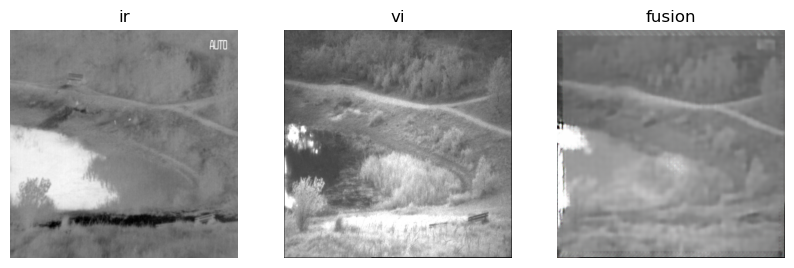

D_epoch_loss:1.2956864833831787,G_epoch_loss:1.1798115968704224
Epoch: 4231 D_epoch_loss:1.3094801902770996,G_epoch_loss:1.1091495752334595
Epoch: 4232 D_epoch_loss:1.3223903179168701,G_epoch_loss:1.1158524751663208
Epoch: 4233 D_epoch_loss:1.2933320999145508,G_epoch_loss:1.129197120666504
Epoch: 4234 D_epoch_loss:1.2924163341522217,G_epoch_loss:1.1457860469818115
Epoch: 4235 D_epoch_loss:1.3094675540924072,G_epoch_loss:1.1133005619049072
Epoch: 4236 D_epoch_loss:1.3046393394470215,G_epoch_loss:1.1061807870864868
Epoch: 4237 D_epoch_loss:1.2852199077606201,G_epoch_loss:1.1611156463623047
Epoch: 4238 D_epoch_loss:1.3067874908447266,G_epoch_loss:1.1214489936828613
Epoch: 4239 D_epoch_loss:1.32667875289917,G_epoch_loss:1.128220796585083
Epoch: 4240 D_epoch_loss:1.2716867923736572,G_epoch_loss:1.0783019065856934
Epoch: 4241 D_epoch_loss:1.4031190872192383,G_epoch_loss:1.0910730361938477
Epoch: 4242 D_epoch_loss:1.2791531085968018,G_epoch_loss:1.1195261478424072
Epoch: 4243 D_epoch_loss:1.3

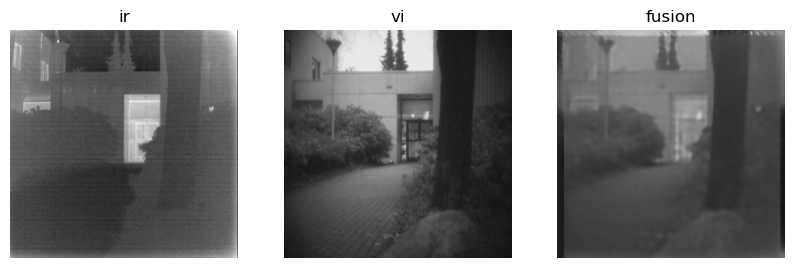

D_epoch_loss:1.3369890451431274,G_epoch_loss:1.159474492073059
Epoch: 4278 D_epoch_loss:1.3138548135757446,G_epoch_loss:1.1548800468444824
Epoch: 4279 D_epoch_loss:1.272953748703003,G_epoch_loss:1.1326254606246948
Epoch: 4280 D_epoch_loss:1.243597388267517,G_epoch_loss:1.1021032333374023
Epoch: 4281 D_epoch_loss:1.27618408203125,G_epoch_loss:1.1417537927627563
Epoch: 4282 D_epoch_loss:1.2594008445739746,G_epoch_loss:1.1523821353912354
Epoch: 4283 D_epoch_loss:1.3339548110961914,G_epoch_loss:1.1716960668563843
Epoch: 4284 D_epoch_loss:1.310655117034912,G_epoch_loss:1.1230456829071045
Epoch: 4285 D_epoch_loss:1.3060486316680908,G_epoch_loss:1.149465560913086
Epoch: 4286 D_epoch_loss:1.2477693557739258,G_epoch_loss:1.162166714668274
Epoch: 4287 D_epoch_loss:1.361905574798584,G_epoch_loss:1.1959929466247559
Epoch: 4288 D_epoch_loss:1.3234963417053223,G_epoch_loss:1.1939668655395508
Epoch: 4289 D_epoch_loss:1.315020203590393,G_epoch_loss:1.1779314279556274
Epoch: 4290 D_epoch_loss:1.3214954

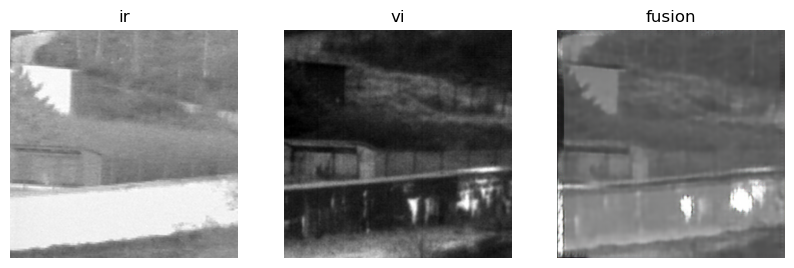

D_epoch_loss:1.408862829208374,G_epoch_loss:1.105425477027893
Epoch: 4325 D_epoch_loss:1.3668005466461182,G_epoch_loss:1.1385000944137573
Epoch: 4326 D_epoch_loss:1.3445429801940918,G_epoch_loss:1.1365633010864258
Epoch: 4327 D_epoch_loss:1.2751655578613281,G_epoch_loss:1.1625609397888184
Epoch: 4328 D_epoch_loss:1.3479052782058716,G_epoch_loss:1.1274621486663818
Epoch: 4329 D_epoch_loss:1.2467334270477295,G_epoch_loss:1.1554745435714722
Epoch: 4330 D_epoch_loss:1.2847710847854614,G_epoch_loss:1.1587625741958618
Epoch: 4331 D_epoch_loss:1.2876107692718506,G_epoch_loss:1.1468944549560547
Epoch: 4332 D_epoch_loss:1.3329328298568726,G_epoch_loss:1.1571030616760254
Epoch: 4333 D_epoch_loss:1.3246084451675415,G_epoch_loss:1.1139689683914185
Epoch: 4334 D_epoch_loss:1.2953226566314697,G_epoch_loss:1.145873785018921
Epoch: 4335 D_epoch_loss:1.3843796253204346,G_epoch_loss:1.1446409225463867
Epoch: 4336 D_epoch_loss:1.2997030019760132,G_epoch_loss:1.1507220268249512
Epoch: 4337 D_epoch_loss:1.

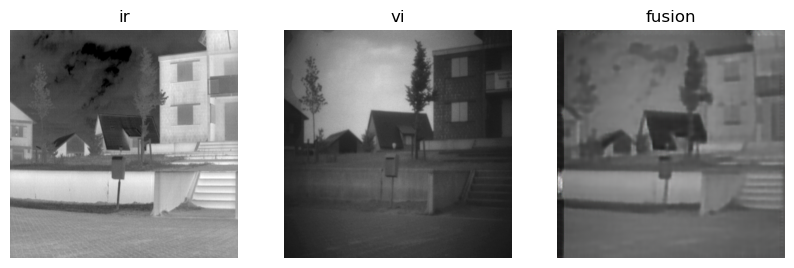

D_epoch_loss:1.301429033279419,G_epoch_loss:1.157520055770874
Epoch: 4372 D_epoch_loss:1.2758312225341797,G_epoch_loss:1.1619658470153809
Epoch: 4373 D_epoch_loss:1.3012380599975586,G_epoch_loss:1.122317910194397
Epoch: 4374 D_epoch_loss:1.2840906381607056,G_epoch_loss:1.1195952892303467
Epoch: 4375 D_epoch_loss:1.2985479831695557,G_epoch_loss:1.1515347957611084
Epoch: 4376 D_epoch_loss:1.3040316104888916,G_epoch_loss:1.1761879920959473
Epoch: 4377 D_epoch_loss:1.2812904119491577,G_epoch_loss:1.130326509475708
Epoch: 4378 D_epoch_loss:1.2854667901992798,G_epoch_loss:1.143587350845337
Epoch: 4379 D_epoch_loss:1.3312664031982422,G_epoch_loss:1.1098308563232422
Epoch: 4380 D_epoch_loss:1.2942748069763184,G_epoch_loss:1.1298494338989258
Epoch: 4381 D_epoch_loss:1.320125937461853,G_epoch_loss:1.1454362869262695
Epoch: 4382 D_epoch_loss:1.3167893886566162,G_epoch_loss:1.1544281244277954
Epoch: 4383 D_epoch_loss:1.2990291118621826,G_epoch_loss:1.1350946426391602
Epoch: 4384 D_epoch_loss:1.279

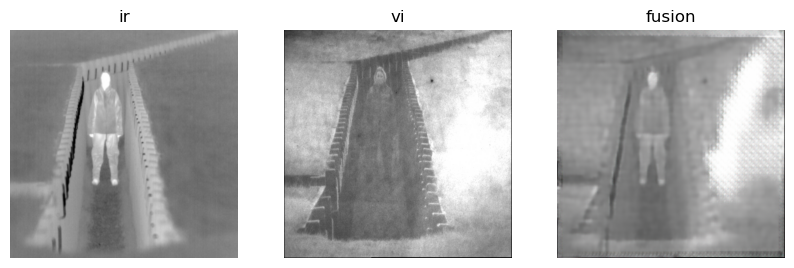

D_epoch_loss:1.3303029537200928,G_epoch_loss:1.1003811359405518
Epoch: 4419 D_epoch_loss:1.2796967029571533,G_epoch_loss:1.1266937255859375
Epoch: 4420 D_epoch_loss:1.2660714387893677,G_epoch_loss:1.0937013626098633
Epoch: 4421 D_epoch_loss:1.254103422164917,G_epoch_loss:1.137061357498169
Epoch: 4422 D_epoch_loss:1.2912323474884033,G_epoch_loss:1.1340299844741821
Epoch: 4423 D_epoch_loss:1.2996927499771118,G_epoch_loss:1.1587097644805908
Epoch: 4424 D_epoch_loss:1.3081727027893066,G_epoch_loss:1.1226065158843994
Epoch: 4425 D_epoch_loss:1.3098607063293457,G_epoch_loss:1.0999526977539062
Epoch: 4426 D_epoch_loss:1.3176064491271973,G_epoch_loss:1.11701238155365
Epoch: 4427 D_epoch_loss:1.3704766035079956,G_epoch_loss:1.1114165782928467
Epoch: 4428 D_epoch_loss:1.3333714008331299,G_epoch_loss:1.1262296438217163
Epoch: 4429 D_epoch_loss:1.2624938488006592,G_epoch_loss:1.192867398262024
Epoch: 4430 D_epoch_loss:1.265950322151184,G_epoch_loss:1.1126856803894043
Epoch: 4431 D_epoch_loss:1.302

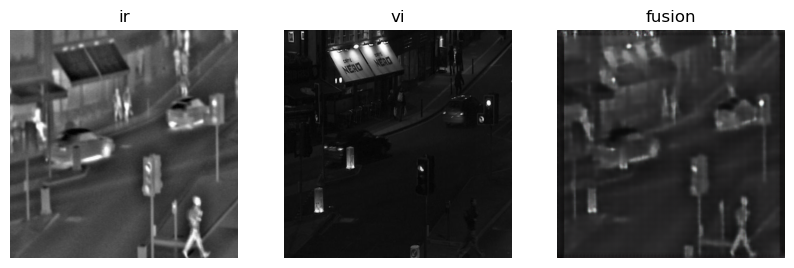

D_epoch_loss:1.3398264646530151,G_epoch_loss:1.1369762420654297
Epoch: 4466 D_epoch_loss:1.2791199684143066,G_epoch_loss:1.1550424098968506
Epoch: 4467 D_epoch_loss:1.2875890731811523,G_epoch_loss:1.1380864381790161
Epoch: 4468 D_epoch_loss:1.2938289642333984,G_epoch_loss:1.1205426454544067
Epoch: 4469 D_epoch_loss:1.3287681341171265,G_epoch_loss:1.1669493913650513
Epoch: 4470 D_epoch_loss:1.3033931255340576,G_epoch_loss:1.1153603792190552
Epoch: 4471 D_epoch_loss:1.3307318687438965,G_epoch_loss:1.1475355625152588
Epoch: 4472 D_epoch_loss:1.3074545860290527,G_epoch_loss:1.1530582904815674
Epoch: 4473 D_epoch_loss:1.3381952047348022,G_epoch_loss:1.1585410833358765
Epoch: 4474 D_epoch_loss:1.349956750869751,G_epoch_loss:1.1860671043395996
Epoch: 4475 D_epoch_loss:1.3234970569610596,G_epoch_loss:1.1579594612121582
Epoch: 4476 D_epoch_loss:1.2909680604934692,G_epoch_loss:1.1648716926574707
Epoch: 4477 D_epoch_loss:1.3069441318511963,G_epoch_loss:1.1798293590545654
Epoch: 4478 D_epoch_loss:

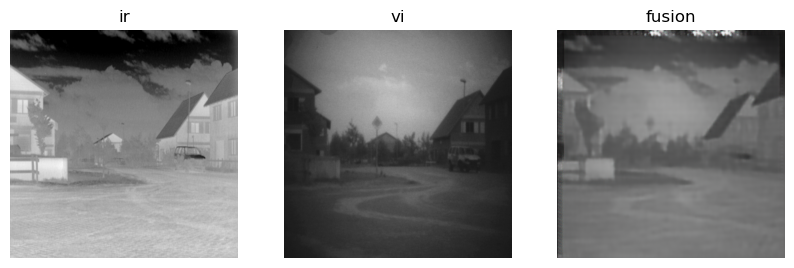

D_epoch_loss:1.2964880466461182,G_epoch_loss:1.1378326416015625
Epoch: 4513 D_epoch_loss:1.2870209217071533,G_epoch_loss:1.1011459827423096
Epoch: 4514 D_epoch_loss:1.3507518768310547,G_epoch_loss:1.1129183769226074
Epoch: 4515 D_epoch_loss:1.2836048603057861,G_epoch_loss:1.1340839862823486
Epoch: 4516 D_epoch_loss:1.2626621723175049,G_epoch_loss:1.1333434581756592
Epoch: 4517 D_epoch_loss:1.3176779747009277,G_epoch_loss:1.1432256698608398
Epoch: 4518 D_epoch_loss:1.3236521482467651,G_epoch_loss:1.1767263412475586
Epoch: 4519 D_epoch_loss:1.3921234607696533,G_epoch_loss:1.1578011512756348
Epoch: 4520 D_epoch_loss:1.2864508628845215,G_epoch_loss:1.1121222972869873
Epoch: 4521 D_epoch_loss:1.2925779819488525,G_epoch_loss:1.1090452671051025
Epoch: 4522 D_epoch_loss:1.3269498348236084,G_epoch_loss:1.1402897834777832
Epoch: 4523 D_epoch_loss:1.3032231330871582,G_epoch_loss:1.1311603784561157
Epoch: 4524 D_epoch_loss:1.2750217914581299,G_epoch_loss:1.1547948122024536
Epoch: 4525 D_epoch_loss

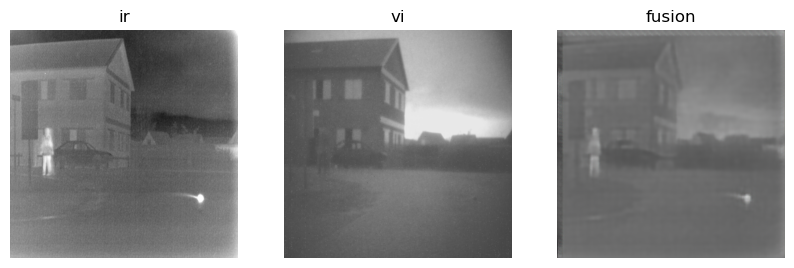

D_epoch_loss:1.2605911493301392,G_epoch_loss:1.157056450843811
Epoch: 4560 D_epoch_loss:1.3523166179656982,G_epoch_loss:1.1077951192855835
Epoch: 4561 D_epoch_loss:1.2637193202972412,G_epoch_loss:1.1264162063598633
Epoch: 4562 D_epoch_loss:1.3530125617980957,G_epoch_loss:1.1227376461029053
Epoch: 4563 D_epoch_loss:1.3256678581237793,G_epoch_loss:1.1173946857452393
Epoch: 4564 D_epoch_loss:1.38130521774292,G_epoch_loss:1.162885308265686
Epoch: 4565 D_epoch_loss:1.349189043045044,G_epoch_loss:1.1371314525604248
Epoch: 4566 D_epoch_loss:1.3883309364318848,G_epoch_loss:1.175186276435852
Epoch: 4567 D_epoch_loss:1.2736358642578125,G_epoch_loss:1.1770163774490356
Epoch: 4568 D_epoch_loss:1.356856346130371,G_epoch_loss:1.1300418376922607
Epoch: 4569 D_epoch_loss:1.3175815343856812,G_epoch_loss:1.1890690326690674
Epoch: 4570 D_epoch_loss:1.3067737817764282,G_epoch_loss:1.1291885375976562
Epoch: 4571 D_epoch_loss:1.2876793146133423,G_epoch_loss:1.1693296432495117
Epoch: 4572 D_epoch_loss:1.2277

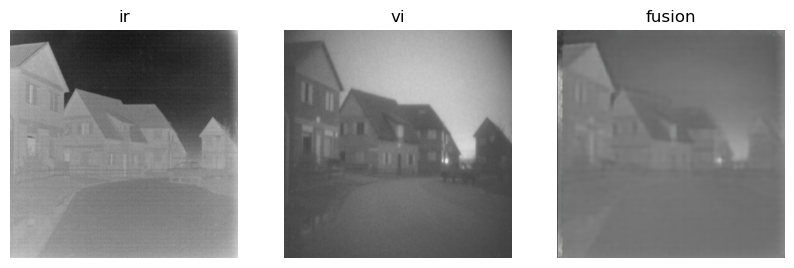

D_epoch_loss:1.2959424257278442,G_epoch_loss:1.1074508428573608
Epoch: 4607 D_epoch_loss:1.2680480480194092,G_epoch_loss:1.1320873498916626
Epoch: 4608 D_epoch_loss:1.3273248672485352,G_epoch_loss:1.1317198276519775
Epoch: 4609 D_epoch_loss:1.3455294370651245,G_epoch_loss:1.0940942764282227
Epoch: 4610 D_epoch_loss:1.323012351989746,G_epoch_loss:1.0636687278747559
Epoch: 4611 D_epoch_loss:1.3146125078201294,G_epoch_loss:1.1082957983016968
Epoch: 4612 D_epoch_loss:1.2943397760391235,G_epoch_loss:1.137945532798767
Epoch: 4613 D_epoch_loss:1.3314216136932373,G_epoch_loss:1.1336052417755127
Epoch: 4614 D_epoch_loss:1.2756458520889282,G_epoch_loss:1.1295320987701416
Epoch: 4615 D_epoch_loss:1.319524884223938,G_epoch_loss:1.1160857677459717
Epoch: 4616 D_epoch_loss:1.264854073524475,G_epoch_loss:1.1166220903396606
Epoch: 4617 D_epoch_loss:1.2915747165679932,G_epoch_loss:1.1274305582046509
Epoch: 4618 D_epoch_loss:1.2694321870803833,G_epoch_loss:1.112108826637268
Epoch: 4619 D_epoch_loss:1.29

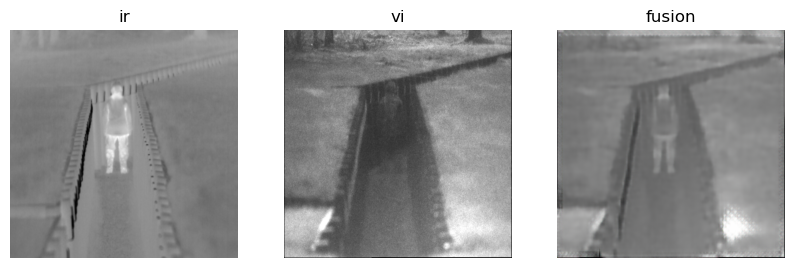

D_epoch_loss:1.311758279800415,G_epoch_loss:1.1831647157669067
Epoch: 4654 D_epoch_loss:1.3247950077056885,G_epoch_loss:1.146738052368164
Epoch: 4655 D_epoch_loss:1.2970322370529175,G_epoch_loss:1.124498724937439
Epoch: 4656 D_epoch_loss:1.2836885452270508,G_epoch_loss:1.1726253032684326
Epoch: 4657 D_epoch_loss:1.3117716312408447,G_epoch_loss:1.129652976989746
Epoch: 4658 D_epoch_loss:1.3495628833770752,G_epoch_loss:1.143771767616272
Epoch: 4659 D_epoch_loss:1.3202415704727173,G_epoch_loss:1.1578041315078735
Epoch: 4660 D_epoch_loss:1.3324087858200073,G_epoch_loss:1.1782164573669434
Epoch: 4661 D_epoch_loss:1.260056972503662,G_epoch_loss:1.1804139614105225
Epoch: 4662 D_epoch_loss:1.3359798192977905,G_epoch_loss:1.1712698936462402
Epoch: 4663 D_epoch_loss:1.2630938291549683,G_epoch_loss:1.174142599105835
Epoch: 4664 D_epoch_loss:1.3435602188110352,G_epoch_loss:1.1107666492462158
Epoch: 4665 D_epoch_loss:1.3644421100616455,G_epoch_loss:1.1262457370758057
Epoch: 4666 D_epoch_loss:1.3110

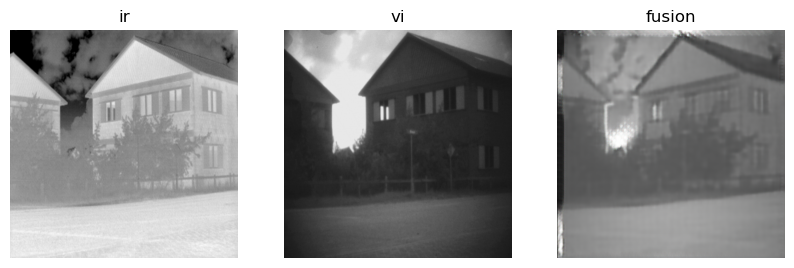

D_epoch_loss:1.263757348060608,G_epoch_loss:1.1376042366027832
Epoch: 4701 D_epoch_loss:1.299247145652771,G_epoch_loss:1.1552067995071411
Epoch: 4702 D_epoch_loss:1.2409991025924683,G_epoch_loss:1.1411666870117188
Epoch: 4703 D_epoch_loss:1.3329373598098755,G_epoch_loss:1.1167900562286377
Epoch: 4704 D_epoch_loss:1.311179280281067,G_epoch_loss:1.1289794445037842
Epoch: 4705 D_epoch_loss:1.340876579284668,G_epoch_loss:1.120666265487671
Epoch: 4706 D_epoch_loss:1.3118619918823242,G_epoch_loss:1.1508160829544067
Epoch: 4707 D_epoch_loss:1.3538563251495361,G_epoch_loss:1.1584280729293823
Epoch: 4708 D_epoch_loss:1.3208484649658203,G_epoch_loss:1.1291062831878662
Epoch: 4709 D_epoch_loss:1.3309197425842285,G_epoch_loss:1.2102911472320557
Epoch: 4710 D_epoch_loss:1.2828538417816162,G_epoch_loss:1.1342601776123047
Epoch: 4711 D_epoch_loss:1.3117390871047974,G_epoch_loss:1.1503486633300781
Epoch: 4712 D_epoch_loss:1.317833423614502,G_epoch_loss:1.1191517114639282
Epoch: 4713 D_epoch_loss:1.285

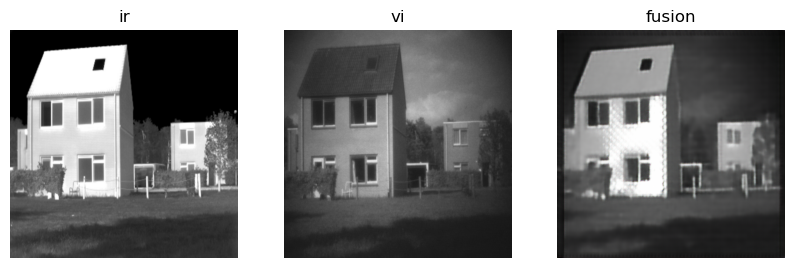

D_epoch_loss:1.3167369365692139,G_epoch_loss:1.1628479957580566
Epoch: 4748 D_epoch_loss:1.3287616968154907,G_epoch_loss:1.1705870628356934
Epoch: 4749 D_epoch_loss:1.2781498432159424,G_epoch_loss:1.1520079374313354
Epoch: 4750 D_epoch_loss:1.279754400253296,G_epoch_loss:1.1334195137023926
Epoch: 4751 D_epoch_loss:1.296884536743164,G_epoch_loss:1.0942928791046143
Epoch: 4752 D_epoch_loss:1.324197769165039,G_epoch_loss:1.1299567222595215
Epoch: 4753 D_epoch_loss:1.2491871118545532,G_epoch_loss:1.1134159564971924
Epoch: 4754 D_epoch_loss:1.3237025737762451,G_epoch_loss:1.1541423797607422
Epoch: 4755 D_epoch_loss:1.310591220855713,G_epoch_loss:1.1799756288528442
Epoch: 4756 D_epoch_loss:1.3293178081512451,G_epoch_loss:1.1357576847076416
Epoch: 4757 D_epoch_loss:1.2847013473510742,G_epoch_loss:1.1067063808441162
Epoch: 4758 D_epoch_loss:1.3667545318603516,G_epoch_loss:1.0702165365219116
Epoch: 4759 D_epoch_loss:1.3162734508514404,G_epoch_loss:1.1288515329360962
Epoch: 4760 D_epoch_loss:1.2

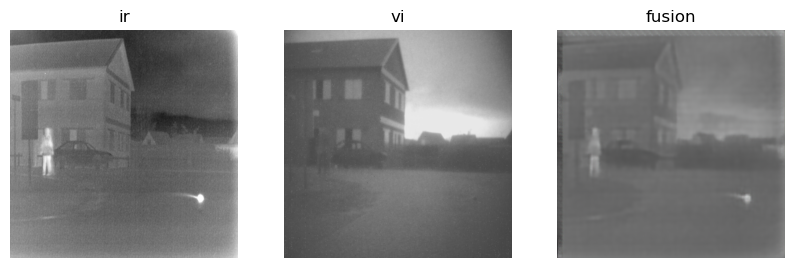

D_epoch_loss:1.2728482484817505,G_epoch_loss:1.1255828142166138
Epoch: 4795 D_epoch_loss:1.3086975812911987,G_epoch_loss:1.103065013885498
Epoch: 4796 D_epoch_loss:1.3346326351165771,G_epoch_loss:1.0889630317687988
Epoch: 4797 D_epoch_loss:1.320936679840088,G_epoch_loss:1.1248869895935059
Epoch: 4798 D_epoch_loss:1.2465565204620361,G_epoch_loss:1.114173173904419
Epoch: 4799 D_epoch_loss:1.3137788772583008,G_epoch_loss:1.099998950958252
Epoch: 4800 D_epoch_loss:1.2757534980773926,G_epoch_loss:1.114601969718933
Epoch: 4801 D_epoch_loss:1.3115513324737549,G_epoch_loss:1.1603819131851196
Epoch: 4802 D_epoch_loss:1.3513569831848145,G_epoch_loss:1.115902066230774
Epoch: 4803 D_epoch_loss:1.2707226276397705,G_epoch_loss:1.1636348962783813
Epoch: 4804 D_epoch_loss:1.3283754587173462,G_epoch_loss:1.1424561738967896
Epoch: 4805 D_epoch_loss:1.2879831790924072,G_epoch_loss:1.1633158922195435
Epoch: 4806 D_epoch_loss:1.3213675022125244,G_epoch_loss:1.146920919418335
Epoch: 4807 D_epoch_loss:1.2999

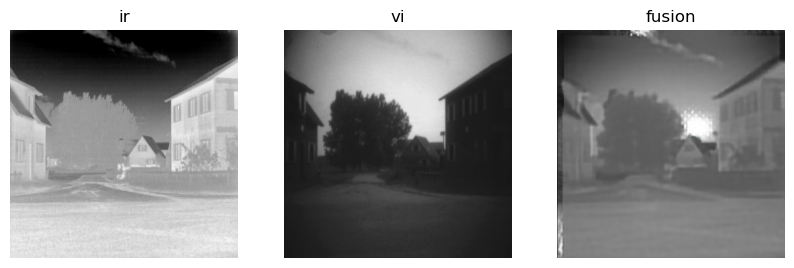

D_epoch_loss:1.2823097705841064,G_epoch_loss:1.0942792892456055
Epoch: 4842 D_epoch_loss:1.3236801624298096,G_epoch_loss:1.1026087999343872
Epoch: 4843 D_epoch_loss:1.2882221937179565,G_epoch_loss:1.113008737564087
Epoch: 4844 D_epoch_loss:1.319115161895752,G_epoch_loss:1.1414072513580322
Epoch: 4845 D_epoch_loss:1.2891929149627686,G_epoch_loss:1.1218479871749878
Epoch: 4846 D_epoch_loss:1.3631041049957275,G_epoch_loss:1.1580559015274048
Epoch: 4847 D_epoch_loss:1.2865231037139893,G_epoch_loss:1.1450889110565186
Epoch: 4848 D_epoch_loss:1.3000669479370117,G_epoch_loss:1.146824598312378
Epoch: 4849 D_epoch_loss:1.3308320045471191,G_epoch_loss:1.1164358854293823
Epoch: 4850 D_epoch_loss:1.343315839767456,G_epoch_loss:1.1614174842834473
Epoch: 4851 D_epoch_loss:1.3193981647491455,G_epoch_loss:1.1018506288528442
Epoch: 4852 D_epoch_loss:1.3288071155548096,G_epoch_loss:1.0906566381454468
Epoch: 4853 D_epoch_loss:1.3088436126708984,G_epoch_loss:1.156423568725586
Epoch: 4854 D_epoch_loss:1.29

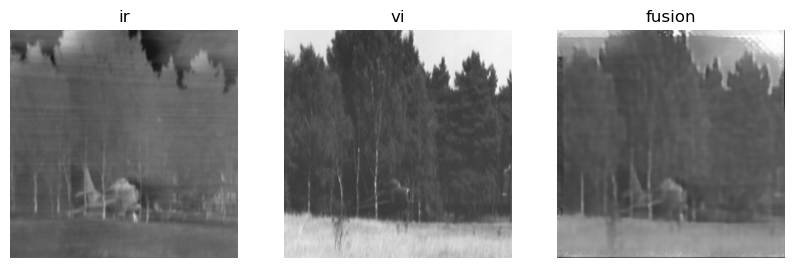

D_epoch_loss:1.333052635192871,G_epoch_loss:1.17171049118042
Epoch: 4889 D_epoch_loss:1.286186933517456,G_epoch_loss:1.1247968673706055
Epoch: 4890 D_epoch_loss:1.2564735412597656,G_epoch_loss:1.1329129934310913
Epoch: 4891 D_epoch_loss:1.3023265600204468,G_epoch_loss:1.1637918949127197
Epoch: 4892 D_epoch_loss:1.3067411184310913,G_epoch_loss:1.1307649612426758
Epoch: 4893 D_epoch_loss:1.3176867961883545,G_epoch_loss:1.153940200805664
Epoch: 4894 D_epoch_loss:1.2251923084259033,G_epoch_loss:1.1183797121047974
Epoch: 4895 D_epoch_loss:1.31587815284729,G_epoch_loss:1.0930310487747192
Epoch: 4896 D_epoch_loss:1.3122854232788086,G_epoch_loss:1.1330753564834595
Epoch: 4897 D_epoch_loss:1.3259248733520508,G_epoch_loss:1.1608065366744995
Epoch: 4898 D_epoch_loss:1.2984580993652344,G_epoch_loss:1.1561312675476074
Epoch: 4899 D_epoch_loss:1.3627818822860718,G_epoch_loss:1.1780811548233032
Epoch: 4900 D_epoch_loss:1.3260241746902466,G_epoch_loss:1.1683785915374756
Epoch: 4901 D_epoch_loss:1.2330

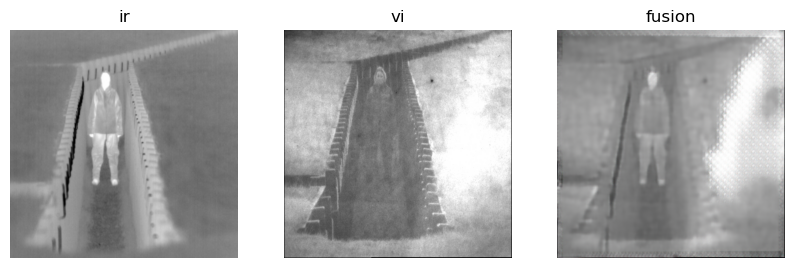

D_epoch_loss:1.3037664890289307,G_epoch_loss:1.1196658611297607
Epoch: 4936 D_epoch_loss:1.343562126159668,G_epoch_loss:1.1155884265899658
Epoch: 4937 D_epoch_loss:1.2871088981628418,G_epoch_loss:1.204237461090088
Epoch: 4938 D_epoch_loss:1.2424449920654297,G_epoch_loss:1.1478215456008911
Epoch: 4939 D_epoch_loss:1.305962324142456,G_epoch_loss:1.1599984169006348
Epoch: 4940 D_epoch_loss:1.264589548110962,G_epoch_loss:1.1287498474121094
Epoch: 4941 D_epoch_loss:1.3057963848114014,G_epoch_loss:1.1315113306045532
Epoch: 4942 D_epoch_loss:1.2962474822998047,G_epoch_loss:1.117828607559204
Epoch: 4943 D_epoch_loss:1.2830936908721924,G_epoch_loss:1.140514612197876
Epoch: 4944 D_epoch_loss:1.2898597717285156,G_epoch_loss:1.121096134185791
Epoch: 4945 D_epoch_loss:1.2892189025878906,G_epoch_loss:1.1547132730484009
Epoch: 4946 D_epoch_loss:1.2996714115142822,G_epoch_loss:1.1886470317840576
Epoch: 4947 D_epoch_loss:1.322826862335205,G_epoch_loss:1.1484706401824951
Epoch: 4948 D_epoch_loss:1.28503

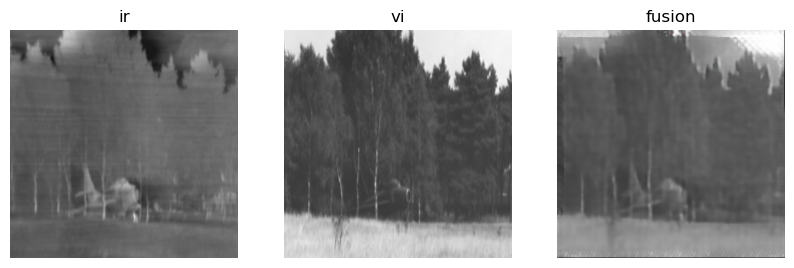

D_epoch_loss:1.2887063026428223,G_epoch_loss:1.1241241693496704
Epoch: 4983 D_epoch_loss:1.2865092754364014,G_epoch_loss:1.1107220649719238
Epoch: 4984 D_epoch_loss:1.3039519786834717,G_epoch_loss:1.1351701021194458
Epoch: 4985 D_epoch_loss:1.3111352920532227,G_epoch_loss:1.1323052644729614
Epoch: 4986 D_epoch_loss:1.3396129608154297,G_epoch_loss:1.1147483587265015
Epoch: 4987 D_epoch_loss:1.285156011581421,G_epoch_loss:1.1675697565078735
Epoch: 4988 D_epoch_loss:1.329377293586731,G_epoch_loss:1.194459319114685
Epoch: 4989 D_epoch_loss:1.2946007251739502,G_epoch_loss:1.1595208644866943
Epoch: 4990 D_epoch_loss:1.351287841796875,G_epoch_loss:1.13996422290802
Epoch: 4991 D_epoch_loss:1.2528800964355469,G_epoch_loss:1.1525564193725586
Epoch: 4992 D_epoch_loss:1.27796471118927,G_epoch_loss:1.1141411066055298
Epoch: 4993 D_epoch_loss:1.3531955480575562,G_epoch_loss:1.1042014360427856
Epoch: 4994 D_epoch_loss:1.2901604175567627,G_epoch_loss:1.0926837921142578
Epoch: 4995 D_epoch_loss:1.27990

In [33]:
# 
D_loss = []
G_loss = []
res = []
for epoch in range(5000):
    D_epoch_loss = 0
    G_epoch_loss = 0
    count = len(train_dl)
    for step,(vi,ir) in enumerate(train_dl):
        ir = ir.to(device)
        vi = vi.to(device)
        d_optimizer.zero_grad()
        #输入真实图片，判别器判定为真
        disc_real_output = dis(ir,vi) #输入真实的成对图片
        d_real_loss = loss_fn(disc_real_output,torch.ones_like(disc_real_output,device = device))
        d_real_loss.backward()
        #输入生成图片，判定为假
        gen_output = gen(vi,ir)
        disc_gen_output = dis(ir,gen_output.detach())#输入生成图像
        d_fake_loss = loss_fn(disc_gen_output,torch.zeros_like(disc_gen_output,device = device))
        d_fake_loss.backward()
        # 判定器的loss由两部分组成
        disc_loss = d_real_loss + d_fake_loss
        #更新判别器参数
        d_optimizer.step()
        
        g_optimizer.zero_grad()
        # 将生成的图片放入判别器
        disc_gen_out = dis(ir,gen_output)
        # 得到生成器的损失
        gen_loss_crossentropyloss = loss_fn(disc_gen_out,
                                           torch.ones_like(disc_gen_out,device = device))
        gen_l1_loss = torch.mean(torch.abs(gen_output - vi*0.5 - ir*0.5))
        gen_loss = gen_loss_crossentropyloss + LAMDA*gen_l1_loss
        gen_loss.backward()
        #更新生成器梯度
        g_optimizer.step()
        with torch.no_grad():
            D_epoch_loss += disc_loss.item()
            G_epoch_loss += gen_loss.item()
    with torch.no_grad():
        D_epoch_loss /=count
        G_epoch_loss /=count
        D_loss.append(D_epoch_loss)
        G_loss.append(G_epoch_loss)
        # 训练完一个epoch就打印输出
        print("Epoch:",epoch,end=' ')
        if epoch%47==0:
            ress = genarate_images(gen,ir,vi)
            res.append(ress)
        print(f'D_epoch_loss:{D_epoch_loss},G_epoch_loss:{G_epoch_loss}')

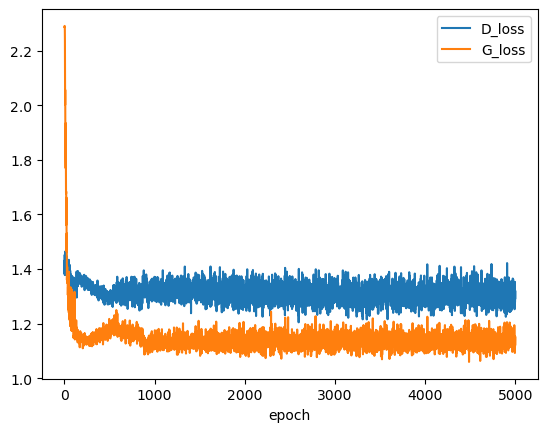

In [34]:
plt.plot(range(1, len(D_loss)+1), D_loss, label='D_loss')
plt.plot(range(1, len(G_loss)+1), G_loss, label='G_loss')
plt.xlabel('epoch')
plt.legend()
plt.show()

In [36]:
import pandas as pd
data = pd.DataFrame()
data['res'] = res
data['Gloss'] = G_loss[len(res)]
data['Dloss'] = D_loss[len(res)]
data.to_excel('excel/03.xlsx')
# 模型参数保存
torch.save(gen.state_dict(), 'w/model_03.pth')